<div class="alert alert-block alert-success">

## 1. Introduction
    
</div>

<div class="alert alert-block alert-info">

### 1.1. An Understanding
    
</div>

Data is regarding a fictional insurance company in Portugal.In the ABT (Analytic Based Table) 
we have data regarding 10.290 Customers. As a Data Mining/Analytic Consultant, you are asked develop 
a Customer Segmentation in such a way that itwill be possible for the Marketing Department to better 
understand all the different Customers’ Profiles. 

<div class="alert alert-block alert-info">

### 1.2. Import the needed libraries
    
</div> 

In [1]:
# Remember: library imports are ALWAYS at the top of the script, no exceptions!
import sqlite3
import os
from collections import Counter
from os.path import join
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
import matplotlib.cm as cm
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.neighbors import KNeighborsClassifier
from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering
from sklearn.base import clone
from sklearn.metrics import pairwise_distances
from scipy.cluster.hierarchy import dendrogram
from sklearn.manifold import TSNE
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
import sompy
from sompy.visualization.mapview import View2D
from sompy.visualization.bmuhits import BmuHitsView
from sompy.visualization.hitmap import HitMapView
import graphviz

sns.set()


# for better resolution plots
%config InlineBackend.figure_format = 'retina' # optionally, you can change 'svg' to 'retina'

# Seeting seaborn style
sns.set()

%matplotlib inline

Loaded backend module://matplotlib_inline.backend_inline version unknown.


<div class="alert alert-block alert-info">

### 1.3. Import the data
    
</div> 

In [2]:
# 2. Import data
df = pd.read_sas('a2z_insurance.sas7bdat')
df.head()

,CustID,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
0,1.0,1985.0,1982.0,b'2 - High School',2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89
1,2.0,1981.0,1995.0,b'2 - High School',677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
2,3.0,1991.0,1970.0,b'1 - Basic',2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
3,4.0,1990.0,1981.0,b'3 - BSc/MSc',1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
4,5.0,1986.0,1973.0,b'3 - BSc/MSc',1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45


<div class="alert alert-block alert-success">

## 2. Data Preparation
    
</div>

<div class="alert alert-block alert-info">

### 2.1. Explore the data
    
</div> 

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10296 entries, 0 to 10295
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   CustID         10296 non-null  float64
 1   FirstPolYear   10266 non-null  float64
 2   BirthYear      10279 non-null  float64
 3   EducDeg        10279 non-null  object 
 4   MonthSal       10260 non-null  float64
 5   GeoLivArea     10295 non-null  float64
 6   Children       10275 non-null  float64
 7   CustMonVal     10296 non-null  float64
 8   ClaimsRate     10296 non-null  float64
 9   PremMotor      10262 non-null  float64
 10  PremHousehold  10296 non-null  float64
 11  PremHealth     10253 non-null  float64
 12  PremLife       10192 non-null  float64
 13  PremWork       10210 non-null  float64
dtypes: float64(13), object(1)
memory usage: 1.1+ MB


In [4]:
# duplicated observations
df.duplicated().sum()

0

In [5]:
# descriptive statistics
df.describe(include="all").T  

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
CustID,10296.0,NaN,NaN,NaN,5148.5,2972.34352,1.0,2574.75,5148.5,7722.25,10296.0
FirstPolYear,10266.0,NaN,NaN,NaN,1991.062634,511.267913,1974.0,1980.0,1986.0,1992.0,53784.0
BirthYear,10279.0,NaN,NaN,NaN,1968.007783,19.709476,1028.0,1953.0,1968.0,1983.0,2001.0
EducDeg,10279,4,b'3 - BSc/MSc',4799,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MonthSal,10260.0,NaN,NaN,NaN,2506.667057,1157.449634,333.0,1706.0,2501.5,3290.25,55215.0
GeoLivArea,10295.0,NaN,NaN,NaN,2.709859,1.266291,1.0,1.0,3.0,4.0,4.0
Children,10275.0,NaN,NaN,NaN,0.706764,0.455268,0.0,0.0,1.0,1.0,1.0
CustMonVal,10296.0,NaN,NaN,NaN,177.892605,1945.811505,-165680.42,-9.44,186.87,399.7775,11875.89
ClaimsRate,10296.0,NaN,NaN,NaN,0.742772,2.916964,0.0,0.39,0.72,0.98,256.2
PremMotor,10262.0,NaN,NaN,NaN,300.470252,211.914997,-4.11,190.59,298.61,408.3,11604.42


<div class="alert alert-block alert-info">

### 2.2. Coherence check
    
</div> 

Checking if there is data discrepancy, like FirstPolYear is less than BirthYear.

In [6]:
df[df["FirstPolYear"] < df["BirthYear"]]

,CustID,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
1,2.0,1981.0,1995.0,b'2 - High School',677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
13,14.0,1983.0,2000.0,b'1 - Basic',1043.0,3.0,1.0,-75.12,1.06,44.34,342.85,127.69,267.94,94.46
18,19.0,1981.0,1982.0,b'1 - Basic',1414.0,3.0,1.0,230.38,0.71,313.17,373.40,121.80,14.78,72.57
22,23.0,1976.0,1986.0,b'2 - High School',1495.0,1.0,1.0,-89.79,1.08,209.04,308.95,192.48,64.79,54.90
40,41.0,1994.0,1995.0,b'2 - High School',1177.0,4.0,1.0,121.36,0.84,52.01,455.65,135.47,146.36,148.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10268,10269.0,1987.0,1988.0,b'3 - BSc/MSc',1414.0,3.0,1.0,50.46,0.90,129.58,167.80,184.48,165.92,75.46
10273,10274.0,1989.0,1992.0,b'2 - High School',1035.0,1.0,1.0,293.51,0.58,235.71,195.60,103.13,170.92,58.12
10284,10285.0,1980.0,1987.0,b'3 - BSc/MSc',1504.0,4.0,1.0,-1.55,0.96,390.63,29.45,179.70,-6.00,NaN
10288,10289.0,1982.0,1993.0,b'2 - High School',1465.0,1.0,1.0,795.15,0.35,67.79,820.15,102.13,182.48,86.46


In [7]:
len(df[df["FirstPolYear"] < df["BirthYear"]])/ len(df) *100

19.395881895881896

<div class="alert alert-block alert-info">

### 2.3. Define metric and non-metric features.
    
</div> 

In [8]:
non_metric_features = ["EducDeg", "GeoLivArea", "Children"]
metric_features = df.columns.drop(non_metric_features).drop("CustID").to_list()

<div class="alert alert-block alert-info">

### 2.4. Modify the data
    
</div> 

Making copy of our original data

In [9]:
df_original = df.copy()

In [10]:
df.isna().sum()

CustID             0
FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

Filling the missing value of Premiums parts by 0

In [11]:
dfm = df.copy()

In [12]:
dfm.iloc[:,-5:]=dfm.iloc[:,-5:].fillna(0)

Filling the missing value of Monthly salary by the median number

In [13]:
dfm['MonthSal'] = dfm['MonthSal'].fillna(dfm['MonthSal'].median())

Filling in the missing values of 'FirstPolYear' and 'BirthYear', 
by KNNImputer 

In [14]:
# KNNImputer - only works for numerical varaibles
imputer = KNNImputer(n_neighbors=5, weights='uniform')
dfm[metric_features] = imputer.fit_transform(dfm[metric_features])

Filling the missing value in the non_metric_features colunms by most common value

In [15]:
modes = dfm[non_metric_features].mode().loc[0]
dfm.fillna(modes, inplace=True)

In [16]:
dfm.isna().sum()

CustID           0
FirstPolYear     0
BirthYear        0
EducDeg          0
MonthSal         0
GeoLivArea       0
Children         0
CustMonVal       0
ClaimsRate       0
PremMotor        0
PremHousehold    0
PremHealth       0
PremLife         0
PremWork         0
dtype: int64

<div class="alert alert-block alert-info">

### 2.5. Feature Engineering
    
</div> 

Changing the columns 'FirstPolYear' and 'BirthYear' to 'member_age' and 'age' and transfer the value to be numerical

In [17]:
dfm['FirstPolYear']=2016-dfm['FirstPolYear']
dfm['BirthYear']=2016-dfm['BirthYear']

In [18]:
dfm = dfm.rename(columns={'FirstPolYear':'member_age','BirthYear':'age'})

In [19]:
dfm=dfm.drop(columns='CustID')

In [20]:
df=dfm.copy()

Updating metric and non-metric features

In [21]:
non_metric_features = ["EducDeg", "GeoLivArea", "Children"]
metric_features = dfm.columns.drop(non_metric_features).to_list()

 <div class="alert alert-block alert-info">

### 2.6. Outliers Removal
    
</div>

In [22]:
df_full=df.copy()
dfor=df.copy()

In [23]:
ql = dfor['member_age'].quantile(.25)
qh = dfor['member_age'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 2 * iqr
lower_lim = ql - 2 * iqr
filters_member_age= []
filters_member_age.append(dfor['member_age'].between(lower_lim, upper_lim, inclusive=True))
filters_member_age = pd.Series(np.all(filters_member_age, 0))
print('number of outliers from member_age :',filters_member_age.value_counts().min())

number of outliers from member_age : 1


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/2106680787.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_member_age.append(dfor['member_age'].between(lower_lim, upper_lim, inclusive=True))


In [24]:
ql = dfor['age'].quantile(.25)
qh = dfor['age'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 2 * iqr
lower_lim = ql - 2 * iqr
filters_age= []
filters_age.append(dfor['age'].between(lower_lim, upper_lim, inclusive=True))
filters_age = pd.Series(np.all(filters_age, 0))
print('number of outliers from age :',filters_age.value_counts().min())

number of outliers from age : 1


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/1574835348.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_age.append(dfor['age'].between(lower_lim, upper_lim, inclusive=True))


In [25]:
ql = dfor['MonthSal'].quantile(.25)
qh = dfor['MonthSal'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 2 * iqr
lower_lim = ql - 2 * iqr
filters_MonthSal= []
filters_MonthSal.append(dfor['MonthSal'].between(lower_lim, upper_lim, inclusive=True))
filters_MonthSal = pd.Series(np.all(filters_MonthSal, 0))
print('number of outliers from MonthSal :',filters_MonthSal.value_counts().min())

number of outliers from MonthSal : 2


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/4286083226.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_MonthSal.append(dfor['MonthSal'].between(lower_lim, upper_lim, inclusive=True))


In [26]:
ql = dfor['CustMonVal'].quantile(.25)
qh = dfor['CustMonVal'].quantile(.75)
iqr = (qh - ql)

upper_lim = qh + 7 * iqr
lower_lim = ql - 7 * iqr
filters_CustMonVal = []
filters_CustMonVal.append(dfor['CustMonVal'].between(lower_lim, upper_lim, inclusive=True))
filters_CustMonVal = pd.Series(np.all(filters_CustMonVal, 0))
print('number of outliers from CustMonVal :',filters_CustMonVal.value_counts().min())

number of outliers from CustMonVal : 15


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/1089876727.py:8: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_CustMonVal.append(dfor['CustMonVal'].between(lower_lim, upper_lim, inclusive=True))


In [27]:
ql = dfor['ClaimsRate'].quantile(.25)
qh = dfor['ClaimsRate'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 5 * iqr
lower_lim = ql - 5 * iqr
filters_ClaimsRate= []
filters_ClaimsRate.append(dfor['ClaimsRate'].between(lower_lim, upper_lim, inclusive=True))
filters_ClaimsRate = pd.Series(np.all(filters_ClaimsRate, 0))
print('number of outliers from ClaimsRate :',filters_ClaimsRate.value_counts().min())

number of outliers from ClaimsRate : 15


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/3653757074.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_ClaimsRate.append(dfor['ClaimsRate'].between(lower_lim, upper_lim, inclusive=True))


In [28]:
ql = dfor['PremMotor'].quantile(.25)
qh = dfor['PremMotor'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 2 * iqr
lower_lim = ql - 2 * iqr
filters_PremMotor= []
filters_PremMotor.append(dfor['PremMotor'].between(lower_lim, upper_lim, inclusive=True))
filters_PremMotor = pd.Series(np.all(filters_PremMotor, 0))
print('number of outliers from PremMotor :',filters_PremMotor.value_counts().min())

number of outliers from PremMotor : 6


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/1020807844.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_PremMotor.append(dfor['PremMotor'].between(lower_lim, upper_lim, inclusive=True))


In [29]:
ql = dfor['PremHousehold'].quantile(.25)
qh = dfor['PremHousehold'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 7 * iqr
lower_lim = ql - 7 * iqr
filters_PremHousehold= []
filters_PremHousehold.append(dfor['PremHousehold'].between(lower_lim, upper_lim, inclusive=True))
filters_PremHousehold = pd.Series(np.all(filters_PremHousehold, 0))
print('number of outliers from PremHousehold :',filters_PremHousehold.value_counts().min())

number of outliers from PremHousehold : 4


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/4189230665.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_PremHousehold.append(dfor['PremHousehold'].between(lower_lim, upper_lim, inclusive=True))


In [30]:
ql = dfor['PremHealth'].quantile(.25)
qh = dfor['PremHealth'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 2 * iqr
lower_lim = ql - 2 * iqr
filters_PremHealth= []
filters_PremHealth.append(dfor['PremHealth'].between(lower_lim, upper_lim, inclusive=True))
filters_PremHealth = pd.Series(np.all(filters_PremHealth, 0))
print('number of outliers from PremHealth :',filters_PremHealth.value_counts().min())

number of outliers from PremHealth : 6


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/211921959.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_PremHealth.append(dfor['PremHealth'].between(lower_lim, upper_lim, inclusive=True))


In [31]:
ql = dfor['PremLife'].quantile(.25)
qh = dfor['PremLife'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 6 * iqr
lower_lim = ql - 6 * iqr
filters_PremLife= []
filters_PremLife.append(dfor['PremLife'].between(lower_lim, upper_lim, inclusive=True))
filters_PremLife = pd.Series(np.all(filters_PremLife, 0))
print('number of outliers from PremLife :',filters_PremLife.value_counts().min())

number of outliers from PremLife : 6


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/348045519.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_PremLife.append(dfor['PremLife'].between(lower_lim, upper_lim, inclusive=True))


In [32]:
ql = dfor['PremWork'].quantile(.25)
qh = dfor['PremWork'].quantile(.75)
iqr = (qh - ql)
upper_lim = qh + 7 * iqr
lower_lim = ql - 7 * iqr
filters_PremWork= []
filters_PremWork.append(dfor['PremWork'].between(lower_lim, upper_lim, inclusive=True))
filters_PremWork = pd.Series(np.all(filters_PremWork, 0))
print('number of outliers from PremWork :',filters_PremWork.value_counts().min())

number of outliers from PremWork : 5


C:\Users\bayaz\AppData\Local\Temp/ipykernel_14512/1887034683.py:7: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  filters_PremWork.append(dfor['PremWork'].between(lower_lim, upper_lim, inclusive=True))


In [33]:
dfor=dfor[filters_member_age 
           & filters_age
           & filters_MonthSal 
           & filters_CustMonVal
           & filters_ClaimsRate
           & filters_PremMotor
           & filters_PremHousehold
           & filters_PremHealth
           & filters_PremLife
           & filters_PremWork]
print('number of data removed after outliers:',
      df_original.shape[0]-dfor.shape[0])

number of data removed after outliers: 43


In [34]:
print('Percentage of data removed after outliers:',
      np.round(1 -  np.round(dfor.shape[0] / df_original.shape[0], 5), 5)*100, "%")

Percentage of data removed after outliers: 0.418 %


Isolation Forest\
The Isolation Forest Outlier removal explicitly identifies anomalies instead of profiling normal data points. Isolation Forest, like any tree ensemble method (from the sklearn library), is built on the basis of decision trees.

In these trees, partitions are created by first randomly selecting a feature and then selecting a random split value between the minimum and maximum value of the feature. The parameters used for this method were IsolationForest (contamination=0.01), representing the amount of contamination of the dataset, i.e. the proportion of outliers in the data set. It is used when fitting to define the threshold on the scores of the samples.

In [35]:
# We chose 0.005% contamination, because 0.01% would remove 1.5% of outliers, too much
iso = IsolationForest(contamination=0.005)
iso_df = iso.fit_predict(dfor[metric_features])

In [36]:
mask_out =iso_df == -1
outliers_if=dfor[mask_out]
dfor.drop(outliers_if.index,inplace=True)

In [37]:
print('Percentage of data removed after outliers:',
      np.round(1 -  np.round(dfor.shape[0] / df_original.shape[0], 5), 5)*100, "%")

Percentage of data removed after outliers: 0.923 %


In [38]:
df=dfor.copy()

<div class="alert alert-block alert-info">

### 2.7. Visual Exploration 
    
</div> 

title position was updated manually, not adjusting
findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=11.0.
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'STIXGeneral' (STIXGeneralBolIta.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXNonUnicode' (STIXNonUniIta.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmr10' (cmr10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Italic.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmex10' (cmex10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans.ttf) normal normal 400 normal>) = 2.05
findfont: score(<Font 'STIXSizeOneSym' (STIXSizOneSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Displa

findfont: score(<Font 'Arial Rounded MT Bold' (ARLRDBD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Mongolian Baiti' (monbaiti.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Copperplate Gothic Light' (COPRGTL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (SitkaI.ttc) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bodoni MT' (BOD_BI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Agency FB' (AGENCYR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Bold ITC' (ERASBD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Demi ITC' (ERASDEMI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gloucester MT Extra Condensed' (GLECB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Guttman Logo1' (LOGO1.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Cambria' (cambriai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 

findfont: score(<Font 'Times New Roman' (timesbd.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Guttman-Aram' (ARAM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Trebuchet MS' (trebuc.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe UI' (seguisbi.ttf) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Californian FB' (CALIFR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Castellar' (CASTELAR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'OCR A Extended' (OCRAEXT.TTF) normal normal 400 expanded>) = 10.25
findfont: score(<Font 'Brush Script MT' (BRUSHSCI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Lucida Bright' (LBRITEDI.TTF) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Palace Script MT' (PALSCRI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Microsoft Uighur' (MSUIGHUB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Franklin Gothic

findfont: score(<Font 'Century Schoolbook' (SCHLBKI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Monotype Corsiva' (MTCORSVA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Constantia' (constan.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibrib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Corbel' (corbelb.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Gill Sans Ultra Bold Condensed' (GILLUBCD.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Gadugi' (gadugi.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calisto MT' (CALIST.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Perpetua Titling MT' (PERTIBD.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Calisto MT' (CALISTB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Berlin Sans FB' (BRLNSR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gill Sans 

findfont: score(<Font 'Tw Cen MT Condensed' (TCCB____.TTF) normal normal 700 condensed>) = 10.535
findfont: score(<Font 'Segoe UI Emoji' (seguiemj.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Verdana' (verdanai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Goudy Old Style' (GOUDOS.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Garamond' (GARA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (Sitka.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Hadassah Friedlaender' (HADASAHB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Segoe UI' (seguisb.ttf) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Lucida Sans Typewriter' (LTYPEB.TTF) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Cambria' (cambria.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Century Gothic' (GOTHICB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Eras Medium IT

findfont: score(<Font 'Century' (CENTURY.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Leelawadee UI' (LeelUIsl.ttf) normal normal 350 normal>) = 10.0975
findfont: score(<Font 'Chiller' (CHILLER.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibri.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Microsoft YaHei' (msyh.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Comic Sans MS' (comici.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bell MT' (BELLB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Goudy Old Style' (GOUDOSB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Segoe UI' (segoeuib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Bauhaus 93' (BAUHS93.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Georgia' (georgiai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Gill Sans MT Ext Condensed Bold' (GLSNECB.TTF) norma

findfont: score(<Font 'Pristina' (PRISTINA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Corbel' (corbelli.ttf) italic normal 300 normal>) = 11.145
findfont: score(<Font 'Nirmala UI' (NirmalaS.ttf) normal normal 350 normal>) = 10.0975
findfont: score(<Font 'Tw Cen MT Condensed Extra Bold' (TCCEB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Guttman Hatzvi' (TZVIM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Arial' (ARIALN.TTF) normal normal 400 condensed>) = 0.25
findfont: score(<Font 'MS Gothic' (msgothic.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Magneto' (MAGNETOB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Bookman Old Style' (BOOKOSI.TTF) italic normal 300 normal>) = 11.145
findfont: score(<Font 'Onyx' (ONYX.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Tempus Sans ITC' (TEMPSITC.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'High Tower Text' (HTOWERTI.TTF

findfont: score(<Font 'Century Schoolbook' (SCHLBKBI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Gill Sans MT' (GILI____.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Perpetua Titling MT' (PERTILI.TTF) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Garamond' (GARAIT.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Wingdings 2' (WINGDNG2.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Franklin Gothic Medium' (framd.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Niagara Solid' (NIAGSOL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Lucida Sans Unicode' (l_10646.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Garamond' (GARABD.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Georgia' (georgiab.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Microsoft YaHei' (msyhl.ttc) normal normal 290 normal>) = 10.1545
findfont: score(<Font 'Tw Cen 

findfont: score(<Font 'Bookman Old Style' (BOOKOSB.TTF) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Microsoft JhengHei' (msjh.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Parchment' (PARCHM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Book Antiqua' (ANTQUABI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Trebuchet MS' (trebucbd.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Corbel' (corbell.ttf) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Arial' (arialbd.ttf) normal normal 700 normal>) = 0.33499999999999996
findfont: score(<Font 'Segoe UI' (seguili.ttf) italic normal 300 normal>) = 11.145
findfont: score(<Font 'Guttman Yad' (GYADL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Agency FB' (AGENCYB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Constantia' (constani.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Rockwell' (ROCK.TTF) normal no

findfont: score(<Font 'STIXNonUnicode' (STIXNonUniBolIta.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXSizeOneSym' (STIXSizOneSymReg.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif Display' (DejaVuSerifDisplay.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans Mono' (DejaVuSansMono-Bold.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'STIXSizeFiveSym' (STIXSizFiveSymReg.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXGeneral' (STIXGeneral.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans-BoldOblique.ttf) oblique normal 700 normal>) = 3.335
findfont: score(<Font 'cmtt10' (cmtt10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-BoldItalic.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'DejaVu Sans' (

findfont: score(<Font 'Franklin Gothic Demi' (FRADMIT.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Sitka Small' (SitkaZ.ttc) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Segoe UI' (seguibl.ttf) normal normal 900 normal>) = 10.525
findfont: score(<Font 'Broadway' (BROADW.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Californian FB' (CALIFI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bahnschrift' (bahnschrift.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Guttman Frank' (FRANKB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Courier New' (courbi.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Maiandra GD' (MAIAN.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Impact' (impact.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calisto MT' (CALISTBI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Centaur' (CENTAUR.TTF) normal normal 4

findfont: score(<Font 'Playbill' (PLAYBILL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Hadassah Friedlaender' (HADASAH.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Yu Gothic' (YuGothL.ttc) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Segoe Print' (segoepr.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Rockwell Condensed' (ROCCB___.TTF) normal normal 700 condensed>) = 10.535
findfont: score(<Font 'MingLiU-ExtB' (mingliub.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Lucida Bright' (LBRITED.TTF) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Forte' (FORTE.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Bookman Old Style' (BOOKOSBI.TTF) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Matura MT Script Capitals' (MATURASC.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Candara' (Candara.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe UI'

findfont: score(<Font 'Candara' (Candarali.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Tahoma' (tahomabd.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Perpetua' (PERI____.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Gadugi' (gadugib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'High Tower Text' (HTOWERT.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Malgun Gothic' (malgunbd.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Stencil' (STENCIL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Guttman-CourMir' (MIRFX.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Guttman Yad-Brush' (GYADBR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Dubai' (DUBAI-LIGHT.TTF) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Ebrima' (ebrimabd.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Century Gothic' (GOTHIC.TTF) normal normal 400

findfont: score(<Font 'Segoe MDL2 Assets' (segmdl2.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'MV Boli' (mvboli.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Bodoni MT' (BOD_CB.TTF) normal normal 700 condensed>) = 10.535
findfont: score(<Font 'SimSun' (simsun.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Rage Italic' (RAGE.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Ink Free' (Inkfree.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Haettenschweiler' (HATTEN.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Guttman Miryam' (MIRL.TTF) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Lucida Bright' (LBRITE.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Yu Gothic' (YuGothR.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Marlett' (marlett.ttf) normal normal 500 normal>) = 10.145
findfont: score(<Font 'Microsoft JhengHei' (msjhbd.ttc) normal normal 700 

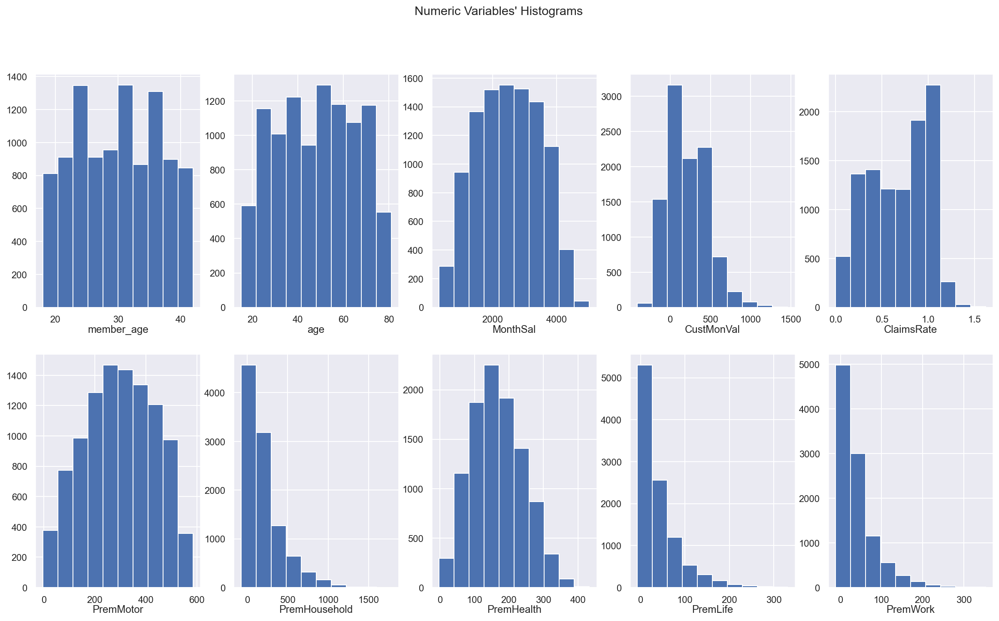

In [39]:
# All Numeric Variables' Histograms in one figure
sns.set()

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    ax.hist(df[feat])
    ax.set_title(feat, y=-0.13)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title)

plt.show()

Text(0.5, 0.98, "Numeric Variables' Box Plots")

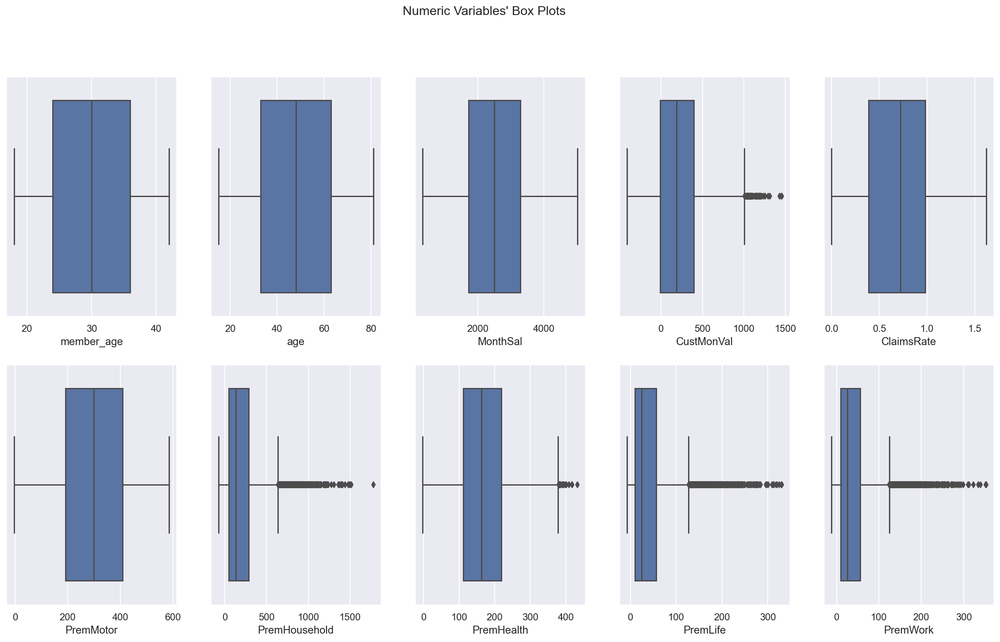

In [40]:
# All Numeric Variables' Box Plots in one figure
sns.set()

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=df[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


findfont: score(<Font 'STIXSizeOneSym' (STIXSizOneSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Display' (DejaVuSansDisplay.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXNonUnicode' (STIXNonUniBolIta.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXSizeOneSym' (STIXSizOneSymReg.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif Display' (DejaVuSerifDisplay.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans Mono' (DejaVuSansMono-Bold.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'STIXSizeFiveSym' (STIXSizFiveSymReg.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'STIXGeneral' (STIXGeneral.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans-BoldOblique.ttf) oblique normal 700 normal>) = 3.335
findfont: score(<

findfont: score(<Font 'Cambria' (cambriai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Century Gothic' (GOTHICBI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Franklin Gothic Demi' (FRADMIT.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Sitka Small' (SitkaZ.ttc) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Segoe UI' (seguibl.ttf) normal normal 900 normal>) = 10.525
findfont: score(<Font 'Broadway' (BROADW.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Californian FB' (CALIFI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bahnschrift' (bahnschrift.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Guttman Frank' (FRANKB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Courier New' (courbi.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Maiandra GD' (MAIAN.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Impact' (impact.ttf) normal nor

findfont: score(<Font 'Franklin Gothic Medium Cond' (FRAMDCN.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Playbill' (PLAYBILL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Hadassah Friedlaender' (HADASAH.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Yu Gothic' (YuGothL.ttc) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Segoe Print' (segoepr.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Rockwell Condensed' (ROCCB___.TTF) normal normal 700 condensed>) = 10.535
findfont: score(<Font 'MingLiU-ExtB' (mingliub.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Lucida Bright' (LBRITED.TTF) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Forte' (FORTE.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Bookman Old Style' (BOOKOSBI.TTF) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Matura MT Script Capitals' (MATURASC.TTF) normal normal 400 normal>) = 10.05
findfont:

findfont: score(<Font 'Gill Sans MT Condensed' (GILC____.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Candara' (Candarali.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Tahoma' (tahomabd.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Perpetua' (PERI____.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Gadugi' (gadugib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'High Tower Text' (HTOWERT.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Malgun Gothic' (malgunbd.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Stencil' (STENCIL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Guttman-CourMir' (MIRFX.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Guttman Yad-Brush' (GYADBR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Dubai' (DUBAI-LIGHT.TTF) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Ebrima' (ebrimabd.ttf) norma

findfont: score(<Font 'Eras Medium ITC' (ERASMD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe MDL2 Assets' (segmdl2.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'MV Boli' (mvboli.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Bodoni MT' (BOD_CB.TTF) normal normal 700 condensed>) = 10.535
findfont: score(<Font 'SimSun' (simsun.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Rage Italic' (RAGE.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Ink Free' (Inkfree.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Haettenschweiler' (HATTEN.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Guttman Miryam' (MIRL.TTF) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Lucida Bright' (LBRITE.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Yu Gothic' (YuGothR.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Marlett' (marlett.ttf) normal normal 500 norm

top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


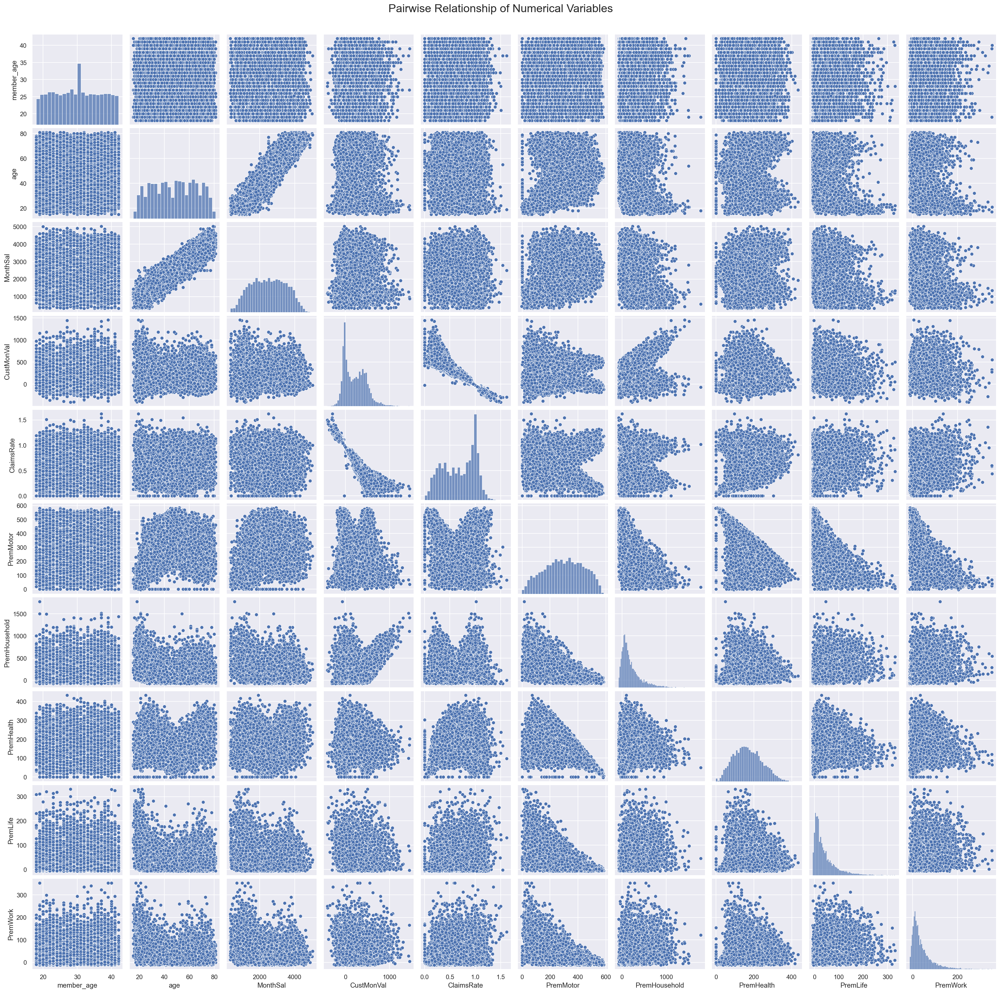

In [41]:
# Why don't we build Pairwise Relationship of Numerical Variables?

sns.set()

# Setting pairplot
sns.pairplot(df[metric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

C:\Users\bayaz\anaconda3\envs\dmdsaa1\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\bayaz\anaconda3\envs\dmdsaa1\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\bayaz\anaconda3\envs\dmdsaa1\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warning

Text(0.5, 0.98, "Categorical/Low Cardinality Variables' Absolute Frequencies")

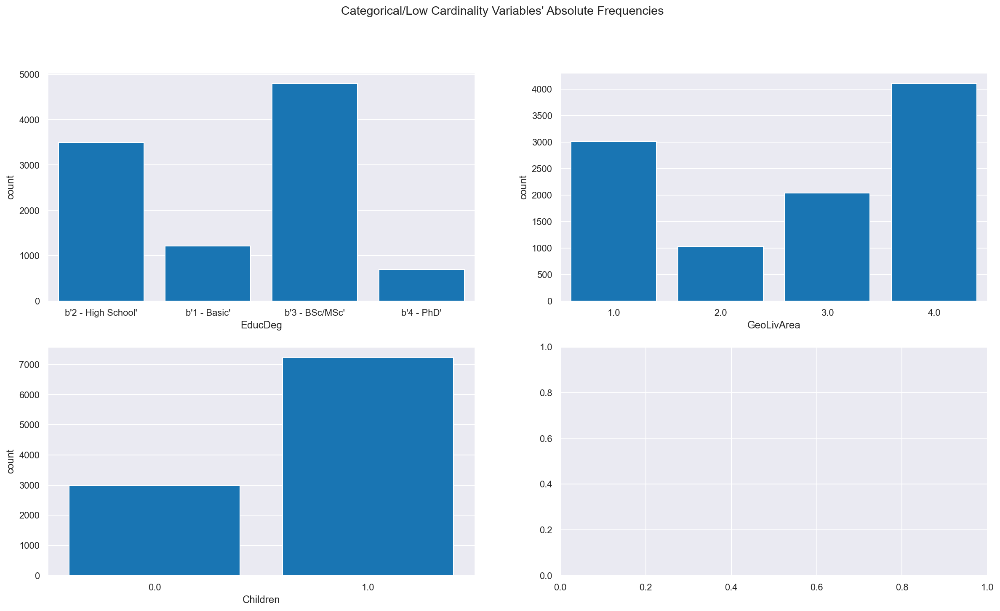

In [42]:
# All Non-Metric Variables' Absolute Frequencies
sns.set()

# Prepare figure. Create individual axes where each bar plot will be placed
fig, axes = plt.subplots(2, ceil(len(non_metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each bar plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), non_metric_features): # Notice the zip() function and flatten() method
    sns.countplot(df[feat].astype(object), ax=ax, color='#007acc')

title = "Categorical/Low Cardinality Variables' Absolute Frequencies"
plt.suptitle(title)

top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


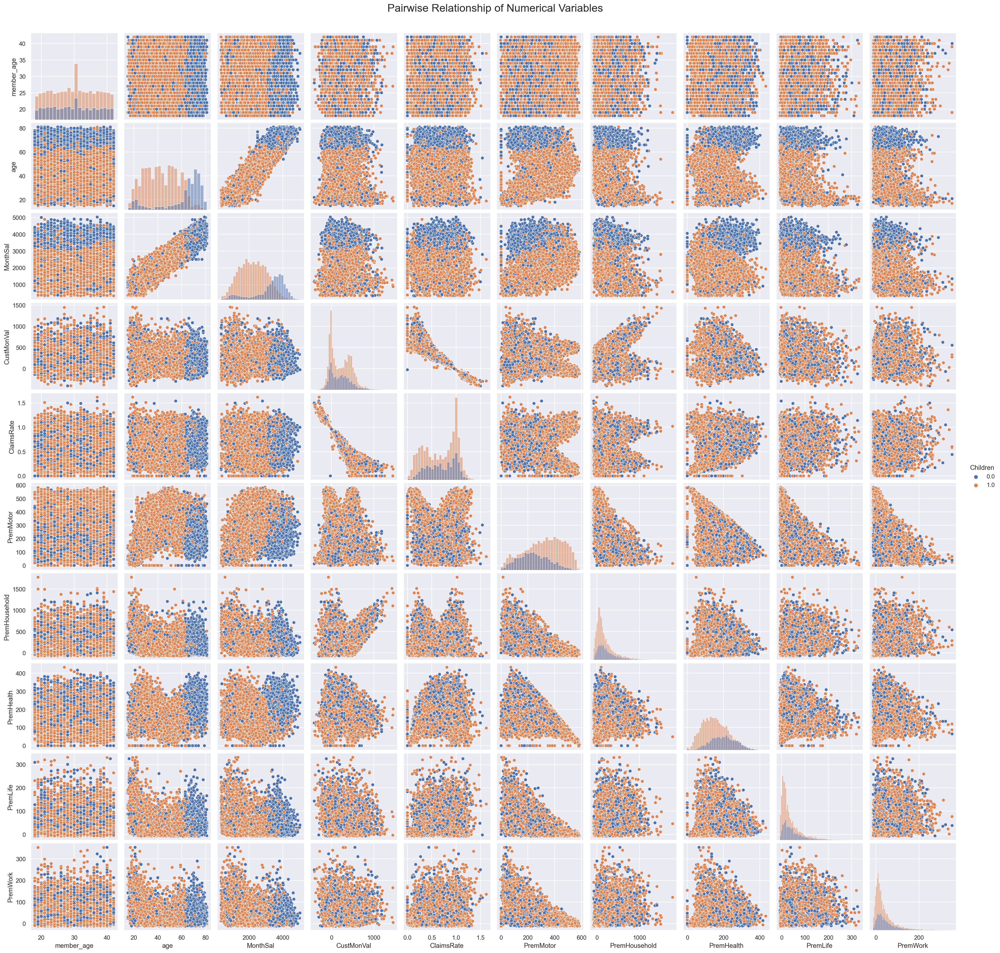

In [43]:
# Comparing a categorical variable vs continuous (or discrete) variables
# Pairwise Relationship of Numerical Variables using a categorical variable hue

# I have tried to build metric features vs Children, just to see if it makes sense

sns.set()

# Setting pairplot
sns.pairplot(df[metric_features + ['Children']], diag_kind="hist", hue='Children')

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

<div class="alert alert-block alert-info">

### 2.8. Variable selection
    
</div> 

Metric Variables' Correlation Matrix

locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x0000022CC0ABCBB0>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x0000022CC0ABCBB0> on colorbar
Setting pcolormesh
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


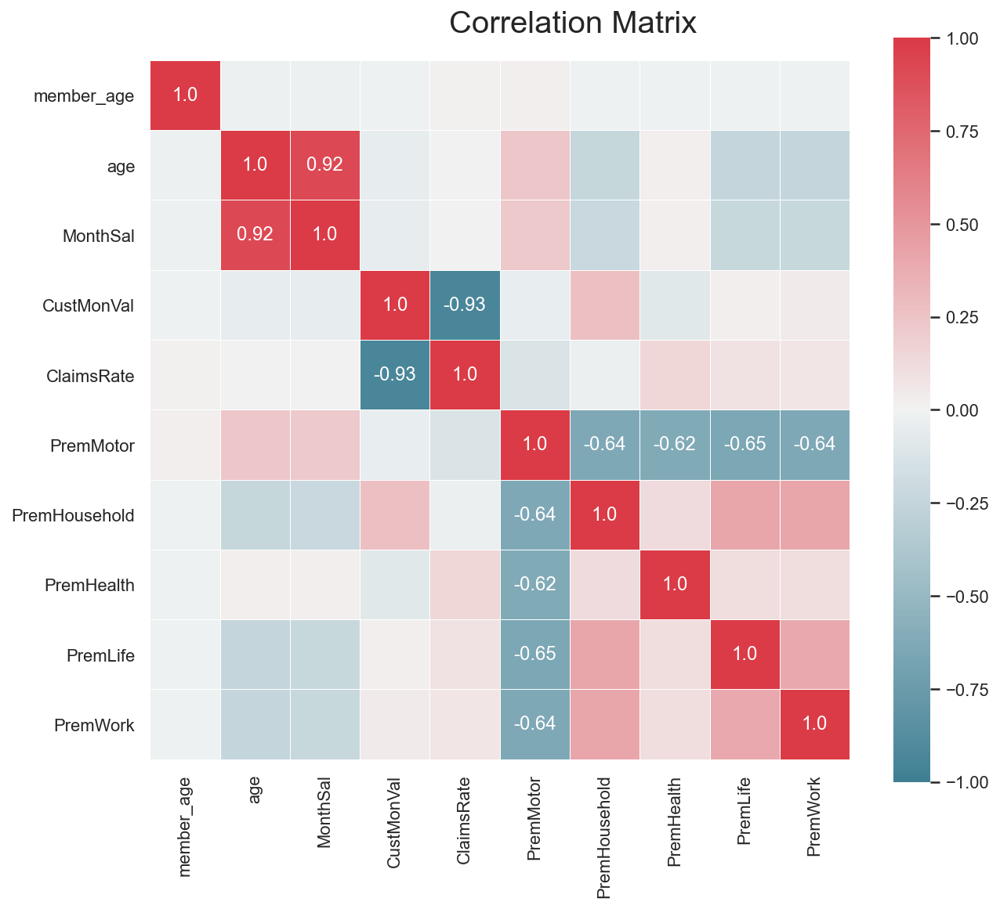

In [44]:
# Prepare figure
fig = plt.figure(figsize=(10, 8))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(df[metric_features].corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [45]:
# Select variables according to their correlations
df.drop(columns=['age', 'ClaimsRate'], inplace=True)
df_full.drop(columns=['age', 'ClaimsRate'], inplace=True)

In [46]:
# update metric and non-metric features. 
non_metric_features = ["EducDeg", "GeoLivArea", "Children"]
metric_features = df.columns.drop(non_metric_features).to_list()

<div class="alert alert-block alert-info">

### 2.9. Data Normalization
    
</div>

Empirically, after standard normalization, the accuracy of the classifier can be greatly improved by making the features between different dimensions numerically comparable, and the magnitude of the resulting parameter values can reflect the contribution of different features to the sample label.

In [47]:
df_standard = df.copy()

# This df_standard_full is for final cluster prediction with outliers
df_standard_full=df_full.copy()

In [48]:
# Use StandardScaler to scale the data
# We don't use MinMax because we have big range values
scaler = StandardScaler().fit(df_standard[metric_features])
scaled_feat = scaler.transform(df_standard[metric_features])
scaled_feat_full = scaler.transform(df_standard_full[metric_features])
scaled_feat

array([[ 0.15420674, -0.33617659,  0.66446667, ..., -0.28617304,
         0.133106  , -0.51057884],
       [ 0.76058363, -1.86937767, -1.3871094 , ..., -0.68409016,
         3.32542368,  1.45469788],
       [-0.7553586 , -0.23396319,  1.16003386, ..., -0.57827398,
         0.98470821,  1.2981188 ],
       ...,
       [-1.21014127,  0.42122474,  1.23787437, ..., -0.34129402,
        -0.61026003, -0.77484734],
       [ 0.76058363, -0.54673621,  0.1399747 , ...,  0.41135542,
         0.49872779,  1.60400958],
       [-0.60376438,  0.31594493,  0.99610007, ..., -0.35470545,
        -0.73538105, -0.59866834]])

In [49]:
df_standard[metric_features] = scaled_feat
df_standard_full[metric_features] = scaled_feat_full
df_standard.head()

,member_age,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
0,0.154207,b'2 - High School',-0.336177,1.0,1.0,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579
1,0.760584,b'2 - High School',-1.869378,4.0,1.0,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698
2,-0.755359,b'1 - Basic',-0.233963,3.0,0.0,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119
3,-0.603764,b'3 - BSc/MSc',-1.438037,4.0,1.0,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423
4,0.002613,b'3 - BSc/MSc',-0.759340,4.0,1.0,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291


In [50]:
# Checking mean and variance of standardized variables
df_standard[metric_features].describe().round(2)

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
count,10201.00,10201.00,10201.00,10201.00,10201.00,10201.00,10201.00,10201.00
mean,-0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-1.82,-2.22,-2.49,-2.19,-1.23,-2.28,-1.04,-1.15
25%,-0.91,-0.80,-0.90,-0.76,-0.68,-0.75,-0.67,-0.66
50%,0.00,-0.00,-0.12,0.01,-0.31,-0.06,-0.35,-0.32
75%,0.91,0.80,0.73,0.80,0.37,0.69,0.35,0.35
max,1.82,2.57,4.97,2.09,7.00,3.56,6.28,6.90


In [51]:
df = df_standard.copy()
df_full = df_standard_full.copy()

<div class="alert alert-block alert-info">

### 2.10. One Hot Encoder
    
</div>

In [52]:
df_ohc = df.copy()
df_ohc_full = df_full.copy()

In [53]:
# Use OneHotEncoder to encode the categorical features. Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_feat = ohc.fit_transform(df_ohc[non_metric_features])
ohc_feat_names = ohc.get_feature_names()
ohc_df = pd.DataFrame(ohc_feat, index=df_ohc.index, columns=ohc_feat_names) 
ohc_df

,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1.0,0.0,0.0,0.0,0.0,1.0,1.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.0,1.0,1.0
4,0.0,1.0,0.0,0.0,0.0,1.0,1.0
...,...,...,...,...,...,...,...
10290,0.0,0.0,0.0,0.0,1.0,0.0,1.0
10291,0.0,0.0,1.0,1.0,0.0,0.0,0.0
10293,0.0,1.0,0.0,0.0,0.0,0.0,1.0
10294,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [54]:
# Reassigning df to contain ohc variables
df_ohc = pd.concat([df_ohc.drop(columns=non_metric_features), ohc_df], axis=1)
df_ohc.head()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,1.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1.0,0.0,0.0,0.0,0.0,1.0,1.0
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0.0,1.0,0.0,0.0,0.0,1.0,1.0
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0.0,1.0,0.0,0.0,0.0,1.0,1.0


In [55]:
# Use OneHotEncoder to encode the categorical features. Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_feat_full = ohc.fit_transform(df_ohc_full[non_metric_features])
ohc_feat_names_full = ohc.get_feature_names()
ohc_df_full = pd.DataFrame(ohc_feat_full, index=df_ohc_full.index, columns=ohc_feat_names_full)
ohc_df_full

,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1.0,0.0,0.0,0.0,0.0,1.0,1.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.0,1.0,1.0
4,0.0,1.0,0.0,0.0,0.0,1.0,1.0
...,...,...,...,...,...,...,...
10291,0.0,0.0,1.0,1.0,0.0,0.0,0.0
10292,0.0,0.0,0.0,0.0,1.0,0.0,0.0
10293,0.0,1.0,0.0,0.0,0.0,0.0,1.0
10294,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [56]:
# Reassigning df to contain ohc variables
df_ohc_full = pd.concat([df_ohc_full.drop(columns=non_metric_features), ohc_df_full], axis=1)
df_ohc_full.head()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,1.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1.0,0.0,0.0,0.0,0.0,1.0,1.0
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0.0,1.0,0.0,0.0,0.0,1.0,1.0
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0.0,1.0,0.0,0.0,0.0,1.0,1.0


In [57]:
df = df_ohc.copy()
df_full=df_ohc_full.copy()

In [58]:
# df_out is a dataframe with just outliers, will be used further for cluster analysis with full dataset
df_out=df_full.merge(df,indicator = True, how='left').loc[lambda x : x['_merge']!='both'].drop(columns='_merge')


<div class="alert alert-block alert-info">

### 2.11. Dimensionality Reduction
    
</div>

In [59]:
df_pca = df.copy()
# So here we are taking df, not df_full or df_out? Need to add random_state =

In [60]:
# Use PCA to reduce dimensionality of data
pca = PCA()
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat  # What is this output?

array([[-0.66708927,  0.64195679,  0.08284772, ..., -0.44651977,
        -0.56791784, -0.08682052],
       [ 3.48191202,  0.4615725 ,  2.35364906, ..., -1.22587432,
        -0.26985226,  0.01554751],
       [ 1.3994239 ,  1.12666714, -0.69307333, ...,  0.27833206,
        -1.05626277,  0.15831529],
       ...,
       [-1.22932725,  0.7620874 , -1.63149334, ..., -0.14588092,
        -0.24330653, -0.00742616],
       [ 1.59420349,  0.00350461,  0.83466562, ...,  0.83370933,
        -0.72344704, -0.10021603],
       [-1.33174093,  0.6625338 , -0.99007691, ...,  0.07696985,
        -0.28933652, -0.03221839]])

In [61]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

# The Cumulative value should be more than 80% (how much data is explained). So we would go with 5 PCAs.

,Eigenvalue,Difference,Proportion,Cumulative
1,2.858172,0.000000,0.357236,0.357236
2,1.244864,-1.613308,0.155593,0.512829
3,1.019018,-0.225846,0.127365,0.640194
4,0.976018,-0.042999,0.121990,0.762184
5,0.771011,-0.205007,0.096367,0.858551
6,0.600392,-0.170619,0.075042,0.933593
7,0.497152,-0.103240,0.062138,0.995731
8,0.034158,-0.462994,0.004269,1.000000


findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=14.0.
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'STIXGeneral' (STIXGeneralBolIta.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXNonUnicode' (STIXNonUniIta.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmr10' (cmr10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Italic.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmex10' (cmex10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans.ttf) normal normal 400 normal>) = 2.05
findfont: score(<Font 'STIXSizeOneSym' (STIXSizOneSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Display' (DejaVuSansDisplay.ttf) normal normal 400 normal

findfont: score(<Font 'Mongolian Baiti' (monbaiti.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Copperplate Gothic Light' (COPRGTL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (SitkaI.ttc) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bodoni MT' (BOD_BI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Agency FB' (AGENCYR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Bold ITC' (ERASBD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Demi ITC' (ERASDEMI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gloucester MT Extra Condensed' (GLECB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Guttman Logo1' (LOGO1.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Cambria' (cambriai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Century Gothic' (GOTHICBI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Fran

findfont: score(<Font 'Guttman-Aram' (ARAM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Trebuchet MS' (trebuc.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe UI' (seguisbi.ttf) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Californian FB' (CALIFR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Castellar' (CASTELAR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'OCR A Extended' (OCRAEXT.TTF) normal normal 400 expanded>) = 10.25
findfont: score(<Font 'Brush Script MT' (BRUSHSCI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Lucida Bright' (LBRITEDI.TTF) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Palace Script MT' (PALSCRI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Microsoft Uighur' (MSUIGHUB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Franklin Gothic Medium Cond' (FRAMDCN.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'P

findfont: score(<Font 'Monotype Corsiva' (MTCORSVA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Constantia' (constan.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibrib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Corbel' (corbelb.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Gill Sans Ultra Bold Condensed' (GILLUBCD.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Gadugi' (gadugi.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calisto MT' (CALIST.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Perpetua Titling MT' (PERTIBD.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Calisto MT' (CALISTB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Berlin Sans FB' (BRLNSR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gill Sans MT Condensed' (GILC____.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Ca

findfont: score(<Font 'Segoe UI Emoji' (seguiemj.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Verdana' (verdanai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Goudy Old Style' (GOUDOS.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Garamond' (GARA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (Sitka.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Hadassah Friedlaender' (HADASAHB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Segoe UI' (seguisb.ttf) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Lucida Sans Typewriter' (LTYPEB.TTF) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Cambria' (cambria.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Century Gothic' (GOTHICB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Eras Medium ITC' (ERASMD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe MDL2 Assets' (segm

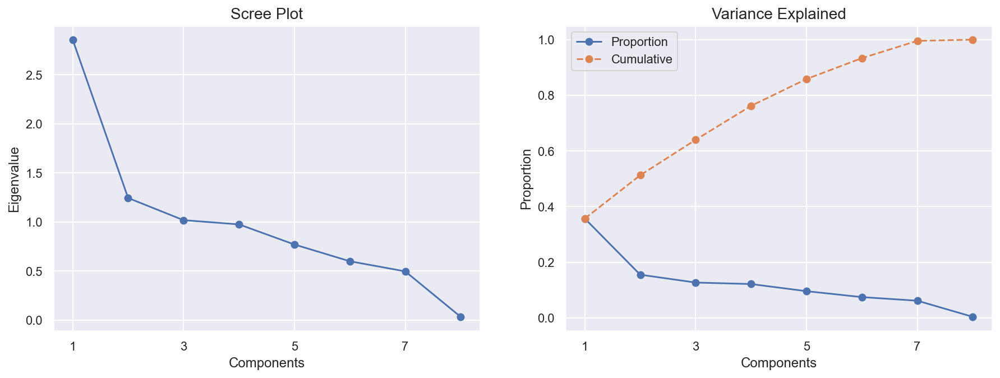

In [62]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [63]:
# Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=5)
pca_feat = pca.fit_transform(df_pca[metric_features])
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=df_pca.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df

,PC0,PC1,PC2,PC3,PC4
0,-0.667089,0.641957,0.082848,0.130205,-0.384000
1,3.481912,0.461573,2.353649,-1.668370,0.925376
2,1.399424,1.126667,-0.693073,-0.469192,0.512947
3,0.754412,-1.713760,0.206478,-0.844340,-1.980092
4,-0.496075,-0.432778,0.644338,-0.659593,-0.699527
...,...,...,...,...,...
10290,4.896714,1.747248,0.050707,-2.004809,0.760261
10291,-1.424312,-0.883743,0.318207,0.094887,0.229980
10293,-1.229327,0.762087,-1.631493,0.018030,-0.339919
10294,1.594203,0.003505,0.834666,0.204515,0.074851


In [64]:
# Reassigning df to contain pca variables
df_pca = pd.concat([df_pca, pca_df], axis=1)
df_pca.head()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0,PC0,PC1,PC2,PC3,PC4
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,1.0,0.0,0.0,0.0,0.0,0.0,1.0,-0.667089,0.641957,0.082848,0.130205,-0.384000
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1.0,0.0,0.0,0.0,0.0,1.0,1.0,3.481912,0.461573,2.353649,-1.668370,0.925376
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.399424,1.126667,-0.693073,-0.469192,0.512947
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.754412,-1.713760,0.206478,-0.844340,-1.980092
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0.0,1.0,0.0,0.0,0.0,1.0,1.0,-0.496075,-0.432778,0.644338,-0.659593,-0.699527


In [65]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df_pca[metric_features + pca_feat_names].corr().loc[metric_features, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2,PC3,PC4
member_age,-0.020845,0.037173,0.766692,0.636912,0.068034
MonthSal,-0.377881,-0.377519,-0.399864,0.388245,0.635574
CustMonVal,0.136569,0.652444,-0.440015,0.495920,-0.184368
PremMotor,-0.951722,0.249603,0.056023,-0.085895,0.008343
PremHousehold,0.739681,0.299858,-0.144553,0.166742,0.076205
PremHealth,0.440247,-0.716329,-0.170189,0.288485,-0.411865
PremLife,0.725093,0.057855,0.119565,-0.179387,0.293823
PremWork,0.723555,0.080407,0.101505,-0.151692,0.257914


<div class="alert alert-block alert-success">

## 3. Data Clustering
    
</div>

<div class="alert alert-block alert-info">

### 3.1. Hierarchical Clustering
    
</div>

In [66]:
df.columns
# We don't use PCA, so taking again df

Index(['member_age', 'MonthSal', 'CustMonVal', 'PremMotor', 'PremHousehold',
       'PremHealth', 'PremLife', 'PremWork', 'x0_b'2 - High School'',
       'x0_b'3 - BSc/MSc'', 'x0_b'4 - PhD'', 'x1_2.0', 'x1_3.0', 'x1_4.0',
       'x2_1.0'],
      dtype='object')

In [67]:
# Splitting feature names into groups
non_metric_features = list(df.columns[df.columns.str.startswith("x")])
metric_features = list(df.columns[~df.columns.isin(non_metric_features)])

In [68]:
# Performing HC
hclust = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=5)
hc_labels = hclust.fit_predict(df[metric_features])
hc_labels

array([0, 2, 4, ..., 0, 2, 0], dtype=int64)

In [69]:
# Characterizing the clusters
df_concat = pd.concat(
    (df, pd.Series(hc_labels, name = "labels")),
    axis=1
)
df_concat.groupby('labels').mean()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
labels,,,,,,,,,,,,,,,
0.0,-0.007673,0.030042,0.016840,0.005482,-0.007830,0.011590,-0.018869,-0.012732,0.349580,0.461911,0.072305,0.106520,0.195610,0.396062,0.696901
1.0,0.009873,-0.012863,-0.025582,0.018763,-0.018786,-0.012338,-0.024707,0.005735,0.328413,0.486347,0.065683,0.106273,0.204797,0.400738,0.708856
2.0,0.005192,-0.002843,0.006090,-0.024520,0.028758,0.001048,0.043937,0.009513,0.352902,0.439974,0.070580,0.096306,0.207124,0.395778,0.703826
3.0,-0.000197,0.003532,-0.008600,-0.011203,0.005645,-0.011425,0.016723,0.016704,0.336293,0.480577,0.071587,0.093230,0.194229,0.421199,0.716426
4.0,-0.011110,-0.042730,0.007358,-0.011859,0.010275,0.032194,0.012824,-0.014641,0.348624,0.484200,0.054027,0.091743,0.201835,0.409786,0.727829


In [70]:
# Computing SST
X = df[metric_features].values
sst = np.sum(np.square(X - X.mean(axis=0)), axis=0)

# Computing SSW
ssw_iter = []
for i in np.unique(hc_labels):
    X_k = X[hc_labels == i]
    ssw_iter.append(np.sum(np.square(X_k - X_k.mean(axis=0)), axis=0))
ssw = np.sum(ssw_iter, axis=0)

# Computing SSB
ssb_iter = []
for i in np.unique(hc_labels):
    X_k = X[hc_labels == i]
    ssb_iter.append(X_k.shape[0] * np.square(X_k.mean(axis=0) - X.mean(axis=0)))
ssb = np.sum(ssb_iter, axis=0)

# Verifying the formula
np.round(sst) == np.round((ssw + ssb))

array([ True,  True,  True,  True,  True,  True,  True,  True])

In [71]:
def get_r2_hc(df, link_method, max_nclus, min_nclus=1, dist="euclidean"):
    def get_ss(df):
        ss = np.sum(df.var() * (df.shape[0] -1))
        return ss  # return sum of sum of squares of each df variable
    
    sst = get_ss(df)  # get total sum of squares
    
    r2 = []  # where we will store the R2 metrics for each cluster solution
    
    for i in range(min_nclus, max_nclus+1):  # iterate over desired ncluster range
        cluster = AgglomerativeClustering(n_clusters=i, affinity=dist, linkage=link_method)
        
        #get cluster labels
        hclabels = cluster.fit_predict(df) 
        
        # concat df with labels
        df_concat = pd.concat((df, pd.Series(hclabels, name='labels')), axis=1)  
        
        # compute ssw for each cluster labels
        ssw_labels = df_concat.groupby(by='labels').apply(get_ss)  
        
        # Obtain SSB. Remember: SST = SSW + SSB
        ssb =  sst - np.sum(ssw_labels)
        
        # append the R2 of the given cluster solution
        r2.append(ssb/sst)
        
    return np.array(r2)

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=13.0.
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'STIXGeneral' (STIXGeneralBolIta.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXNonUnicode' (STIXNonUniIta.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmr10' (cmr10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Italic.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmex10' (cmex10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans.ttf) normal normal 400 normal>) = 2.05
findfont: score(<Font 'STIXSizeOneSym' (STIXSizOneSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Display' (DejaVuSansDisplay.ttf) normal normal 400 normal

findfont: score(<Font 'Mongolian Baiti' (monbaiti.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Copperplate Gothic Light' (COPRGTL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (SitkaI.ttc) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bodoni MT' (BOD_BI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Agency FB' (AGENCYR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Bold ITC' (ERASBD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Demi ITC' (ERASDEMI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gloucester MT Extra Condensed' (GLECB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Guttman Logo1' (LOGO1.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Cambria' (cambriai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Century Gothic' (GOTHICBI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Fran

findfont: score(<Font 'Guttman-Aram' (ARAM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Trebuchet MS' (trebuc.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe UI' (seguisbi.ttf) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Californian FB' (CALIFR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Castellar' (CASTELAR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'OCR A Extended' (OCRAEXT.TTF) normal normal 400 expanded>) = 10.25
findfont: score(<Font 'Brush Script MT' (BRUSHSCI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Lucida Bright' (LBRITEDI.TTF) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Palace Script MT' (PALSCRI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Microsoft Uighur' (MSUIGHUB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Franklin Gothic Medium Cond' (FRAMDCN.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'P

findfont: score(<Font 'Monotype Corsiva' (MTCORSVA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Constantia' (constan.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibrib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Corbel' (corbelb.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Gill Sans Ultra Bold Condensed' (GILLUBCD.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Gadugi' (gadugi.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calisto MT' (CALIST.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Perpetua Titling MT' (PERTIBD.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Calisto MT' (CALISTB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Berlin Sans FB' (BRLNSR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gill Sans MT Condensed' (GILC____.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Ca

findfont: score(<Font 'Segoe UI Emoji' (seguiemj.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Verdana' (verdanai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Goudy Old Style' (GOUDOS.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Garamond' (GARA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (Sitka.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Hadassah Friedlaender' (HADASAHB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Segoe UI' (seguisb.ttf) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Lucida Sans Typewriter' (LTYPEB.TTF) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Cambria' (cambria.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Century Gothic' (GOTHICB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Eras Medium ITC' (ERASMD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe MDL2 Assets' (segm

findfont: score(<Font 'Leelawadee UI' (LeelUIsl.ttf) normal normal 350 normal>) = 10.0975
findfont: score(<Font 'Chiller' (CHILLER.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibri.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Microsoft YaHei' (msyh.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Comic Sans MS' (comici.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bell MT' (BELLB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Goudy Old Style' (GOUDOSB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Segoe UI' (segoeuib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Bauhaus 93' (BAUHS93.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Georgia' (georgiai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Gill Sans MT Ext Condensed Bold' (GLSNECB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Poor Richard' (POORICH.TT

findfont: score(<Font 'Corbel' (corbelli.ttf) italic normal 300 normal>) = 11.145
findfont: score(<Font 'Nirmala UI' (NirmalaS.ttf) normal normal 350 normal>) = 10.0975
findfont: score(<Font 'Tw Cen MT Condensed Extra Bold' (TCCEB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Guttman Hatzvi' (TZVIM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Arial' (ARIALN.TTF) normal normal 400 condensed>) = 0.25
findfont: score(<Font 'MS Gothic' (msgothic.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Magneto' (MAGNETOB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Bookman Old Style' (BOOKOSI.TTF) italic normal 300 normal>) = 11.145
findfont: score(<Font 'Onyx' (ONYX.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Tempus Sans ITC' (TEMPSITC.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'High Tower Text' (HTOWERTI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Candara' (Candarai.ttf)

findfont: score(<Font 'Gill Sans MT' (GILI____.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Perpetua Titling MT' (PERTILI.TTF) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Garamond' (GARAIT.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Wingdings 2' (WINGDNG2.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Franklin Gothic Medium' (framd.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Niagara Solid' (NIAGSOL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Lucida Sans Unicode' (l_10646.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Garamond' (GARABD.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Georgia' (georgiab.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Microsoft YaHei' (msyhl.ttc) normal normal 290 normal>) = 10.1545
findfont: score(<Font 'Tw Cen MT' (TCBI____.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'ROG Fonts' (ROGF

findfont: score(<Font 'Microsoft JhengHei' (msjh.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Parchment' (PARCHM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Book Antiqua' (ANTQUABI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Trebuchet MS' (trebucbd.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Corbel' (corbell.ttf) normal normal 300 normal>) = 10.145
findfont: score(<Font 'Arial' (arialbd.ttf) normal normal 700 normal>) = 0.33499999999999996
findfont: score(<Font 'Segoe UI' (seguili.ttf) italic normal 300 normal>) = 11.145
findfont: score(<Font 'Guttman Yad' (GYADL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Agency FB' (AGENCYB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Constantia' (constani.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Rockwell' (ROCK.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Bodoni MT' (BOD_BLAI.TTF) italic normal 90

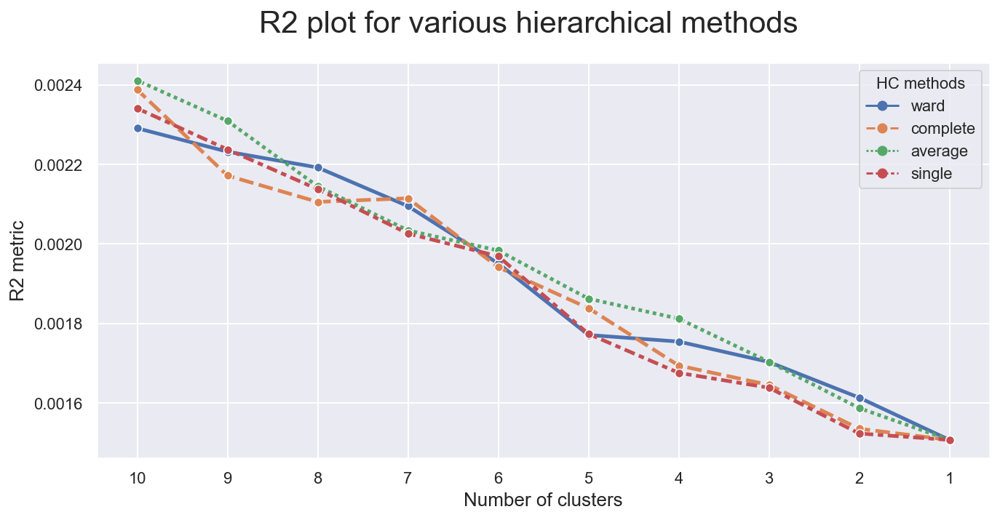

In [72]:
# Prepare input
hc_methods = ["ward", "complete", "average", "single"]

# Call function defined above to obtain the R2 statistic for each hc_method
max_nclus = 10
r2_hc_methods = np.vstack(
    [
        get_r2_hc(df[metric_features], link, max_nclus, min_nclus=1, dist="euclidean") 
        for link in hc_methods
    ]
).T
r2_hc_methods = pd.DataFrame(r2_hc_methods, index=range(1, max_nclus + 1), columns=hc_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=21)
plt.gca().invert_xaxis()  # invert x axis
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)

plt.show()

In [73]:
# Defining the number of clusters

# setting distance_threshold=0 and n_clusters=None ensures we compute the full tree
linkage = "ward"  # We chose ward linkage, because it shows the best result on the plot above
distance = "euclidean"

# Define the clusterer
hclust = AgglomerativeClustering(distance_threshold = 0, n_clusters = None, linkage = linkage, affinity = distance)
hclust.fit_predict(df[metric_features])

array([6618, 9115, 7675, ...,    1,    2,    0], dtype=int64)

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=6.0.
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'STIXGeneral' (STIXGeneralBolIta.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXNonUnicode' (STIXNonUniIta.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmr10' (cmr10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Italic.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmex10' (cmex10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans.ttf) normal normal 400 normal>) = 2.05
findfont: score(<Font 'STIXSizeOneSym' (STIXSizOneSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Display' (DejaVuSansDisplay.ttf) normal normal 400 normal>

findfont: score(<Font 'Mongolian Baiti' (monbaiti.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Copperplate Gothic Light' (COPRGTL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (SitkaI.ttc) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bodoni MT' (BOD_BI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Agency FB' (AGENCYR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Bold ITC' (ERASBD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Demi ITC' (ERASDEMI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gloucester MT Extra Condensed' (GLECB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Guttman Logo1' (LOGO1.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Cambria' (cambriai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Century Gothic' (GOTHICBI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Fran

findfont: score(<Font 'Guttman-Aram' (ARAM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Trebuchet MS' (trebuc.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe UI' (seguisbi.ttf) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Californian FB' (CALIFR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Castellar' (CASTELAR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'OCR A Extended' (OCRAEXT.TTF) normal normal 400 expanded>) = 10.25
findfont: score(<Font 'Brush Script MT' (BRUSHSCI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Lucida Bright' (LBRITEDI.TTF) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Palace Script MT' (PALSCRI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Microsoft Uighur' (MSUIGHUB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Franklin Gothic Medium Cond' (FRAMDCN.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'P

findfont: score(<Font 'Monotype Corsiva' (MTCORSVA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Constantia' (constan.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibrib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Corbel' (corbelb.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Gill Sans Ultra Bold Condensed' (GILLUBCD.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Gadugi' (gadugi.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calisto MT' (CALIST.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Perpetua Titling MT' (PERTIBD.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Calisto MT' (CALISTB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Berlin Sans FB' (BRLNSR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gill Sans MT Condensed' (GILC____.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Ca

findfont: score(<Font 'Segoe UI Emoji' (seguiemj.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Verdana' (verdanai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Goudy Old Style' (GOUDOS.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Garamond' (GARA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (Sitka.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Hadassah Friedlaender' (HADASAHB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Segoe UI' (seguisb.ttf) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Lucida Sans Typewriter' (LTYPEB.TTF) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Cambria' (cambria.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Century Gothic' (GOTHICB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Eras Medium ITC' (ERASMD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe MDL2 Assets' (segm

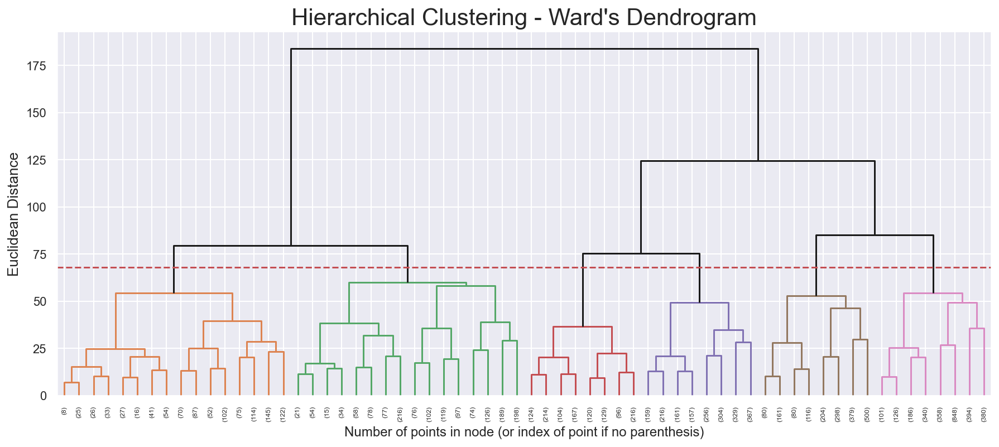

In [74]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(15,6))
# The Dendrogram parameters need to be tuned
y_threshold = 68
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()

In [75]:
# Further we create 3, 5 and 6 cluster solutions, to select the best clustering solution
# 3 cluster solution
linkage = "ward" 
distance = "euclidean"
hclust = AgglomerativeClustering(n_clusters = 3, linkage = linkage, affinity = distance)
hc_labels_3 = hclust.fit_predict(df[metric_features])

In [76]:
# Characterizing the final clusters
df_hc3 = pd.concat((df.reset_index(drop=True), pd.Series(hc_labels_3, name='labels')), axis=1)
df_hc3.groupby('labels').mean()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
labels,,,,,,,,,,,,,,,
0,0.050819,0.229480,-0.036015,-0.135174,-0.181170,0.532627,-0.151335,-0.165360,0.343002,0.524280,0.064821,0.099758,0.206328,0.408042,0.620083
1,-0.020902,-0.548734,0.291241,-1.109082,1.113922,0.132211,1.031934,1.036867,0.465429,0.214145,0.008297,0.097195,0.191624,0.399447,0.665350
2,-0.057189,0.110447,-0.183785,1.097232,-0.639574,-0.884453,-0.616575,-0.600115,0.241424,0.598910,0.121834,0.106124,0.197820,0.397884,0.870792


In [77]:
# 5 cluster solution
linkage = "ward" 
distance = "euclidean"
hclust = AgglomerativeClustering(n_clusters = 5, linkage = linkage, affinity = distance)
hc_labels_5 = hclust.fit_predict(df[metric_features])

In [78]:
# Characterizing the final clusters
df_hc5 = pd.concat((df.reset_index(drop=True), pd.Series(hc_labels_5, name='labels')), axis=1)
df_hc5.groupby('labels').mean()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
labels,,,,,,,,,,,,,,,
0,-0.057189,0.110447,-0.183785,1.097232,-0.639574,-0.884453,-0.616575,-0.600115,0.241424,0.598910,0.121834,0.106124,0.197820,0.397884,0.870792
1,-0.038001,0.923106,-0.172873,-0.200853,-0.128891,0.491426,-0.078979,-0.070473,0.353092,0.512989,0.061471,0.098793,0.202708,0.415660,0.409806
2,0.053447,-0.634811,-0.503017,-1.196254,0.916036,0.109350,1.274830,1.279687,0.469361,0.182529,0.007823,0.091265,0.194915,0.405476,0.679922
3,0.184342,-0.813248,0.169723,-0.036440,-0.259762,0.594563,-0.260108,-0.308003,0.327833,0.541254,0.069857,0.101210,0.211771,0.396590,0.936194
4,-0.135297,-0.416296,1.513300,-0.974959,1.418394,0.167385,0.658210,0.663262,0.459378,0.262788,0.009027,0.106319,0.186560,0.390171,0.642929


In [79]:
# 6 cluster solution
linkage = "ward" 
distance = "euclidean"
hclust = AgglomerativeClustering(n_clusters = 6, linkage = linkage, affinity = distance)
hc_labels_6 = hclust.fit_predict(df[metric_features])

In [80]:
# Characterizing the final clusters
df_hc6 = pd.concat((df.reset_index(drop=True), pd.Series(hc_labels_6, name='labels')), axis=1)
df_hc6.groupby('labels').mean()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
labels,,,,,,,,,,,,,,,
0,0.053447,-0.634811,-0.503017,-1.196254,0.916036,0.109350,1.274830,1.279687,0.469361,0.182529,0.007823,0.091265,0.194915,0.405476,0.679922
1,-0.038001,0.923106,-0.172873,-0.200853,-0.128891,0.491426,-0.078979,-0.070473,0.353092,0.512989,0.061471,0.098793,0.202708,0.415660,0.409806
2,-0.075448,0.064404,-0.901597,1.009548,-0.641989,-0.746586,-0.600836,-0.582260,0.249359,0.599795,0.112878,0.111852,0.192919,0.401231,0.863520
3,0.184342,-0.813248,0.169723,-0.036440,-0.259762,0.594563,-0.260108,-0.308003,0.327833,0.541254,0.069857,0.101210,0.211771,0.396590,0.936194
4,-0.135297,-0.416296,1.513300,-0.974959,1.418394,0.167385,0.658210,0.663262,0.459378,0.262788,0.009027,0.106319,0.186560,0.390171,0.642929
5,-0.026773,0.187145,1.011953,1.243297,-0.635550,-1.114115,-0.642795,-0.629860,0.228205,0.597436,0.136752,0.096581,0.205983,0.392308,0.882906


<div class="alert alert-block alert-info">

### 3.2. K-Means Clustering
    
</div>

In [81]:
kmclust = KMeans(n_clusters = 10, init = "k-means++", n_init = 10)
# the fit method
kmclust.fit(df[metric_features])


KMeans(n_clusters=10)

In [82]:
# the predict method
kmclust.predict(df[metric_features])

array([5, 2, 8, ..., 0, 6, 0])

In [83]:
pd.DataFrame(kmclust.transform(df[metric_features]))

,0,1,2,3,4,5,6,7,8,9
0,1.365991,2.366854,3.902479,2.027977,4.500453,1.221676,2.185886,2.106108,3.677150,2.584856
1,6.163535,5.179605,2.124578,5.674095,3.167981,6.023855,4.558856,5.883781,4.922139,5.399778
2,2.879356,3.245714,2.911800,4.037849,2.728202,3.367510,2.857656,3.642915,2.511632,2.735610
3,3.893814,3.300944,4.127224,3.913681,4.472205,4.276160,1.611138,3.602298,4.775694,3.057695
4,2.298232,2.344044,4.043591,1.815436,4.077019,2.379365,1.534938,1.764159,4.333171,2.499424
...,...,...,...,...,...,...,...,...,...,...
10196,6.839996,6.510559,4.183433,7.279866,2.843458,7.204795,5.673728,6.958195,4.398732,6.070842
10197,2.321453,1.911035,4.765634,1.271837,5.063171,2.143405,2.634158,1.553931,4.897061,2.327104
10198,0.768932,3.254196,4.955411,3.112514,5.363187,2.190638,3.201331,2.269965,3.994244,2.577773
10199,3.619835,2.335007,2.925487,3.494119,2.173554,3.348956,1.997050,3.813837,3.047990,2.839243


In [84]:
range_clusters = range(1, 11)

In [85]:
inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus)
    kmclust.fit(df[metric_features])
    inertia.append(kmclust.inertia_)  # save the inertia of the given cluster solution

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=15.0.
findfont: score(<Font 'STIXSizeThreeSym' (STIXSizThreeSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'STIXGeneral' (STIXGeneralBolIta.ttf) italic normal 700 normal>) = 11.335
findfont: score(<Font 'STIXNonUnicode' (STIXNonUniIta.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmmi10' (cmmi10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'cmr10' (cmr10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Serif' (DejaVuSerif-Italic.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'cmex10' (cmex10.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'DejaVu Sans' (DejaVuSans.ttf) normal normal 400 normal>) = 2.05
findfont: score(<Font 'STIXSizeOneSym' (STIXSizOneSymBol.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'DejaVu Sans Display' (DejaVuSansDisplay.ttf) normal normal 400 normal

findfont: score(<Font 'Mongolian Baiti' (monbaiti.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Copperplate Gothic Light' (COPRGTL.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (SitkaI.ttc) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Bodoni MT' (BOD_BI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Agency FB' (AGENCYR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Bold ITC' (ERASBD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Eras Demi ITC' (ERASDEMI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gloucester MT Extra Condensed' (GLECB.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Guttman Logo1' (LOGO1.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Cambria' (cambriai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Century Gothic' (GOTHICBI.TTF) italic normal 700 normal>) = 11.335
findfont: score(<Font 'Fran

findfont: score(<Font 'Guttman-Aram' (ARAM.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Trebuchet MS' (trebuc.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe UI' (seguisbi.ttf) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Californian FB' (CALIFR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Castellar' (CASTELAR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'OCR A Extended' (OCRAEXT.TTF) normal normal 400 expanded>) = 10.25
findfont: score(<Font 'Brush Script MT' (BRUSHSCI.TTF) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Lucida Bright' (LBRITEDI.TTF) italic normal 600 normal>) = 11.24
findfont: score(<Font 'Palace Script MT' (PALSCRI.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Microsoft Uighur' (MSUIGHUB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Franklin Gothic Medium Cond' (FRAMDCN.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'P

findfont: score(<Font 'Monotype Corsiva' (MTCORSVA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Constantia' (constan.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calibri' (calibrib.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Corbel' (corbelb.ttf) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Gill Sans Ultra Bold Condensed' (GILLUBCD.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Gadugi' (gadugi.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Calisto MT' (CALIST.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Perpetua Titling MT' (PERTIBD.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Calisto MT' (CALISTB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Berlin Sans FB' (BRLNSR.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Gill Sans MT Condensed' (GILC____.TTF) normal normal 400 condensed>) = 10.25
findfont: score(<Font 'Ca

findfont: score(<Font 'Segoe UI Emoji' (seguiemj.ttf) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Verdana' (verdanai.ttf) italic normal 400 normal>) = 11.05
findfont: score(<Font 'Goudy Old Style' (GOUDOS.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Garamond' (GARA.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Sitka Small' (Sitka.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Hadassah Friedlaender' (HADASAHB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Segoe UI' (seguisb.ttf) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Lucida Sans Typewriter' (LTYPEB.TTF) normal normal 600 normal>) = 10.24
findfont: score(<Font 'Cambria' (cambria.ttc) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Century Gothic' (GOTHICB.TTF) normal normal 700 normal>) = 10.335
findfont: score(<Font 'Eras Medium ITC' (ERASMD.TTF) normal normal 400 normal>) = 10.05
findfont: score(<Font 'Segoe MDL2 Assets' (segm

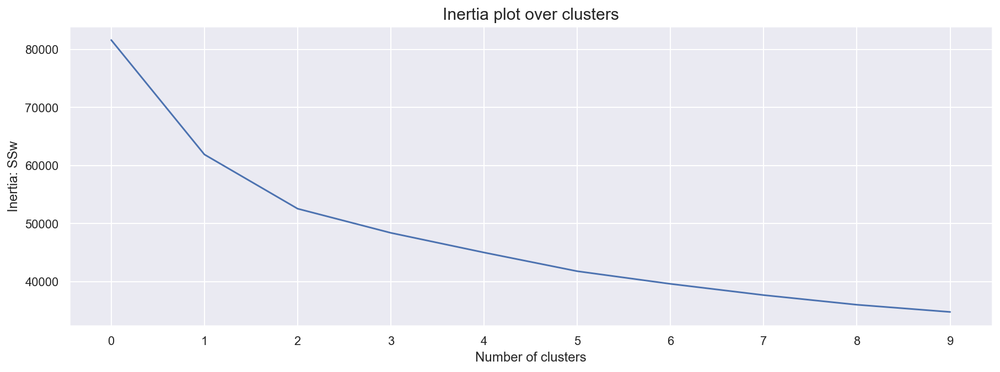

In [86]:
# The inertia plot
plt.figure(figsize=(15,5))
plt.plot(inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.xticks(range(10), )
plt.show()

max_iter: the maximum number of iterations, generally if the data set is convex, 
you can ignore this value, if the data set is not convex, it may be difficult to converge, 
then you can specify the maximum number of iterations so that the algorithm can exit the loop in time.

For n_clusters = 2, the average silhouette_score is : 0.24290348921911475
For n_clusters = 3, the average silhouette_score is : 0.19203596056658
For n_clusters = 4, the average silhouette_score is : 0.16402591831443586
For n_clusters = 5, the average silhouette_score is : 0.18540683367308233
For n_clusters = 6, the average silhouette_score is : 0.15649344649938227
For n_clusters = 7, the average silhouette_score is : 0.16586916442949684
For n_clusters = 8, the average silhouette_score is : 0.16527790476426513
For n_clusters = 9, the average silhouette_score is : 0.15513620117849206
For n_clusters = 10, the average silhouette_score is : 0.1533533097153239


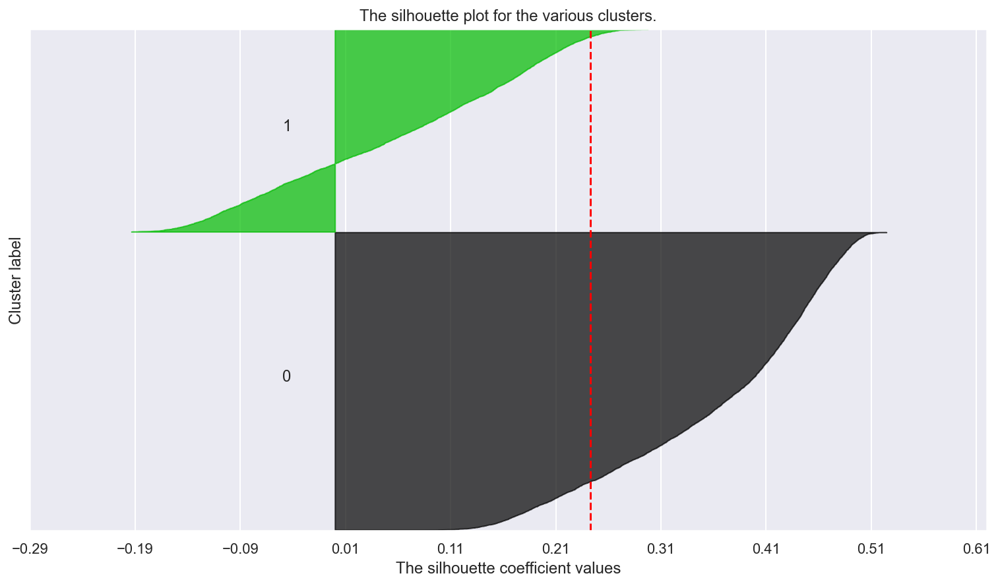

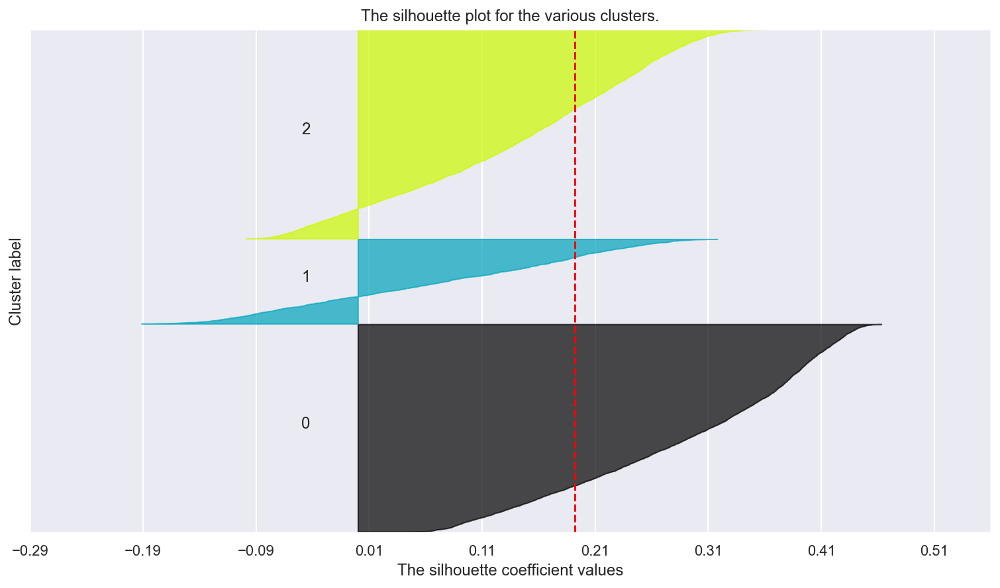

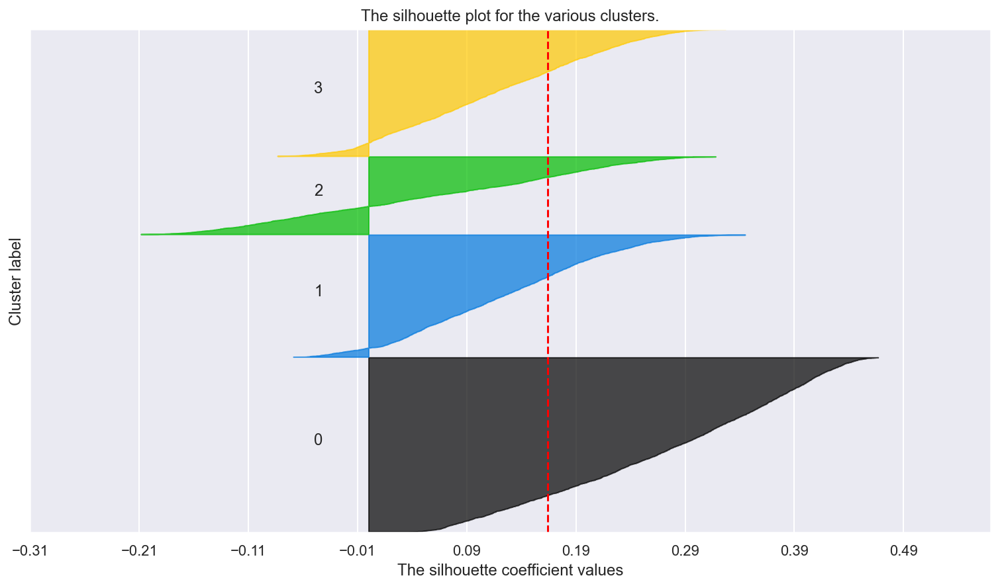

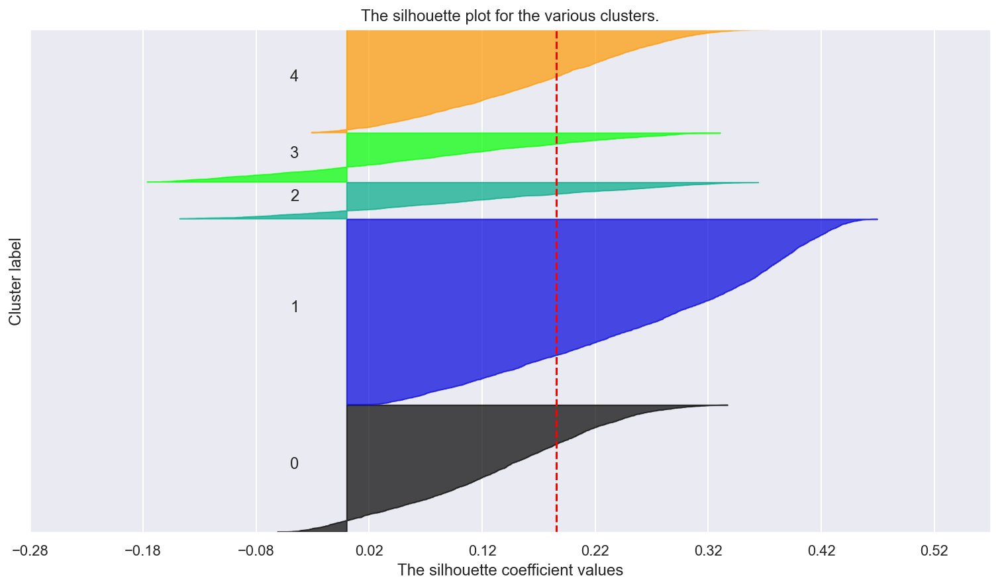

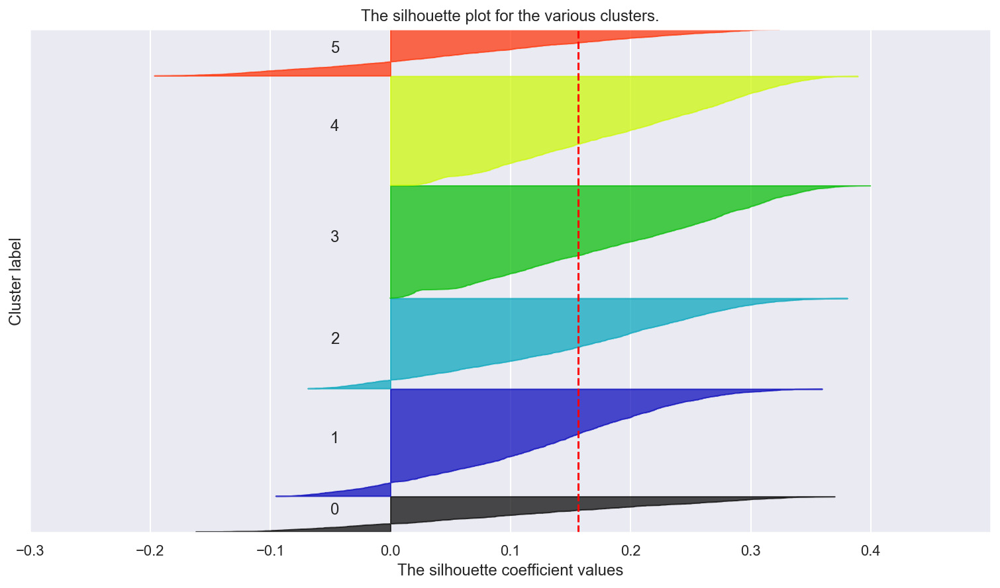

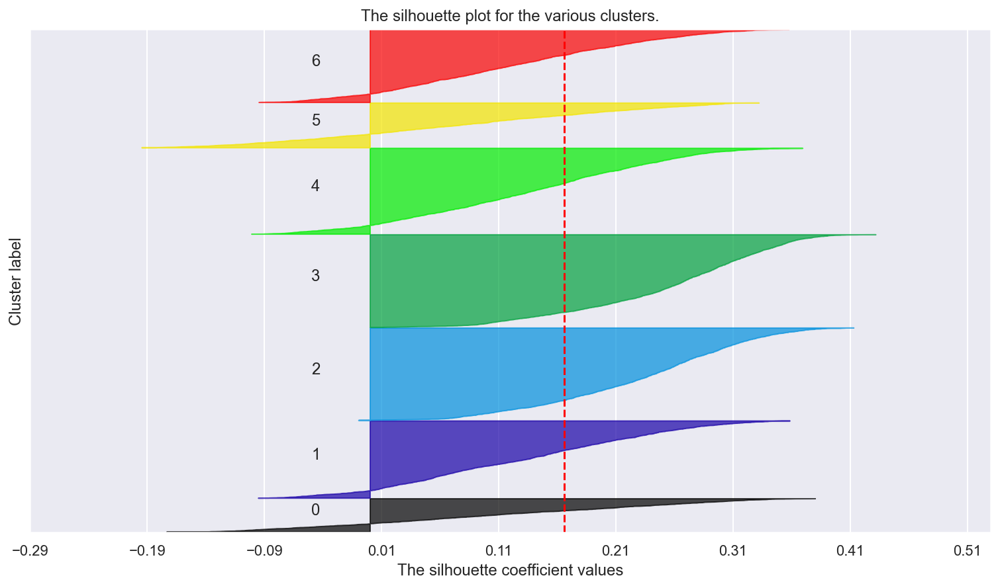

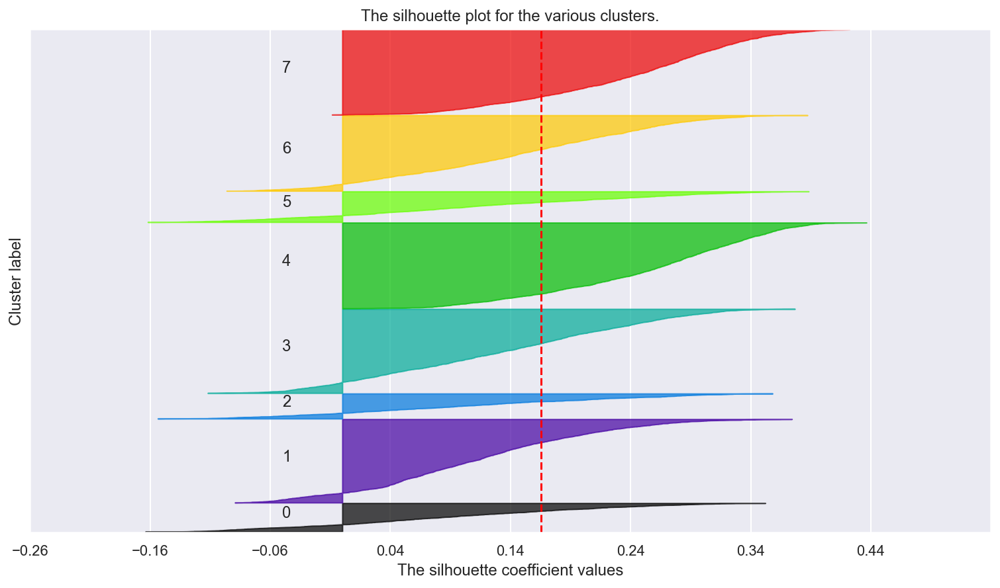

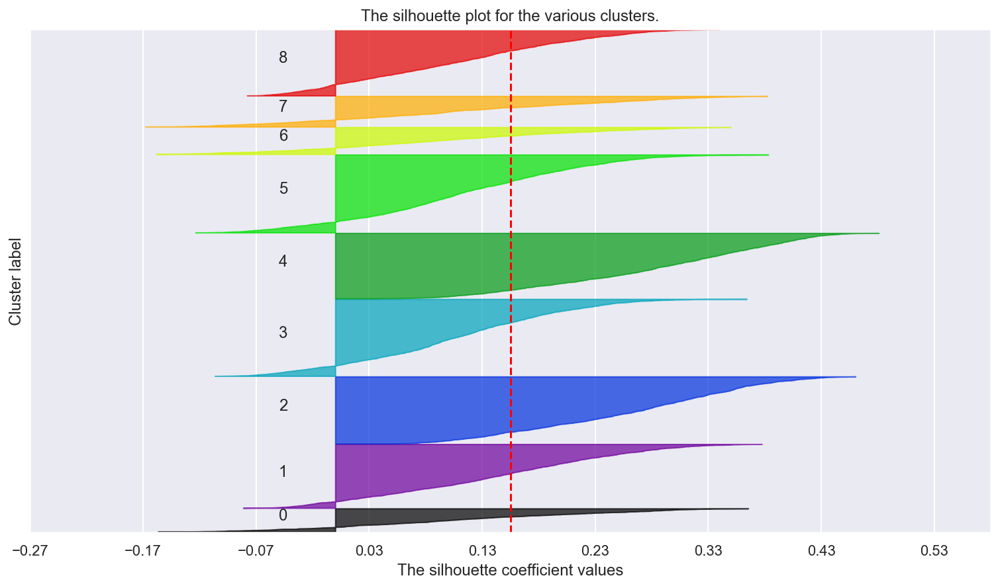

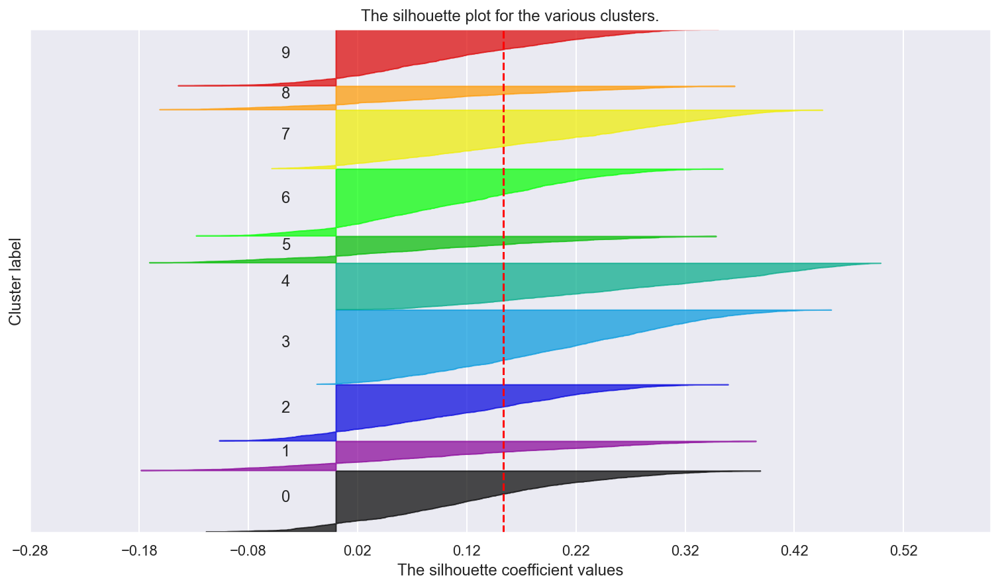

In [87]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++',max_iter=2000, n_init=10, random_state=3)
    cluster_labels = kmclust.fit_predict(df[metric_features])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(df[metric_features], cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df[metric_features], cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(df[metric_features]) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

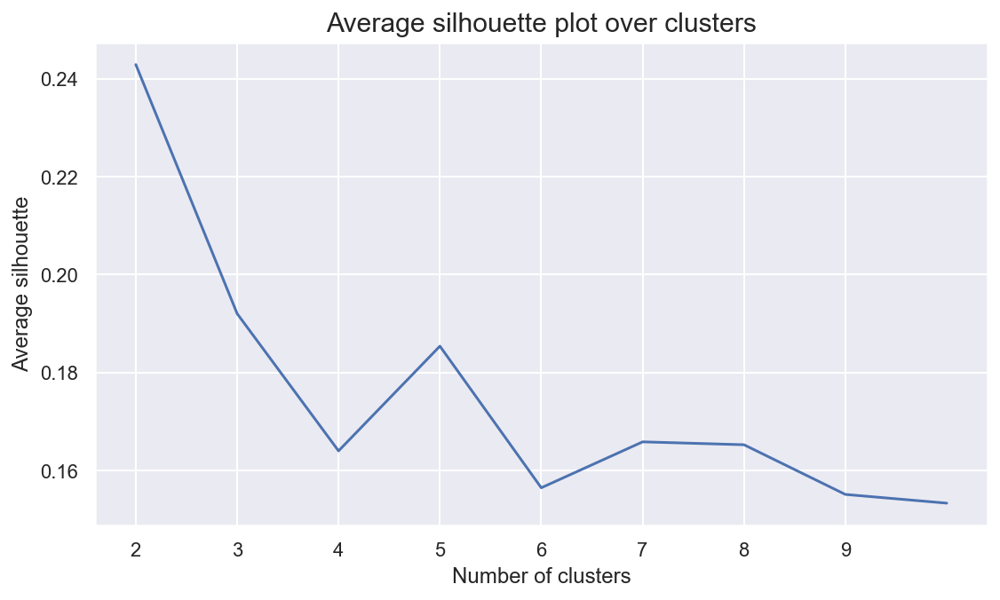

In [88]:
# The average silhouette plot
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(avg_silhouette)
plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.xticks(range(8), range(2, 10))
plt.show()

In [89]:
# 5 cluster solution
number_clusters =  5
kmclust = KMeans(n_clusters=number_clusters, init='k-means++',max_iter=2000, n_init=10, random_state=3)
km_labels = kmclust.fit_predict(df[metric_features])
km_labels

array([1, 3, 2, ..., 1, 4, 1])

In [90]:
# Characterizing the final clusters
df_km = pd.concat((df.reset_index(drop=True), pd.Series(km_labels, name='labels')), axis=1)
df_km.groupby('labels').mean()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0
labels,,,,,,,,,,,,,,,
0,-0.032759,1.087925,-0.184085,-0.361490,-0.008170,0.646884,0.033789,0.023107,0.380510,0.491879,0.048337,0.102088,0.192962,0.428461,0.319412
1,0.017102,0.094688,0.003655,1.040193,-0.595851,-0.855408,-0.589191,-0.589612,0.244509,0.594866,0.119344,0.103202,0.206933,0.385552,0.865044
2,-0.085677,-0.483264,1.857462,-1.088286,1.996578,0.005588,0.601224,0.760108,0.479026,0.215156,0.006766,0.109608,0.194858,0.397835,0.650880
3,-0.022603,-1.044414,-0.425750,-1.419665,1.007853,-0.146794,1.876305,1.664309,0.439880,0.106212,0.003006,0.080160,0.199399,0.414830,0.722445
4,0.050481,-0.844091,-0.231317,-0.369226,-0.099315,0.810917,-0.084651,-0.025874,0.376846,0.481658,0.053359,0.102906,0.198666,0.398285,0.917103


<div class="alert alert-block alert-info">

### 3.3. Density Clustering

    
</div>

In [91]:
from os.path import join
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from sklearn.neighbors import NearestNeighbors
from sklearn.mixture import GaussianMixture
from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth

In [92]:
# Splitting feature names into groups
non_metric_features = df.columns[df.columns.str.startswith('x')]
metric_features = df.columns[~df.columns.str.startswith('x')]

In [93]:
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

In [94]:
# The following bandwidth can be automatically detected using (we need to set quantile though)
# Based on distance to nearest neighbors for all observations
bandwidth = estimate_bandwidth(df[metric_features], quantile=0.06, random_state=1, n_jobs=-1)
bandwidth

2.1382814630519342

In [95]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
ms = MeanShift(bandwidth=bandwidth, bin_seeding=True, n_jobs=4)
ms_labels = ms.fit_predict(df[metric_features])

ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 7


In [96]:
# Concatenating the labels to df
df_DCms = pd.concat([df[metric_features], pd.Series(ms_labels, index=df.index, name="ms_labels")], axis=1)
df_DCms.head()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,ms_labels
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,0
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,5
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0


In [97]:
# Computing the R^2 of the cluster solution
sst = get_ss(df[metric_features])  # get total sum of squares
ssw_labels = df_DCms.groupby(by='ms_labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of 0.2491


In [98]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=1.9, min_samples=20, n_jobs=4)
dbscan_labels = dbscan.fit_predict(df[metric_features])

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 2


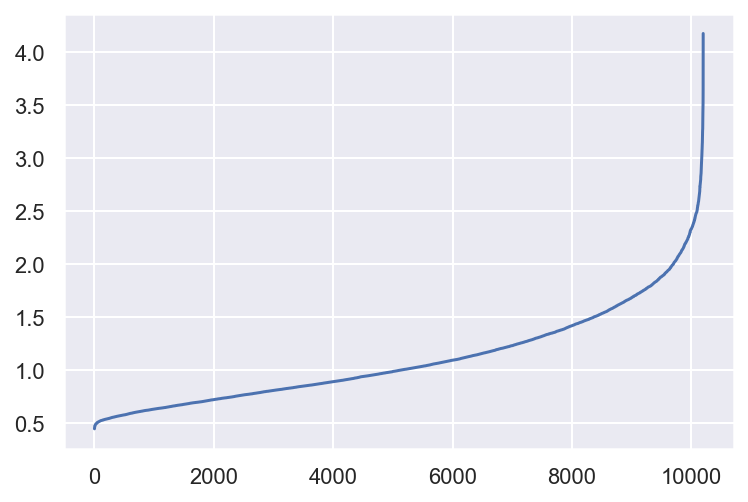

In [99]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(df[metric_features])
distances, _ = neigh.kneighbors(df[metric_features])
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.show()

In [100]:
# Concatenating the labels to df
df_DCdb = pd.concat([df[metric_features], pd.Series(dbscan_labels, index=df.index, name="dbscan_labels")], axis=1)
df_DCdb.head()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,dbscan_labels
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,0
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,0
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0


In [101]:
# Detecting noise (potential outliers)
df_DCdb.loc[df_DCdb['dbscan_labels'] == -1]

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,dbscan_labels
341,-0.452170,1.191914,-0.445532,-1.238552,-0.325140,-0.405401,3.857080,1.449853,-1
386,-1.664924,-1.267341,-0.097313,-1.145855,0.301655,-2.249070,-0.266285,-0.317222,-1
480,0.305801,-0.945368,2.608677,-1.938208,2.137412,-0.933006,0.667143,4.604558,-1
540,-1.361735,-0.867686,-0.961931,-2.017196,-0.315148,-0.457571,1.155505,5.691142,-1
574,-0.148982,0.617474,-1.796263,-1.316743,0.237488,-0.052144,0.431405,3.703843,-1
...,...,...,...,...,...,...,...,...,...
9817,1.063772,-2.116734,1.072298,-1.666571,2.041272,-0.956879,-0.054576,4.846804,-1
9936,-0.452170,-1.623043,2.095762,-1.944663,1.135606,-0.670679,5.088807,0.842916,-1
9947,-0.148982,-2.130022,-1.444999,-1.895486,5.359978,-1.354796,-0.564584,2.896283,-1
10112,-1.058547,1.229733,0.878638,-1.595633,1.735313,-0.684090,4.107322,-0.451779,-1


In [102]:
# Computing the R^2 of the cluster solution
df_nonoise = df_DCdb.loc[df_DCdb['dbscan_labels'] != -1]
sst = get_ss(df[metric_features])  # get total sum of squares
ssw_labels = df_nonoise.groupby(by='dbscan_labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of 0.0670


In [103]:
# Performing GMM clustering
gmm = GaussianMixture(n_components=4, covariance_type='full', n_init=10, init_params='kmeans', random_state=1)
gmm_labels = gmm.fit_predict(df[metric_features])
labels_proba = gmm.predict_proba(df[metric_features])

In [104]:
# The estimated component weights
gmm.weights_

array([0.32458607, 0.00849591, 0.24148635, 0.42543166])

In [105]:
# The estimated mean vectors of the Components
gmm.means_

array([[-6.43839241e-04,  6.24114729e-02, -4.78562725e-02,
         1.05222072e+00, -6.77823444e-01, -6.91196544e-01,
        -6.74680976e-01, -6.62615804e-01],
       [ 8.51209857e-02, -1.21428096e-01, -3.03201484e-01,
        -1.16960812e+00, -1.39491191e-01, -1.08433927e+00,
         5.86911430e-02, -2.05942829e-01],
       [-4.34923111e-02, -4.43981194e-01,  2.45597813e-01,
        -1.14714840e+00,  1.12639266e+00,  1.40415840e-01,
         1.08394675e+00,  1.08108671e+00],
       [ 2.34787430e-02,  2.06823221e-01, -9.68406259e-02,
        -1.28289983e-01, -1.19434702e-01,  4.69303831e-01,
        -1.01696559e-01, -1.03993563e-01]])

In [106]:
# The estimated covariance matrices of the Components
gmm.covariances_.shape

(4, 8, 8)

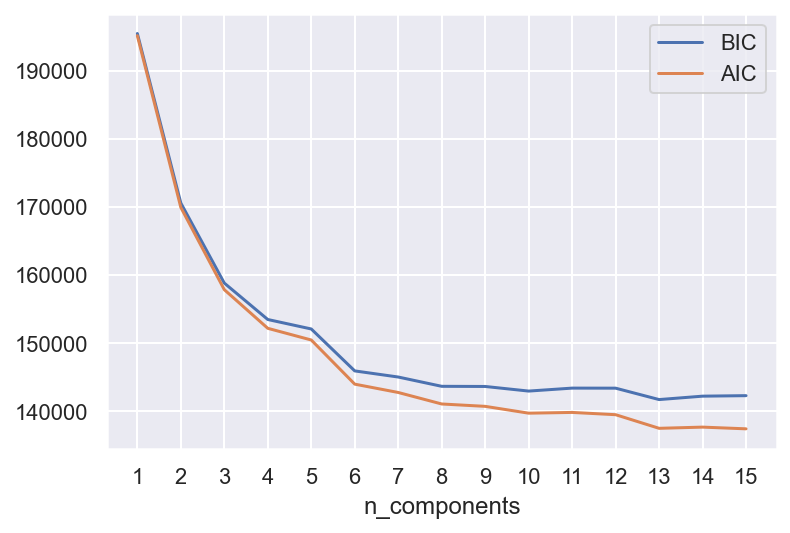

In [107]:
# Selecting number of components based on AIC and BIC
n_components = np.arange(1, 16)
models = [GaussianMixture(n, covariance_type='full', n_init=10, random_state=1).fit(df[metric_features])
          for n in n_components]

bic_values = [m.bic(df[metric_features]) for m in models]
aic_values = [m.aic(df[metric_features]) for m in models]
plt.plot(n_components, bic_values, label='BIC')
plt.plot(n_components, aic_values, label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components')
plt.xticks(n_components)
plt.show()

In [108]:
# Performing GMM clustering
gmm = GaussianMixture(n_components=6, covariance_type='full', n_init=10, init_params='kmeans', random_state=1)
gmm_labels = gmm.fit_predict(df[metric_features])

In [109]:
# Concatenating the labels to df
df_DCgmm = pd.concat([df[metric_features], pd.Series(gmm_labels, index=df.index, name="gmm_labels")], axis=1)
df_DCgmm.head()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,gmm_labels
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,0
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,4
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,4
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0


In [110]:
# Computing the R^2 of the cluster solution
sst = get_ss(df[metric_features])  # get total sum of squares
ssw_labels = df_DCgmm.groupby(by='gmm_labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
print("Cluster solution with R^2 of %0.4f" % r2)

Cluster solution with R^2 of 0.3833


<div class="alert alert-block alert-info">

### 3.4. Clustering by Perspectives

    
</div>

In [111]:
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst
    
def get_r2_scores(df, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2(df, labels)
    return r2_clust


# Set up the clusterers
kmeans = KMeans(
    init='k-means++',
    n_init=20,
    random_state=42
)

hierarchical = AgglomerativeClustering(
    affinity='euclidean'
)

In [112]:
df.columns

Index(['member_age', 'MonthSal', 'CustMonVal', 'PremMotor', 'PremHousehold',
       'PremHealth', 'PremLife', 'PremWork', 'x0_b'2 - High School'',
       'x0_b'3 - BSc/MSc'', 'x0_b'4 - PhD'', 'x1_2.0', 'x1_3.0', 'x1_4.0',
       'x2_1.0'],
      dtype='object')

In [113]:
# Split variables into perspectives (example, requires critical thinking and domain knowledge)
demographic_features = [
    'member_age',
    'MonthSal',
   
]

preference_features = [
    'CustMonVal',
    'PremMotor', 
    'PremHousehold', 
    'PremHealth',
    'PremLife', 
    'PremWork', 
]

df_dem = df[demographic_features].copy()
df_prf = df[preference_features].copy()

<div class="alert alert-block alert-info">

#### 3.4.1 Clustering by Perspectives on KMeans, merging the labels manually

    
</div>

In [114]:
# Obtaining the R² scores for each cluster solution on demographic variables
r2_scores = {}
r2_scores['kmeans'] = get_r2_scores(df_dem, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_dem, hierarchical.set_params(linkage=linkage)
    )

pd.DataFrame(r2_scores)

,kmeans,complete,average,single,ward
2,0.373021,0.334259,0.323001,0.000295,0.352906
3,0.595953,0.455677,0.550215,0.001170,0.549404
4,0.731263,0.625496,0.669222,0.001550,0.661536
5,0.773950,0.674337,0.741489,0.002228,0.722147
6,0.807934,0.702412,0.783387,0.003038,0.767615
7,0.835574,0.799430,0.816865,0.003039,0.802024
8,0.857097,0.813636,0.817287,0.003272,0.824207
9,0.874884,0.820630,0.837892,0.003577,0.843763


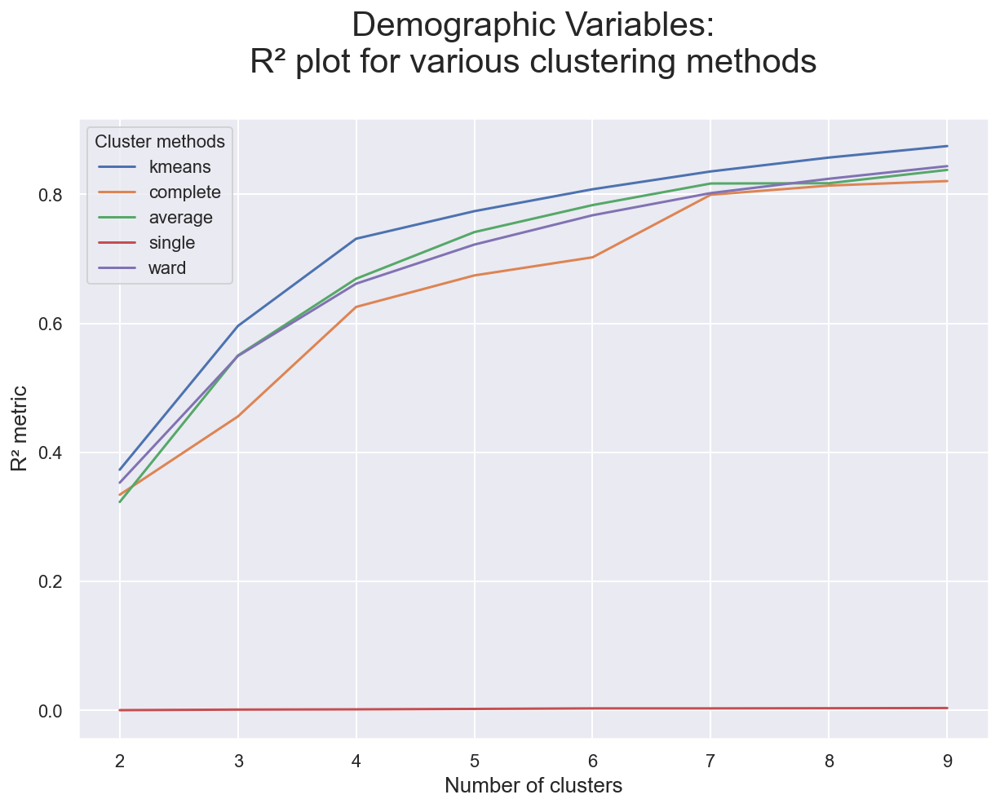

In [115]:
# Visualizing the R² scores for each cluster solution on demographic variables
pd.DataFrame(r2_scores).plot.line(figsize=(10,7))

plt.title("Demographic Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

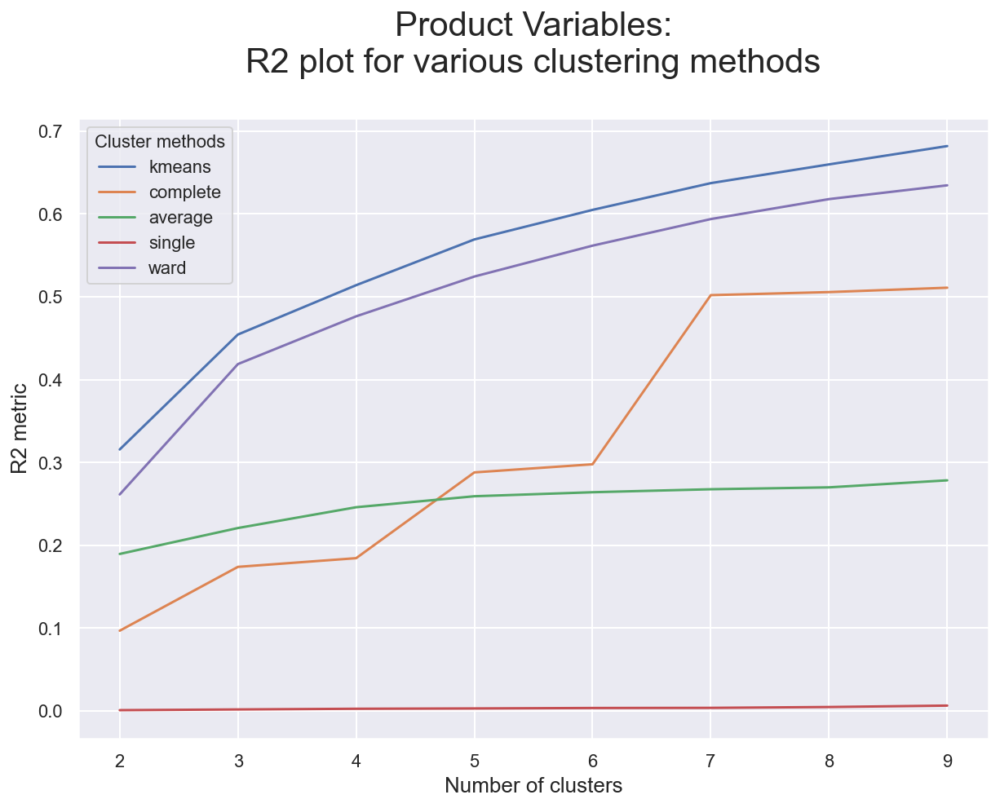

In [116]:
# Obtaining the R² scores for each cluster solution on product variables
r2_scores = {}
r2_scores['kmeans'] = get_r2_scores(df_prf, kmeans)

for linkage in ['complete', 'average', 'single', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_prf, hierarchical.set_params(linkage=linkage)
    )

# Visualizing the R² scores for each cluster solution on product variables
pd.DataFrame(r2_scores).plot.line(figsize=(10,7))

plt.title("Product Variables:\nR2 plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)
plt.show()

In [117]:
df_pk=df.copy()

In [118]:
# Applying the right clustering (algorithm and number of clusters) for each perspective
kmeans_prod = KMeans(
    n_clusters=4,
    init='k-means++',
    n_init=20,
    random_state=42
)
prod_labels = kmeans_prod.fit_predict(df_prf)

kmeans_behav = KMeans(
    n_clusters=5,
    init='k-means++',
    n_init=20,
    random_state=42
)
behavior_labels = kmeans_behav.fit_predict(df_dem)

df_pk['product_labels'] = prod_labels
df_pk['behavior_labels'] = behavior_labels

In [119]:
# Count label frequencies (contigency table)
df_pk.groupby(['product_labels', 'behavior_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('behavior_labels', 'product_labels', 0)

product_labels,0,1,2,3
behavior_labels,,,,
0,163,141,994,912
1,183,157,787,938
2,265,402,596,706
3,271,412,677,818
4,85,91,1073,530


In [120]:
# Clusters with low frequency to be merged:
to_merge = [(0,1), (1,1), (1,3), (2,1),(2,3),(3,2),(3,3),(4,2),(4,3)]  

df_centroids = df_pk.groupby(['behavior_labels', 'product_labels'])\
    [metric_features].mean()

# Computing the euclidean distance matrix between the centroids
euclidean = pairwise_distances(df_centroids)
df_dists = pd.DataFrame(
    euclidean, columns=df_centroids.index, index=df_centroids.index
)

# Merging each low frequency clustering (source) to the closest cluster (target)
source_target = {}
for clus in to_merge:
    if clus not in source_target.values():
        source_target[clus] = df_dists.loc[clus].sort_values().index[1]

source_target

{(0, 1): (4, 1),
 (1, 1): (4, 1),
 (1, 3): (4, 3),
 (2, 1): (3, 1),
 (2, 3): (4, 3),
 (3, 2): (0, 2),
 (3, 3): (4, 3),
 (4, 2): (2, 2)}

In [121]:
df_pk_ = df_pk.copy()

# Changing the behavior_labels and product_labels based on source_target
for source, target in source_target.items():
    mask = (df_pk_['behavior_labels']==source[0]) & (df_pk_['product_labels']==source[1])
    df_pk_.loc[mask, 'behavior_labels'] = target[0]
    df_pk_.loc[mask, 'product_labels'] = target[1]

# New contigency table
df_pk_.groupby(['product_labels', 'behavior_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('behavior_labels', 'product_labels', 0)

product_labels,0,1,2,3
behavior_labels,,,,
0,163.0,NaN,1671.0,912.0
1,183.0,NaN,787.0,NaN
2,265.0,NaN,1669.0,NaN
3,271.0,814.0,NaN,NaN
4,85.0,389.0,NaN,2992.0


In [122]:
df_centroids = df_pk_.groupby(['behavior_labels', 'product_labels'])\
    [metric_features].mean()
df_centroids=df_centroids.reset_index().reset_index().set_index(['behavior_labels','product_labels'])
cluster_mapper = df_centroids['index'].to_dict()

df_pk_['merged_labels'] = df_pk_.apply(
    lambda row: cluster_mapper[
        (row['behavior_labels'], row['product_labels'])
    ], axis=1
)
df_pk_

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0,product_labels,behavior_labels,merged_labels
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,1.0,0.0,0.0,0.0,0.0,0.0,1.0,2,2,6
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1,3,8
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0,4,9
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0.0,1.0,0.0,0.0,0.0,1.0,1.0,3,4,11
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0.0,1.0,0.0,0.0,0.0,1.0,1.0,3,4,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10290,-1.210141,-1.921507,-0.155643,-2.108298,3.003557,-0.865949,1.562040,3.549686,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1,3,8
10291,0.305801,0.697201,-0.862217,0.697648,-0.677948,0.081971,-0.672821,-0.557046,0.0,0.0,1.0,1.0,0.0,0.0,0.0,2,0,1
10293,-1.210141,0.421225,1.237874,0.769384,-0.307821,-0.341294,-0.610260,-0.774847,0.0,1.0,0.0,0.0,0.0,0.0,1.0,2,1,4
10294,0.760584,-0.546736,0.139975,-0.790370,0.040102,0.411355,0.498728,1.604010,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1,3,8


<div class="alert alert-block alert-info">

#### 3.4.2.  Clustering by Perspectives on KMeans, merging the labels by Hierarchical 

    
</div>

In [123]:
# Centroids of the concatenated cluster labels
df_centroids = df_pk.groupby(['behavior_labels', 'product_labels'])\
    [metric_features].mean()
df_centroids

member_age  MonthSal  CustMonVal  PremMotor  \
behavior_labels product_labels                                                
0               0                 0.893577  0.938688    1.458254  -0.708196   
                1                 1.088500  0.906825   -0.490386  -1.034638   
                2                 1.032508  0.672320   -0.006558   0.978758   
                3                 0.973946  1.046666   -0.252413  -0.383096   
1               0                -0.940088  1.067934    1.372051  -0.838981   
                1                -0.929161  1.105032   -0.318204  -1.067882   
                2                -1.047799  0.819606   -0.005264   0.954389   
                3                -0.916068  1.175292   -0.265199  -0.394091   
2               0                -0.933839 -1.223289    1.673929  -1.216651   
                1                -0.950696 -1.333788   -0.500001  -1.468280   
                2                -1.103211 -0.643606    0.037162   0.951759   
                3                -0.981032 -0.923705   -0.243237  -0.438752   
3               0                 0.877496 -1.273606    1.745786  -1.200015   
                1                 0.891205 -1.355912   -0.432829  -1.473642   
                2                 0.996014 -0.645607   -0.030641   0.954284   
                3                 0.899761 -0.979971   -0.236129  -0.412083   
4               0                -0.155045 -0.010897    1.434218  -0.616372   
                1                -0.115664  0.024036   -0.395153  -0.888339   
                2                -0.146241  0.014082    0.014928   1.050504   
                3                -0.125985  0.003950   -0.294200  -0.260088   

                                PremHousehold  PremHealth  PremLife  PremWork  
behavior_labels product_labels                                                 
0               0                    1.614608    0.002199  0.292241  0.317920  
                1                    0.556736    0.012340  1.264085  1.291996  
                2                   -0.547157   -0.835258 -0.536848 -0.537818  
                3                   -0.112200    0.850030 -0.066504 -0.051062  
1               0                    1.588734    0.176121  0.331784  0.410819  
                1                    0.534529   -0.010571  1.389349  1.356854  
                2                   -0.537230   -0.772197 -0.521007 -0.540459  
                3                   -0.114053    0.858775 -0.058965 -0.068856  
2               0                    1.971655    0.171664  0.683825  0.796235  
                1                    0.990732   -0.097104  1.880786  1.718320  
                2                   -0.601264   -0.724321 -0.578275 -0.582531  
                3                   -0.063577    0.903204 -0.064260 -0.004901  
3               0                    2.128189    0.021536  0.629598  0.938125  
                1                    1.002469   -0.087089  1.903462  1.731337  
                2                   -0.582320   -0.728002 -0.581990 -0.577404  
                3                   -0.109839    0.914275 -0.060204 -0.044882  
4               0                    1.494555   -0.200244  0.428868  0.282885  
                1                    0.657086   -0.266866  1.527990  1.014509  
                2                   -0.597407   -0.871674 -0.592245 -0.585064  
                3                   -0.206366    0.686326 -0.082981 -0.058015

In [124]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)
hclust_labels = hclust.fit_predict(df_centroids)

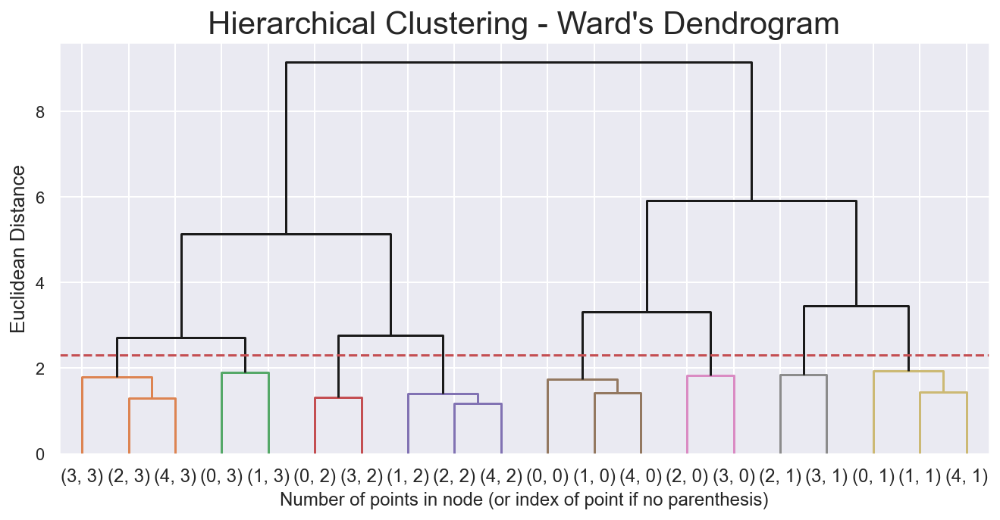

In [125]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 2.3
dendrogram(linkage_matrix, truncate_mode='level', labels=df_centroids.index, p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

In [126]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', # I use ward here!!!!!!
    affinity='euclidean', 
    n_clusters=8
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids  # centroid's cluster labels

member_age  MonthSal  CustMonVal  PremMotor  \
behavior_labels product_labels                                                
0               0                 0.893577  0.938688    1.458254  -0.708196   
                1                 1.088500  0.906825   -0.490386  -1.034638   
                2                 1.032508  0.672320   -0.006558   0.978758   
                3                 0.973946  1.046666   -0.252413  -0.383096   
1               0                -0.940088  1.067934    1.372051  -0.838981   
                1                -0.929161  1.105032   -0.318204  -1.067882   
                2                -1.047799  0.819606   -0.005264   0.954389   
                3                -0.916068  1.175292   -0.265199  -0.394091   
2               0                -0.933839 -1.223289    1.673929  -1.216651   
                1                -0.950696 -1.333788   -0.500001  -1.468280   
                2                -1.103211 -0.643606    0.037162   0.951759   
                3                -0.981032 -0.923705   -0.243237  -0.438752   
3               0                 0.877496 -1.273606    1.745786  -1.200015   
                1                 0.891205 -1.355912   -0.432829  -1.473642   
                2                 0.996014 -0.645607   -0.030641   0.954284   
                3                 0.899761 -0.979971   -0.236129  -0.412083   
4               0                -0.155045 -0.010897    1.434218  -0.616372   
                1                -0.115664  0.024036   -0.395153  -0.888339   
                2                -0.146241  0.014082    0.014928   1.050504   
                3                -0.125985  0.003950   -0.294200  -0.260088   

                                PremHousehold  PremHealth  PremLife  PremWork  \
behavior_labels product_labels                                                  
0               0                    1.614608    0.002199  0.292241  0.317920   
                1                    0.556736    0.012340  1.264085  1.291996   
                2                   -0.547157   -0.835258 -0.536848 -0.537818   
                3                   -0.112200    0.850030 -0.066504 -0.051062   
1               0                    1.588734    0.176121  0.331784  0.410819   
                1                    0.534529   -0.010571  1.389349  1.356854   
                2                   -0.537230   -0.772197 -0.521007 -0.540459   
                3                   -0.114053    0.858775 -0.058965 -0.068856   
2               0                    1.971655    0.171664  0.683825  0.796235   
                1                    0.990732   -0.097104  1.880786  1.718320   
                2                   -0.601264   -0.724321 -0.578275 -0.582531   
                3                   -0.063577    0.903204 -0.064260 -0.004901   
3               0                    2.128189    0.021536  0.629598  0.938125   
                1                    1.002469   -0.087089  1.903462  1.731337   
                2                   -0.582320   -0.728002 -0.581990 -0.577404   
                3                   -0.109839    0.914275 -0.060204 -0.044882   
4               0                    1.494555   -0.200244  0.428868  0.282885   
                1                    0.657086   -0.266866  1.527990  1.014509   
                2                   -0.597407   -0.871674 -0.592245 -0.585064   
                3                   -0.206366    0.686326 -0.082981 -0.058015   

                                hclust_labels  
behavior_labels product_labels                 
0               0                           5  
                1                           0  
                2                           6  
                3                           2  
1               0                           5  
                1                           0  
                2                           4  
                3                           2  
2               0             

In [127]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()

df_h = df_pk_.copy()

# Mapping the hierarchical clusters on the centroids to the observations
df_h['merged_labels'] = df_h.apply(
    lambda row: cluster_mapper[
        (row['behavior_labels'], row['product_labels'])
    ], axis=1
)

# Merged cluster centroids
df_h.groupby('merged_labels').mean()[metric_features]

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
merged_labels,,,,,,,,
0,-0.007520,0.780308,-0.398615,-1.013831,0.571249,-0.062223,1.376377,1.253259
1,-0.018432,-1.344986,-0.466002,-1.470994,0.996673,-0.092035,1.892263,1.724908
2,0.973946,1.046666,-0.252413,-0.383096,-0.112200,0.850030,-0.066504,-0.051062
3,-0.018034,-1.248729,1.710260,-1.208240,2.050798,0.095759,0.656408,0.867974
4,-0.667365,0.112602,0.013853,0.995742,-0.579060,-0.804039,-0.566027,-0.570156
5,-0.091791,0.806292,1.416912,-0.745618,1.579946,0.036120,0.335976,0.350455
6,1.017722,0.138366,-0.016315,0.968842,-0.561403,-0.791804,-0.555137,-0.553856
7,-0.295003,-0.116723,-0.257206,-0.385811,-0.117343,0.853885,-0.064807,-0.045290


In [128]:
#Merge cluster contigency table
# Getting size of each final cluster
df_counts = df_h.groupby('merged_labels')\
    .size()\
    .to_frame()

# Getting the product and behavior labels
df_counts = df_counts\
    .rename({v:k for k, v in cluster_mapper.items()})\
    .reset_index()

df_counts['behavior_labels'] = df_counts['merged_labels'].apply(lambda x: x[0])
df_counts['product_labels'] = df_counts['merged_labels'].apply(lambda x: x[1])
df_counts.pivot('behavior_labels', 'product_labels', 0)

product_labels,0,1,2,3
behavior_labels,,,,
1,NaN,NaN,NaN,912.0
3,536.0,814.0,1671.0,NaN
4,431.0,389.0,2456.0,2992.0


<div class="alert alert-block alert-info">

### 3.5. Self-organizing maps

    
</div>

<div class="alert alert-block alert-info">

#### 3.5.1. K-Means on top of SOM units

    
</div>


In [129]:
# This som implementation does not have a random seed parameter
# We're going to set it up ourselves
np.random.seed(42)

sm = sompy.SOMFactory().build(
    df[metric_features].values, 
    mapsize=(10, 10),  # NEEDS TO BE A LIST
    initialization='random', 
    neighborhood='gaussian',
    training='batch',
    lattice='hexa',
    component_names=metric_features
)
sm.train(n_job=4, verbose='info', train_rough_len=100, train_finetune_len=100)

 Training...
 random_initialization took: 0.001000 seconds
 Rough training...
 radius_ini: 4.000000 , radius_final: 1.000000, trainlen: 100

 epoch: 1 ---> elapsed time:  0.019000, quantization error: 2.787118

 epoch: 2 ---> elapsed time:  0.010000, quantization error: 2.596878

 epoch: 3 ---> elapsed time:  0.034000, quantization error: 2.515650

 epoch: 4 ---> elapsed time:  0.008000, quantization error: 2.501746

 epoch: 5 ---> elapsed time:  0.020000, quantization error: 2.483785

 epoch: 6 ---> elapsed time:  0.022000, quantization error: 2.478040

 epoch: 7 ---> elapsed time:  0.019000, quantization error: 2.472686

 epoch: 8 ---> elapsed time:  0.022000, quantization error: 2.466662

 epoch: 9 ---> elapsed time:  0.022000, quantization error: 2.460802

 epoch: 10 ---> elapsed time:  0.019000, quantization error: 2.457075

 epoch: 11 ---> elapsed time:  0.034000, quantization error: 2.454139

 epoch: 12 ---> elapsed time:  0.009000, quantization error: 2.451259

 epoch: 13 ---> 

 epoch: 14 ---> elapsed time:  0.018000, quantization error: 1.585504

 epoch: 15 ---> elapsed time:  0.018000, quantization error: 1.584457

 epoch: 16 ---> elapsed time:  0.035000, quantization error: 1.583774

 epoch: 17 ---> elapsed time:  0.005000, quantization error: 1.583196

 epoch: 18 ---> elapsed time:  0.017000, quantization error: 1.582825

 epoch: 19 ---> elapsed time:  0.019000, quantization error: 1.582661

 epoch: 20 ---> elapsed time:  0.017000, quantization error: 1.582483

 epoch: 21 ---> elapsed time:  0.035000, quantization error: 1.582271

 epoch: 22 ---> elapsed time:  0.005000, quantization error: 1.582063

 epoch: 23 ---> elapsed time:  0.017000, quantization error: 1.581756

 epoch: 24 ---> elapsed time:  0.034000, quantization error: 1.581326

 epoch: 25 ---> elapsed time:  0.022000, quantization error: 1.581084

 epoch: 26 ---> elapsed time:  0.021000, quantization error: 1.581002

 epoch: 27 ---> elapsed time:  0.004000, quantization error: 1.580953

 epoch

C:\Users\bayaz\anaconda3\envs\dmdsaa1\lib\site-packages\sompy\visualization\plot_tools.py:45: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  ax = fig.add_subplot(shape[0], shape[1], comp + 1, aspect='equal')


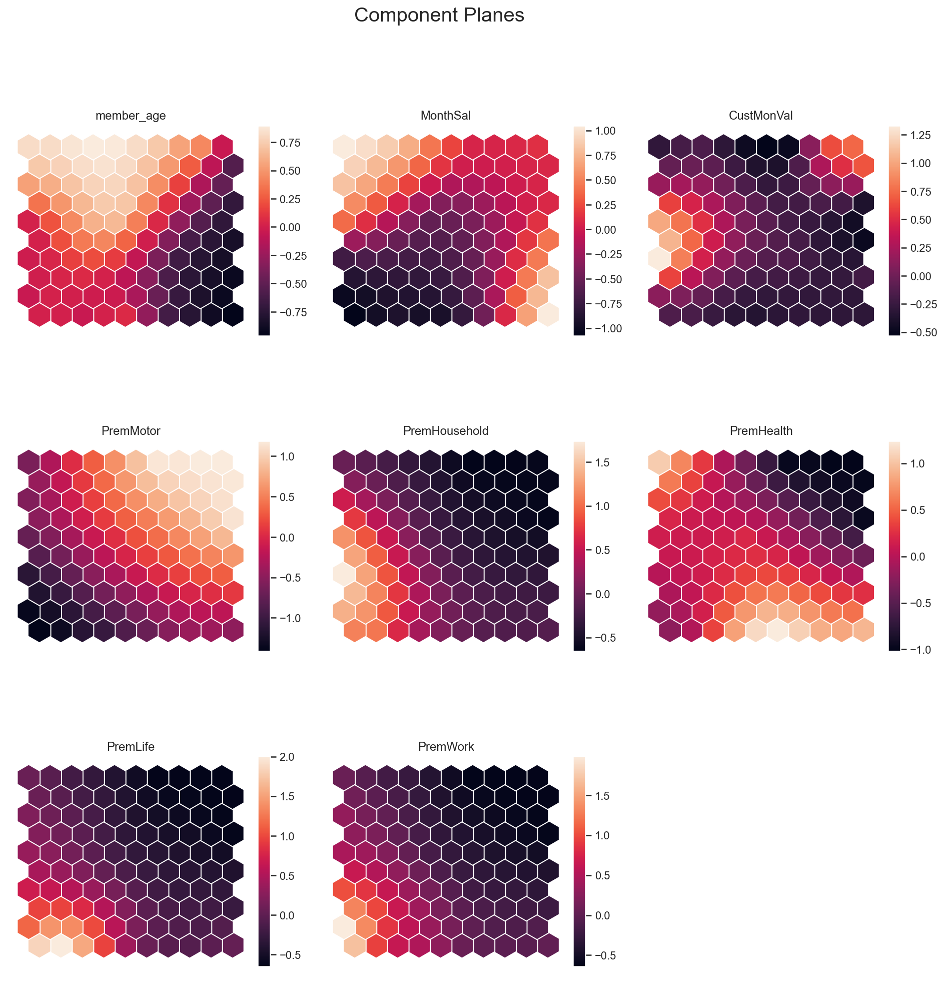

In [130]:
# Component planes on the 50x50 grid
sns.set()
view2D = View2D(12,12,"", text_size=10)
view2D.show(sm, col_sz=3, what='codebook')
plt.subplots_adjust(top=0.90)
plt.suptitle("Component Planes", fontsize=20)
plt.show()

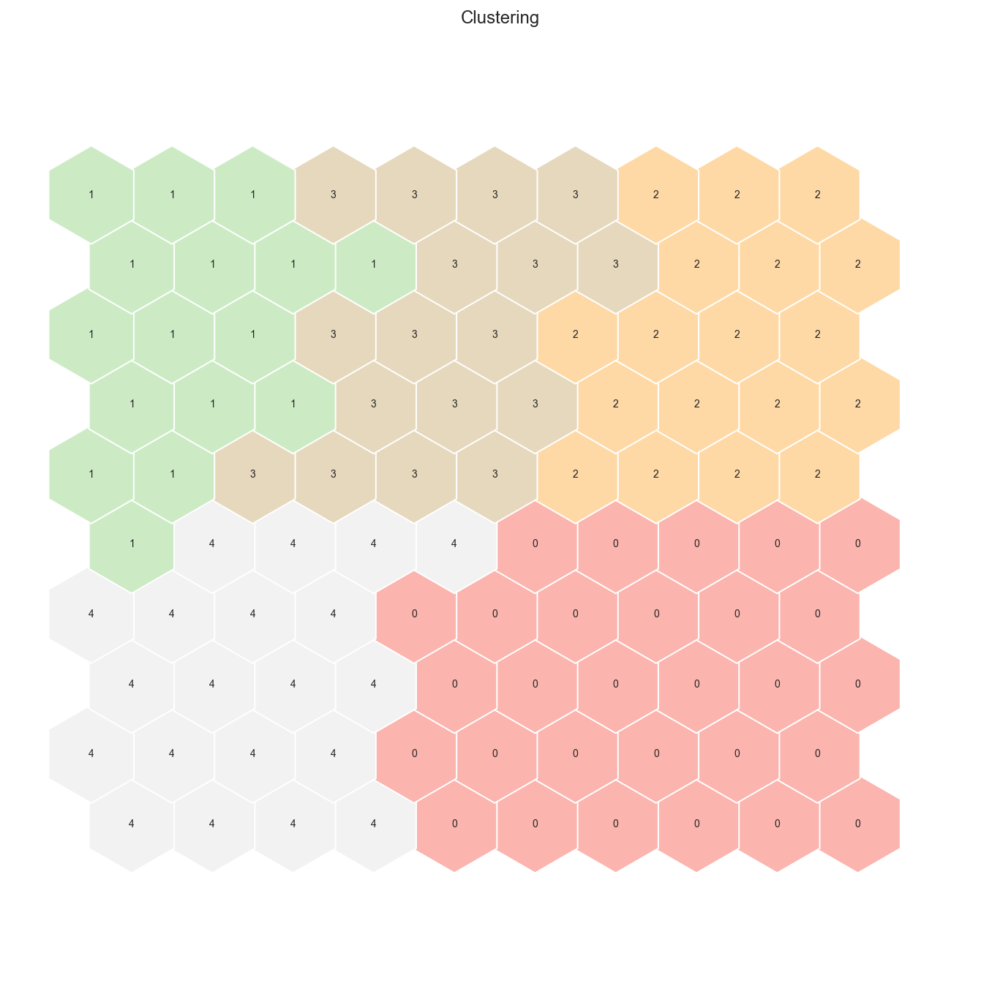

In [131]:
# Perform K-Means clustering on top of the 2500 untis (sm.get_node_vectors() output)
kmeans = KMeans(5, init='k-means++',max_iter=2000, n_init=10, random_state=3)
nodeclus_labels = kmeans.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels  # setting the cluster labels of sompy

hits = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

In [132]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

df_knodes = pd.DataFrame(nodes, columns=metric_features)
df_knodes['label'] = nodeclus_labels
df_knodes

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,label
0,-0.040363,0.124182,0.738483,1.187561,-0.625354,-1.018200,-0.647326,-0.631008,0
1,0.437334,0.082648,0.634557,1.190011,-0.644085,-1.013065,-0.651031,-0.641631,0
2,0.556390,0.056116,0.110775,1.149751,-0.648249,-0.966845,-0.636296,-0.632634,0
3,0.728950,0.061608,-0.475312,1.151218,-0.654475,-0.969905,-0.635839,-0.635804,0
4,0.824888,0.228341,-0.531128,0.899016,-0.563819,-0.685843,-0.533381,-0.529476,0
...,...,...,...,...,...,...,...,...,...
95,0.057742,-0.928380,-0.352002,-0.873701,0.130348,1.130499,0.392237,0.293835,3
96,0.012597,-0.951046,-0.320398,-1.028851,0.333533,0.810412,0.962826,0.497687,3
97,-0.042213,-0.905911,-0.250764,-1.128947,0.651398,0.353625,1.541260,0.639281,1
98,0.007631,-0.963071,-0.171063,-1.311960,1.055816,-0.022459,2.003942,0.949130,1


In [133]:
# Obtaining SOM's BMUs labels
bmus_map = sm.find_bmu(df[metric_features])[0]  # get bmus for each observation in df

df_bmusk = pd.DataFrame(
    np.concatenate((df, np.expand_dims(bmus_map,1)), axis=1),
    index=df.index, columns=np.append(df.columns,"BMU")
)
df_bmusk

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0,BMU
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,1.0,0.0,0.0,0.0,0.0,0.0,1.0,43.0
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1.0,0.0,0.0,0.0,0.0,1.0,1.0,99.0
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0.0,0.0,0.0,0.0,1.0,0.0,0.0,68.0
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0.0,1.0,0.0,0.0,0.0,1.0,1.0,94.0
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0.0,1.0,0.0,0.0,0.0,1.0,1.0,43.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10290,-1.210141,-1.921507,-0.155643,-2.108298,3.003557,-0.865949,1.562040,3.549686,0.0,0.0,0.0,0.0,1.0,0.0,1.0,89.0
10291,0.305801,0.697201,-0.862217,0.697648,-0.677948,0.081971,-0.672821,-0.557046,0.0,0.0,1.0,1.0,0.0,0.0,0.0,5.0
10293,-1.210141,0.421225,1.237874,0.769384,-0.307821,-0.341294,-0.610260,-0.774847,0.0,1.0,0.0,0.0,0.0,0.0,1.0,10.0
10294,0.760584,-0.546736,0.139975,-0.790370,0.040102,0.411355,0.498728,1.604010,0.0,0.0,0.0,1.0,0.0,0.0,1.0,77.0


In [134]:
# Get cluster labels for each observation
df_SOMk = df_bmusk.merge(df_knodes['label'], 'left', left_on="BMU", right_index=True)
df_SOMk

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0,BMU,label
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,1.0,0.0,0.0,0.0,0.0,0.0,1.0,43.0,0
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1.0,0.0,0.0,0.0,0.0,1.0,1.0,99.0,1
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0.0,0.0,0.0,0.0,1.0,0.0,0.0,68.0,1
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0.0,1.0,0.0,0.0,0.0,1.0,1.0,94.0,3
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0.0,1.0,0.0,0.0,0.0,1.0,1.0,43.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10290,-1.210141,-1.921507,-0.155643,-2.108298,3.003557,-0.865949,1.562040,3.549686,0.0,0.0,0.0,0.0,1.0,0.0,1.0,89.0,1
10291,0.305801,0.697201,-0.862217,0.697648,-0.677948,0.081971,-0.672821,-0.557046,0.0,0.0,1.0,1.0,0.0,0.0,0.0,5.0,0
10293,-1.210141,0.421225,1.237874,0.769384,-0.307821,-0.341294,-0.610260,-0.774847,0.0,1.0,0.0,0.0,0.0,0.0,1.0,10.0,0
10294,0.760584,-0.546736,0.139975,-0.790370,0.040102,0.411355,0.498728,1.604010,0.0,0.0,0.0,1.0,0.0,0.0,1.0,77.0,1


<div class="alert alert-block alert-info">

#### 3.5.2. Hierarchical Clustering on top of SOM units

    
</div>


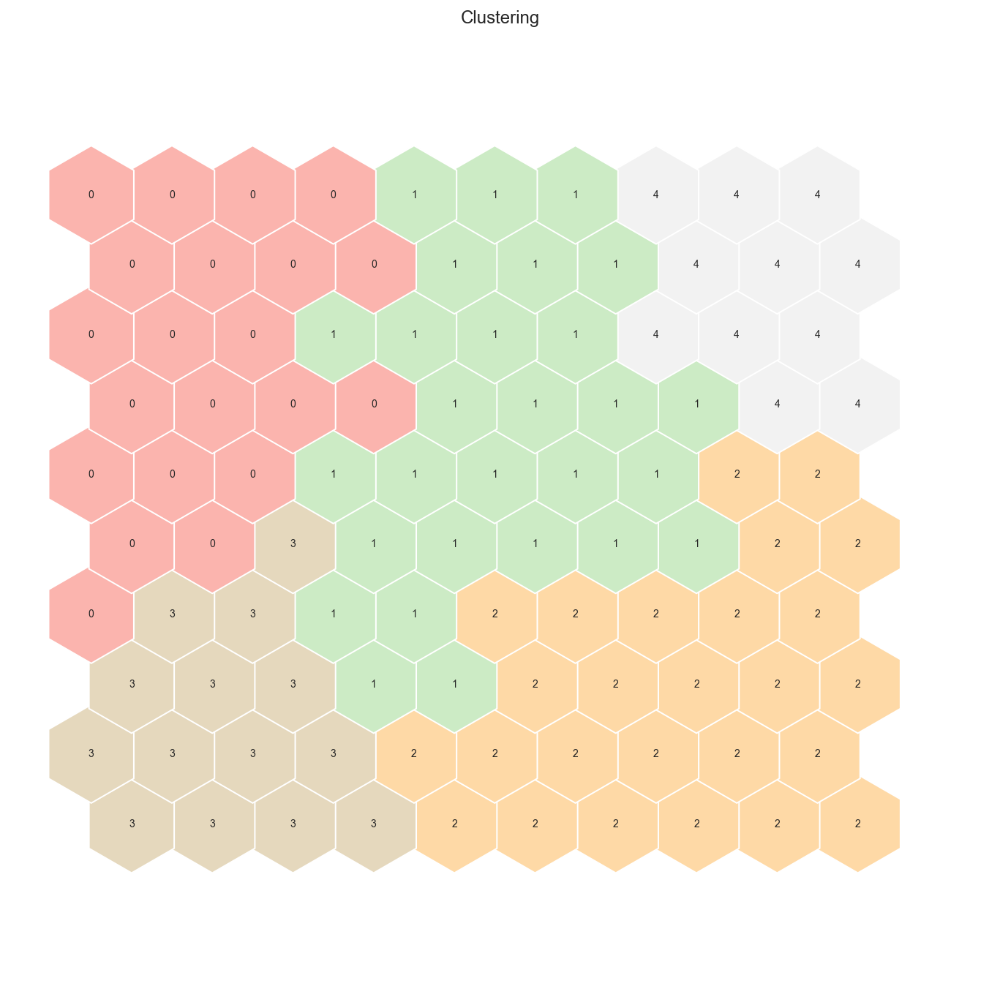

In [135]:
# Perform Hierarchical clustering on top of the 2500 untis (sm.get_node_vectors() output)
hierclust = AgglomerativeClustering(n_clusters=5, linkage='ward',affinity= "euclidean")
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels  # setting the cluster labels of sompy

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

In [136]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

df_hnodes = pd.DataFrame(nodes, columns=metric_features)
df_hnodes['label'] = nodeclus_labels
df_hnodes

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,label
0,-0.040363,0.124182,0.738483,1.187561,-0.625354,-1.018200,-0.647326,-0.631008,2
1,0.437334,0.082648,0.634557,1.190011,-0.644085,-1.013065,-0.651031,-0.641631,2
2,0.556390,0.056116,0.110775,1.149751,-0.648249,-0.966845,-0.636296,-0.632634,2
3,0.728950,0.061608,-0.475312,1.151218,-0.654475,-0.969905,-0.635839,-0.635804,2
4,0.824888,0.228341,-0.531128,0.899016,-0.563819,-0.685843,-0.533381,-0.529476,2
...,...,...,...,...,...,...,...,...,...
95,0.057742,-0.928380,-0.352002,-0.873701,0.130348,1.130499,0.392237,0.293835,1
96,0.012597,-0.951046,-0.320398,-1.028851,0.333533,0.810412,0.962826,0.497687,0
97,-0.042213,-0.905911,-0.250764,-1.128947,0.651398,0.353625,1.541260,0.639281,0
98,0.007631,-0.963071,-0.171063,-1.311960,1.055816,-0.022459,2.003942,0.949130,0


In [137]:
# Obtaining SOM's BMUs labels
bmus_map = sm.find_bmu(df[metric_features])[0]  # get bmus for each observation in df

df_bmush = pd.DataFrame(
    np.concatenate((df, np.expand_dims(bmus_map,1)), axis=1),
    index=df.index, columns=np.append(df.columns,"BMU")
)
df_bmush

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0,BMU
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,1.0,0.0,0.0,0.0,0.0,0.0,1.0,43.0
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1.0,0.0,0.0,0.0,0.0,1.0,1.0,99.0
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0.0,0.0,0.0,0.0,1.0,0.0,0.0,68.0
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0.0,1.0,0.0,0.0,0.0,1.0,1.0,94.0
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0.0,1.0,0.0,0.0,0.0,1.0,1.0,43.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10290,-1.210141,-1.921507,-0.155643,-2.108298,3.003557,-0.865949,1.562040,3.549686,0.0,0.0,0.0,0.0,1.0,0.0,1.0,89.0
10291,0.305801,0.697201,-0.862217,0.697648,-0.677948,0.081971,-0.672821,-0.557046,0.0,0.0,1.0,1.0,0.0,0.0,0.0,5.0
10293,-1.210141,0.421225,1.237874,0.769384,-0.307821,-0.341294,-0.610260,-0.774847,0.0,1.0,0.0,0.0,0.0,0.0,1.0,10.0
10294,0.760584,-0.546736,0.139975,-0.790370,0.040102,0.411355,0.498728,1.604010,0.0,0.0,0.0,1.0,0.0,0.0,1.0,77.0


In [138]:
# Get cluster labels for each observation
df_SOMh = df_bmush.merge(df_hnodes['label'], 'left', left_on="BMU", right_index=True)
df_SOMh

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0,BMU,label
0,0.154207,-0.336177,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,1.0,0.0,0.0,0.0,0.0,0.0,1.0,43.0,1
1,0.760584,-1.869378,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1.0,0.0,0.0,0.0,0.0,1.0,1.0,99.0,0
2,-0.755359,-0.233963,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0.0,0.0,0.0,0.0,1.0,0.0,0.0,68.0,0
3,-0.603764,-1.438037,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,0.0,1.0,0.0,0.0,0.0,1.0,1.0,94.0,1
4,0.002613,-0.759340,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,0.0,1.0,0.0,0.0,0.0,1.0,1.0,43.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10290,-1.210141,-1.921507,-0.155643,-2.108298,3.003557,-0.865949,1.562040,3.549686,0.0,0.0,0.0,0.0,1.0,0.0,1.0,89.0,0
10291,0.305801,0.697201,-0.862217,0.697648,-0.677948,0.081971,-0.672821,-0.557046,0.0,0.0,1.0,1.0,0.0,0.0,0.0,5.0,2
10293,-1.210141,0.421225,1.237874,0.769384,-0.307821,-0.341294,-0.610260,-0.774847,0.0,1.0,0.0,0.0,0.0,0.0,1.0,10.0,2
10294,0.760584,-0.546736,0.139975,-0.790370,0.040102,0.411355,0.498728,1.604010,0.0,0.0,0.0,1.0,0.0,0.0,1.0,77.0,0


<div class="alert alert-block alert-info">

### 3.6. K-prototype Cluster Algorithm

    
</div>

In [139]:
df_kprototype=df_standard.copy()
df_kprototype['GeoLivArea']=df_kprototype['GeoLivArea'].replace([1,2,3,4],['a','b','c','d'])
df_kprototype['Children']=df_kprototype['Children'].replace([0,1],['a','b'])
df_kprototype

,member_age,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
0,0.154207,b'2 - High School',-0.336177,a,b,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579
1,0.760584,b'2 - High School',-1.869378,d,b,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698
2,-0.755359,b'1 - Basic',-0.233963,c,a,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119
3,-0.603764,b'3 - BSc/MSc',-1.438037,d,b,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423
4,0.002613,b'3 - BSc/MSc',-0.759340,d,b,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291
...,...,...,...,...,...,...,...,...,...,...,...
10290,-1.210141,b'1 - Basic',-1.921507,c,b,-0.155643,-2.108298,3.003557,-0.865949,1.562040,3.549686
10291,0.305801,b'4 - PhD',0.697201,b,a,-0.862217,0.697648,-0.677948,0.081971,-0.672821,-0.557046
10293,-1.210141,b'3 - BSc/MSc',0.421225,a,b,1.237874,0.769384,-0.307821,-0.341294,-0.610260,-0.774847
10294,0.760584,b'1 - Basic',-0.546736,b,b,0.139975,-0.790370,0.040102,0.411355,0.498728,1.604010


In [140]:
# Get the position of categorical columns
catColumnsPos = [df_kprototype.columns.get_loc(col) for col in list(df_kprototype.select_dtypes('object').columns)]
print('Categorical columns           : {}'.format(list(df_kprototype.select_dtypes('object').columns)))
print('Categorical columns position  : {}'.format(catColumnsPos))

Categorical columns           : ['EducDeg', 'GeoLivArea', 'Children']
Categorical columns position  : [1, 3, 4]


In [141]:
dfMatrix = df_kprototype.to_numpy()

In [142]:
dfMatrix

array([[0.15420673775281576, b'2 - High School', -0.33617659273736833,
        ..., -0.2861730389867721, 0.1331060035791322,
        -0.5105788384432836],
       [0.760583629209325, b'2 - High School', -1.8693776688890984, ...,
        -0.6840901609770507, 3.3254236774563704, 1.4546978833072035],
       [-0.7553585994319479, b'1 - Basic', -0.23396318766058635, ...,
        -0.5782739799017794, 0.9847082093859442, 1.298118798909557],
       ...,
       [-1.2101412680243298, b'3 - BSc/MSc', 0.4212247388815863, ...,
        -0.34129401544043064, -0.6102600296543685, -0.7748473353169483],
       [0.760583629209325, b'1 - Basic', -0.5467362071955393, ...,
        0.4113554246031967, 0.49872779453177724, 1.6040095840408242],
       [-0.6037643765678207, b'4 - PhD', 0.3159449316525008, ...,
        -0.3547054452345081, -0.7353810451491163, -0.5986683374011718]],
      dtype=object)

In [143]:
# Choosing optimal K
from kmodes.kprototypes import KPrototypes
cost = []
for cluster in range(1, 10):
    try:
        kprototype = KPrototypes(n_jobs = -1, n_clusters = cluster, init = 'Huang', random_state = 0)
        kprototype.fit_predict(dfMatrix, categorical = catColumnsPos)
        cost.append(kprototype.cost_)
        print('Cluster initiation: {}'.format(cluster))
    except:
        break

Cluster initiation: 1
Cluster initiation: 2
Cluster initiation: 3
Cluster initiation: 4
Cluster initiation: 5
Cluster initiation: 6
Cluster initiation: 7
Cluster initiation: 8
Cluster initiation: 9


In [144]:
# Converting the results into a dataframe and plotting them
df_cost = pd.DataFrame({'Cluster':range(1, 10), 'Cost':cost})
df_cost

,Cluster,Cost
0,1,88846.000000
1,2,68740.882883
2,3,59522.096181
3,4,54859.009774
4,5,51441.509856
5,6,48221.653041
6,7,46141.596034
7,8,44176.809682
8,9,42454.262923


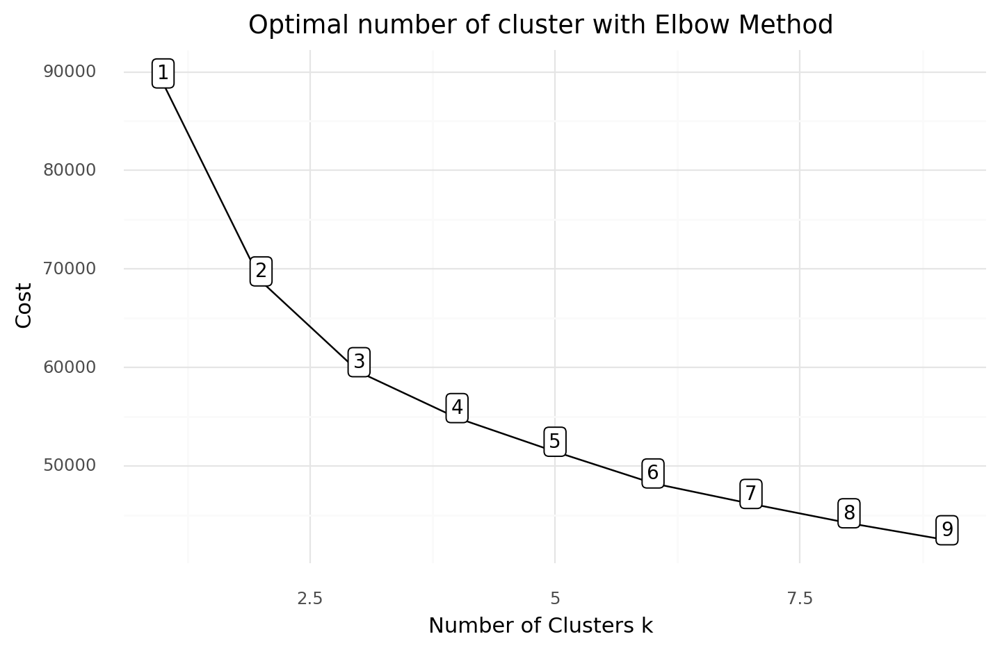

<ggplot: (149452239086)>

In [145]:
# Import module for data visualization
# !pip install plotnine
from plotnine import *
import plotnine
plotnine.options.figure_size = (8, 4.8)
(
    ggplot(data = df_cost)+
    geom_line(aes(x = 'Cluster',
                  y = 'Cost'))+
    geom_point(aes(x = 'Cluster',
                   y = 'Cost'))+
    geom_label(aes(x = 'Cluster',
                   y = 'Cost',
                   label = 'Cluster'),
               size = 10,
               nudge_y = 1000) +
    labs(title = 'Optimal number of cluster with Elbow Method')+
    xlab('Number of Clusters k')+
    ylab('Cost')+
    theme_minimal()
)

In [146]:
# Fit the cluster
kprototype = KPrototypes(n_jobs = -1, n_clusters = 5, init = 'Huang', random_state = 0)
kprototype.fit_predict(dfMatrix, categorical = catColumnsPos)

array([4, 1, 0, ..., 4, 3, 4], dtype=uint16)

In [147]:
# Cluster centorid
kprototype.cluster_centroids_

array([['-0.08810959477380977', '-0.4660778442241602',
        '1.7966837429185347', '-1.0675021780008316', '1.940951235824145',
        '0.016502364968835056', '0.5744972997212057',
        '0.7529180190803668', '2 - High School', 'd', 'b'],
       ['-0.02306318005888695', '-1.0443418515284904',
        '-0.422788734295972', '-1.4264022258790798',
        '1.0178764353665177', '-0.16064436842968907',
        '1.8979407065847702', '1.6754753169796044', '1 - Basic', 'd',
        'b'],
       ['-0.034432899833163666', '1.1263533210919578',
        '-0.19909792137906468', '-0.3734165684807748',
        '-0.01642305248156668', '0.675815141682925',
        '0.031393116494818185', '0.018999318774560705', '3 - BSc/MSc',
        'd', 'a'],
       ['0.05359882242091302', '-0.8127716136624701',
        '-0.23995301875585437', '-0.36184665747537376',
        '-0.10541193668869815', '0.8029406714123185',
        '-0.08077208876667466', '-0.027674862147988692', '3 - BSc/MSc',
        'd', 'b'],
   

In [148]:
# Check the cost of the clusters created
kprototype.cost_

51441.509856112374

In [149]:
# Add the cluster to the dataframe
df_kprototype['labels'] = kprototype.labels_ 

In [150]:
df_kprototype

,member_age,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,labels
0,0.154207,b'2 - High School',-0.336177,a,b,0.664467,0.567887,-0.544729,-0.286173,0.133106,-0.510579,4
1,0.760584,b'2 - High School',-1.869378,d,b,-1.387109,-1.596431,0.950653,-0.684090,3.325424,1.454698,1
2,-0.755359,b'1 - Basic',-0.233963,c,a,1.160034,-0.663002,0.099384,-0.578274,0.984708,1.298119,0
3,-0.603764,b'3 - BSc/MSc',-1.438037,d,b,-0.929841,-0.834688,-0.705036,1.924165,-0.119517,-0.258423,3
4,0.002613,b'3 - BSc/MSc',-0.759340,d,b,-0.720638,0.297846,-0.685275,0.199723,-0.477995,0.030291,3
...,...,...,...,...,...,...,...,...,...,...,...,...
10290,-1.210141,b'1 - Basic',-1.921507,c,b,-0.155643,-2.108298,3.003557,-0.865949,1.562040,3.549686,1
10291,0.305801,b'4 - PhD',0.697201,b,a,-0.862217,0.697648,-0.677948,0.081971,-0.672821,-0.557046,4
10293,-1.210141,b'3 - BSc/MSc',0.421225,a,b,1.237874,0.769384,-0.307821,-0.341294,-0.610260,-0.774847,4
10294,0.760584,b'1 - Basic',-0.546736,b,b,0.139975,-0.790370,0.040102,0.411355,0.498728,1.604010,3


<div class="alert alert-block alert-success">

## 4. Cluster Analysis
    
</div>

In [151]:
def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=28, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=28)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=28)
    
    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profilling", fontsize=23)
    plt.show()

In [152]:
# using R²
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df[metric_features])  # get total sum of squares
    ssw_labels = df[metric_features.to_list() + labels].groupby(by=labels).apply(get_ss)  # compute ssw for each cluster labels
    ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
    r2 = ssb / sst
    return r2

<div class="alert alert-block alert-info">

### 4.1 Cluster Analysis for different modes

    
</div>

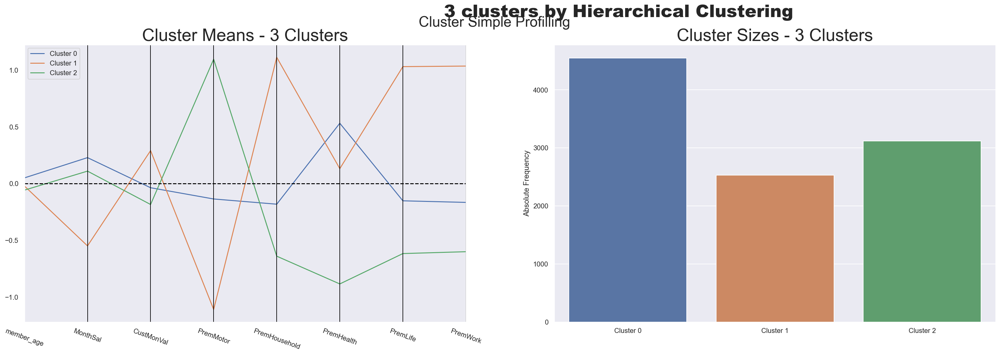

In [153]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_hc3[metric_features.to_list() + ['labels']], 
    label_columns = ['labels'], 
    figsize = (28, 8), 
    compar_titles = ["3 clusters by Hierarchical Clustering"]
)

In [154]:
r2(df_hc3,['labels'])

0.3018720325674947

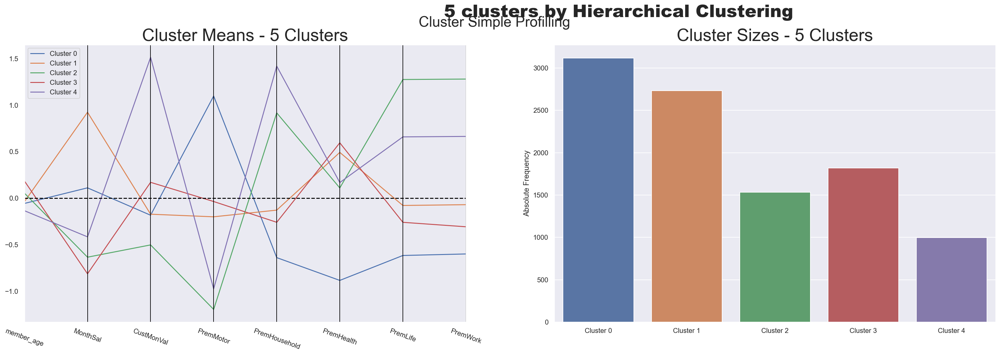

In [155]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_hc5[metric_features.to_list() + ['labels']], 
    label_columns = ['labels'], 
    figsize = (28, 8), 
    compar_titles = ["5 clusters by Hierarchical Clustering"]
)

In [156]:
r2(df_hc5,['labels'])

0.3849699478970555

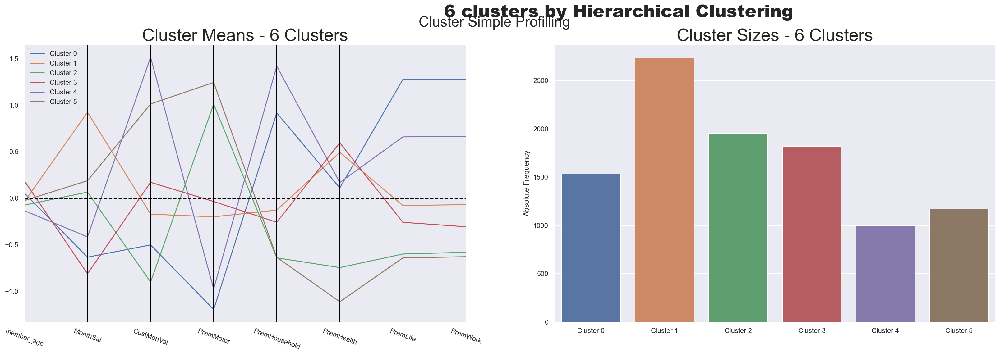

In [157]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_hc6[metric_features.to_list() + ['labels']], 
    label_columns = ['labels'], 
    figsize = (28, 8), 
    compar_titles = ["6 clusters by Hierarchical Clustering"]
)

In [158]:
r2(df_hc6,['labels'])

0.41966640789170234

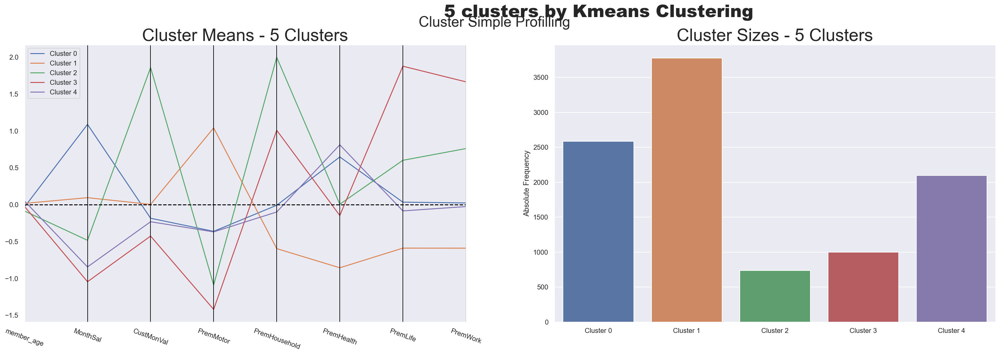

In [159]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_km[metric_features.to_list() + ['labels']], 
    label_columns = ['labels'], 
    figsize = (28, 8), 
    compar_titles = ["5 clusters by Kmeans Clustering"]
)

In [160]:
r2(df_km,['labels'])

0.44831835579389046

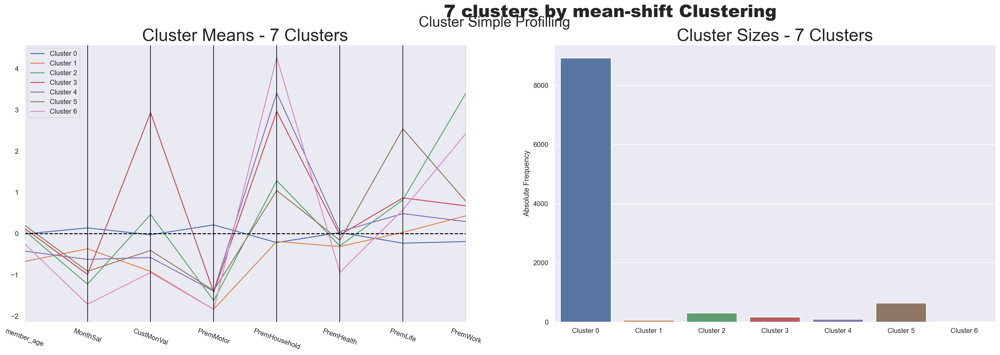

In [161]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_DCms[metric_features.to_list() + ['ms_labels']], 
    label_columns = ['ms_labels'], 
    figsize = (28, 8), 
    compar_titles = ["7 clusters by mean-shift Clustering"]
)

In [162]:
r2(df_DCms,['ms_labels'])

0.24912372054343795

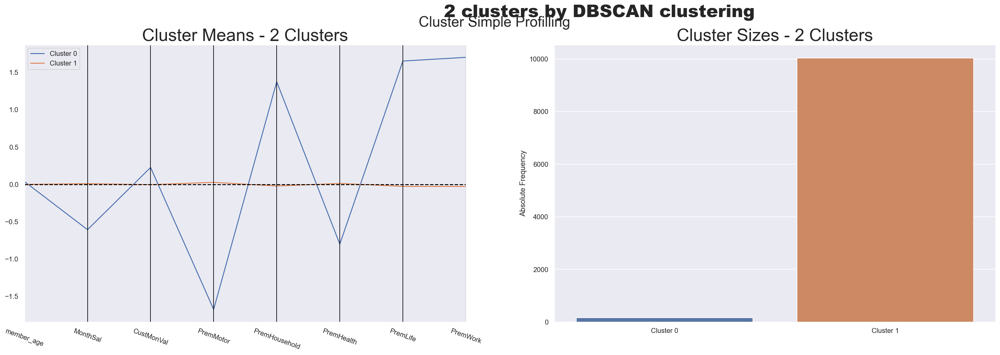

In [163]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_DCdb[metric_features.to_list() + ['dbscan_labels']], 
    label_columns = ['dbscan_labels'], 
    figsize = (28, 8), 
    compar_titles = ["2 clusters by DBSCAN clustering"]
)

In [164]:
r2(df_DCdb,['dbscan_labels'])

0.023097409570381717

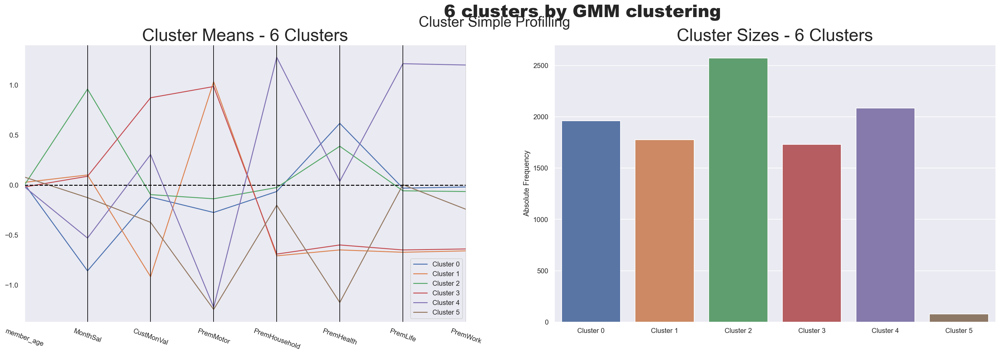

In [165]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_DCgmm[metric_features.to_list() + ['gmm_labels']], 
    label_columns = ['gmm_labels'], 
    figsize = (28, 8), 
    compar_titles = ["6 clusters by GMM clustering"]
)

In [166]:
r2(df_DCgmm,['gmm_labels'])

0.38329215348770707

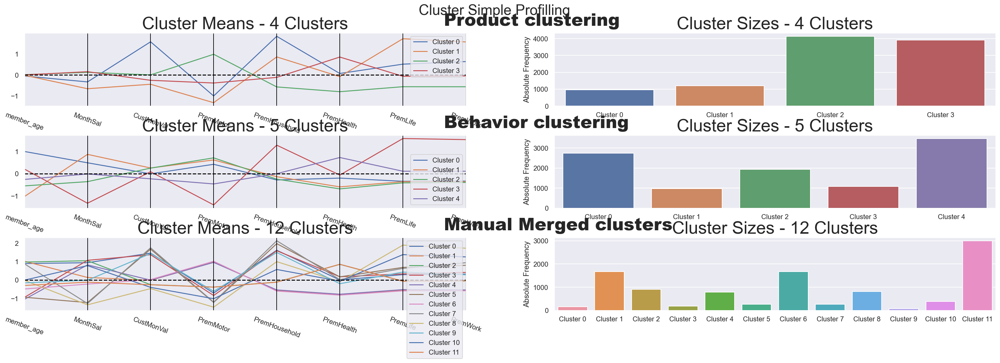

In [167]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_pk_[metric_features.to_list() + ['product_labels', 'behavior_labels', 'merged_labels']], 
    label_columns = ['product_labels', 'behavior_labels', 'merged_labels'], 
    figsize = (28, 8), 
    compar_titles = ["Product clustering", "Behavior clustering", "Manual Merged clusters"]
)

In [168]:
r2(df_pk_,['merged_labels'])

0.5070316922309446

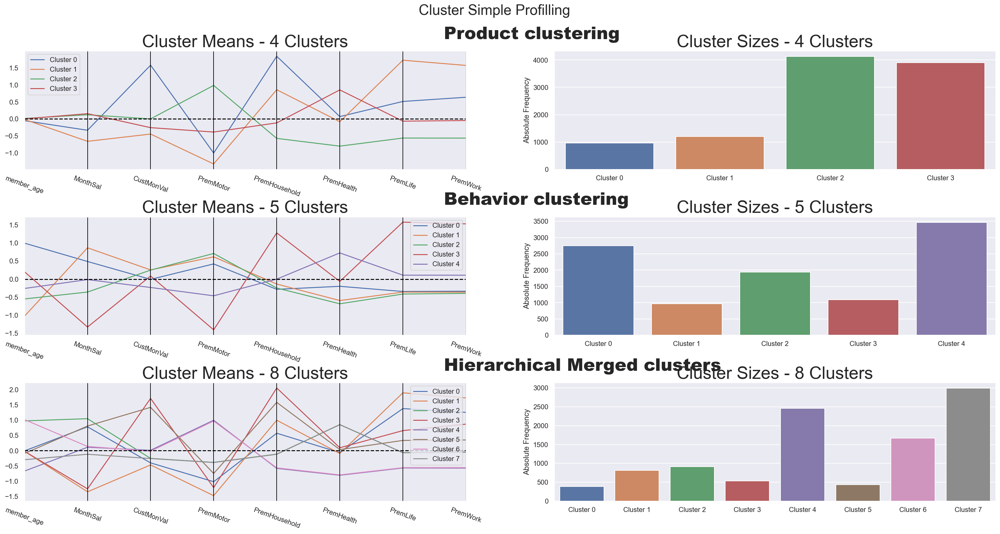

In [169]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_h[metric_features.to_list() + ['product_labels', 'behavior_labels', 'merged_labels']], 
    label_columns = ['product_labels', 'behavior_labels', 'merged_labels'], 
    figsize = (28, 13), 
    compar_titles = ["Product clustering", "Behavior clustering", "Hierarchical Merged clusters"]
)

In [170]:
r2(df_h,['merged_labels'])

0.4876278873522656

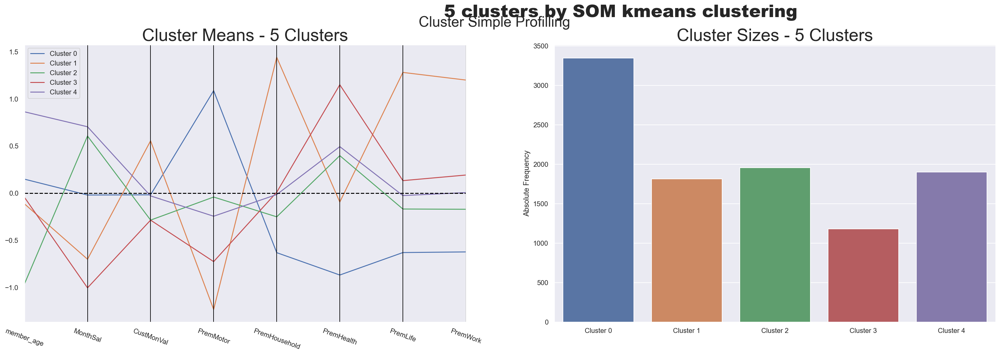

In [171]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_SOMk[metric_features.to_list() + ['label']], 
    label_columns = ['label'], 
    figsize = (28, 8), 
    compar_titles = ["5 clusters by SOM kmeans clustering"]
)

In [172]:
r2(df_SOMk,['label'])

0.4150240468287592

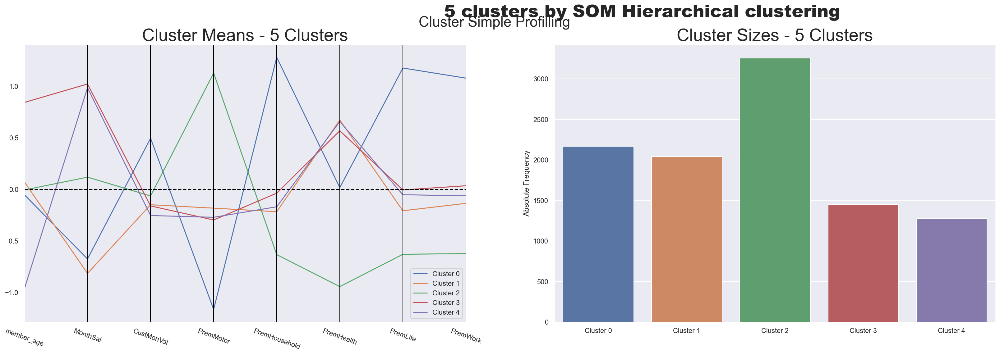

In [173]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_SOMh[metric_features.to_list() + ['label']], 
    label_columns = ['label'], 
    figsize = (28, 8), 
    compar_titles = ["5 clusters by SOM Hierarchical clustering"]
)

In [174]:
r2(df_SOMh,['label'])

0.4103112873209755

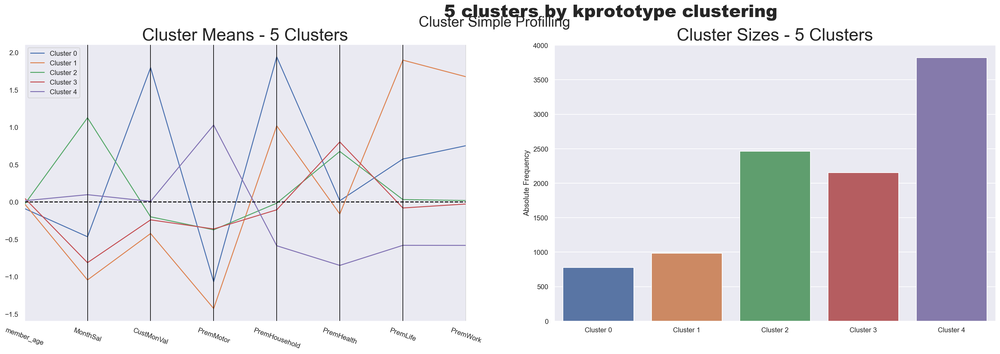

In [175]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df = df_kprototype[metric_features.to_list() + ['labels']], 
    label_columns = ['labels'], 
    figsize = (28, 8), 
    compar_titles = ["5 clusters by kprototype clustering"]
)

In [176]:
r2(df_kprototype,['labels'])

0.44737023507361484

<div class="alert alert-block alert-success">

## 5. Final cluters : K-Prototype clustering
    
</div>

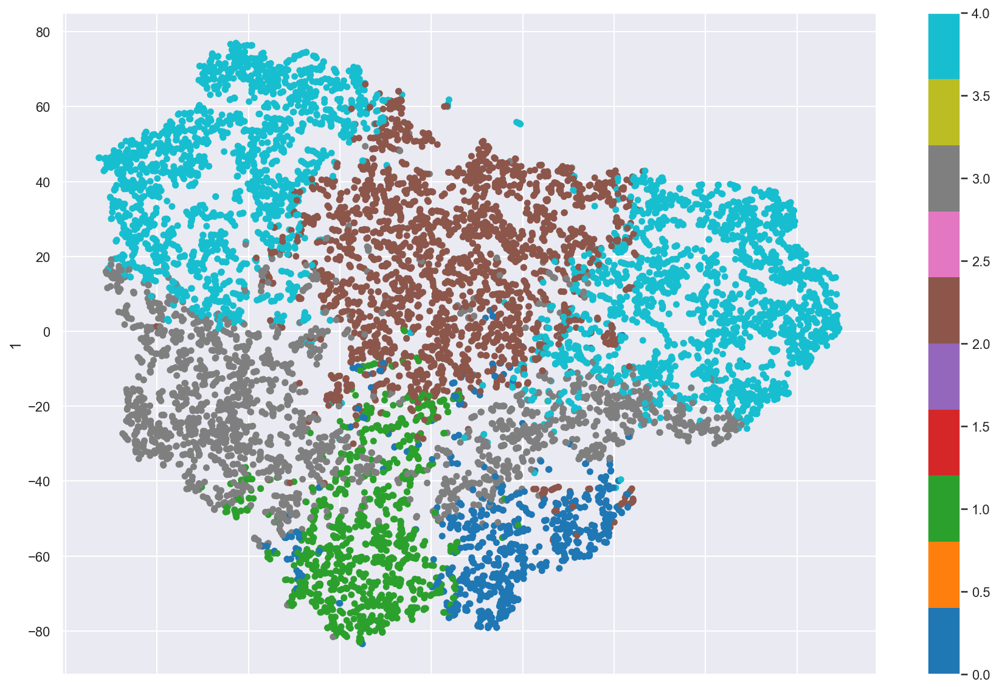

In [177]:
# t-SNE visualization for 5 clusters by K-Prototype Clustering
two_dim = TSNE(random_state=42).fit_transform(df_kprototype[metric_features])
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=df_kprototype['labels'], colormap='tab10', figsize=(15,10))
plt.show()

Text(0.5, 1.0, 'UMAP projection of the 5 clusters by K-Prototype Clustering')

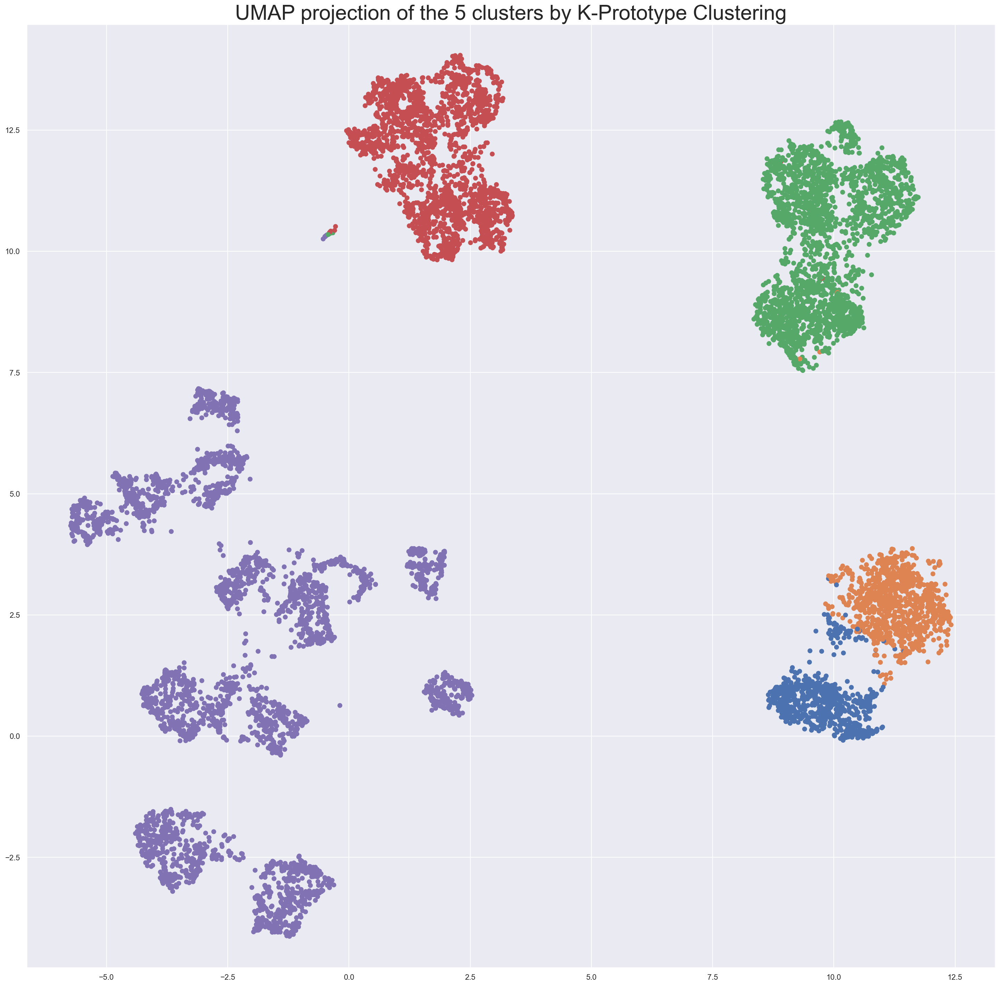

In [178]:
import umap.umap_ as umap
# UMAP visualization for 5 clusters by K -Prototype Clusterin

# Use OneHotEncoder to encode the categorical features. Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_feat = ohc.fit_transform(df_kprototype[['EducDeg','GeoLivArea','Children']])
ohc_feat_names = ohc.get_feature_names()
ohc_df = pd.DataFrame(ohc_feat, index=df_kprototype.index, columns=ohc_feat_names)  
df_kpro_ohc = pd.concat([df_kprototype.drop(columns=['EducDeg','GeoLivArea','Children']), ohc_df], axis=1)

reducer = umap.UMAP()
df_umap = df_kpro_ohc.values
scaled_df_umap_data = StandardScaler().fit_transform(df_umap)
embedding = reducer.fit_transform(df_umap)
plt.figure(figsize=(25,25))
plt.scatter(embedding[:, 0], embedding[:, 1], 
            c=[sns.color_palette()[x] for x in df_kpro_ohc.labels.map({0:0,1:1,2:2,3:3,4:4,5:5})],)
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the 5 clusters by K-Prototype Clustering', fontsize=30)

<div class="alert alert-block alert-info">

### 5.2 Using the R²

    
</div>

What proportion of each variables total SS is explained between clusters?

In [179]:
def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

In [180]:
# We are essentially decomposing the R² into the R² for each variable
r2_variables(df_kprototype[metric_features.to_list() + ['labels']], 'labels').drop('labels')

member_age       0.001628
MonthSal         0.571095
CustMonVal       0.284589
PremMotor        0.741408
PremHousehold    0.518055
PremHealth       0.519398
PremLife         0.501316
PremWork         0.441472
dtype: float64

<div class="alert alert-block alert-info">

### 5.3 Using a Decision Tree

    
</div>

We get the normalized total reduction of the criterion (gini or entropy) brought by that feature (also known as Gini importance).

In [181]:
# Preparing the data
df_final=df.copy()
df_final['labels']=df_kpro_ohc['labels']

In [182]:
X = df_final.drop(columns=['labels'])
y = df_final.labels

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth=3)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 83.15% of the customers correctly


In [183]:
# Assessing feature importance
pd.Series(dt.feature_importances_, index=X_train.columns)

member_age               0.000000
MonthSal                 0.338810
CustMonVal               0.042469
PremMotor                0.502647
PremHousehold            0.000000
PremHealth               0.014998
PremLife                 0.101076
PremWork                 0.000000
x0_b'2 - High School'    0.000000
x0_b'3 - BSc/MSc'        0.000000
x0_b'4 - PhD'            0.000000
x1_2.0                   0.000000
x1_3.0                   0.000000
x1_4.0                   0.000000
x2_1.0                   0.000000
dtype: float64

In [184]:
# Predicting the cluster labels of the outliers
df_out['labels'] = dt.predict(df_out)
df_out.head()

,member_age,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,x0_b'2 - High School',x0_b'3 - BSc/MSc',x0_b'4 - PhD',x1_2.0,x1_3.0,x1_4.0,x2_1.0,labels
51,0.608989,0.744219,-59.809353,1.885017,-0.808725,-1.852628,-0.776294,-1.080738,0.0,1.0,0.0,0.0,0.0,1.0,1.0,4
112,-1.664924,-0.155259,-35.792012,1.601267,-0.877776,-1.499371,-0.800323,-0.642713,0.0,0.0,1.0,0.0,0.0,0.0,1.0,4
135,-1.664924,-0.337199,-41.720670,0.000387,-0.174603,-0.326407,2.069668,-0.948604,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1
149,-0.452170,-1.555583,0.162650,-1.687533,-0.021623,-1.852628,-0.482758,9.061226,0.0,0.0,0.0,0.0,0.0,1.0,1.0,3
171,-0.603764,-1.451325,-664.611013,0.583989,-0.547171,-0.011909,-0.735381,-0.476224,0.0,1.0,0.0,0.0,0.0,1.0,1.0,4


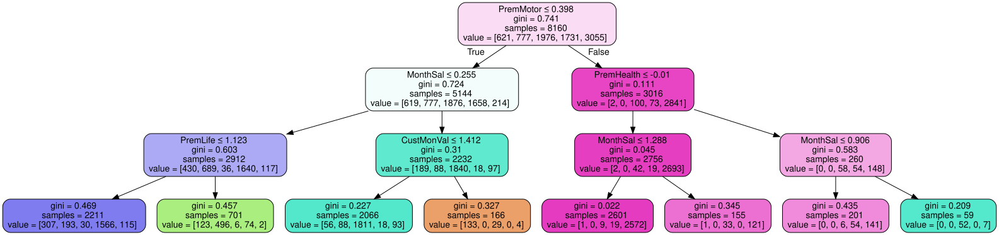

In [185]:
# Visualizing the decision tree
dot_data = export_graphviz(dt, out_file=None, 
                           feature_names=X.columns.to_list(),
                           filled=True,
                           rounded=True,
                           special_characters=True)  
graphviz.Source(dot_data)

In [186]:
cluster_0 = df_kprototype[df_kprototype["labels"]==0]
cluster_1 = df_kprototype[df_kprototype["labels"]==1]
cluster_2 = df_kprototype[df_kprototype["labels"]==2]
cluster_3 = df_kprototype[df_kprototype["labels"]==3]
cluster_4 = df_kprototype[df_kprototype["labels"]==4]

array([[<AxesSubplot:title={'center':'member_age'}>,
        <AxesSubplot:title={'center':'MonthSal'}>,
        <AxesSubplot:title={'center':'CustMonVal'}>],
       [<AxesSubplot:title={'center':'PremMotor'}>,
        <AxesSubplot:title={'center':'PremHousehold'}>,
        <AxesSubplot:title={'center':'PremHealth'}>],
       [<AxesSubplot:title={'center':'PremLife'}>,
        <AxesSubplot:title={'center':'PremWork'}>, <AxesSubplot:>]],
      dtype=object)

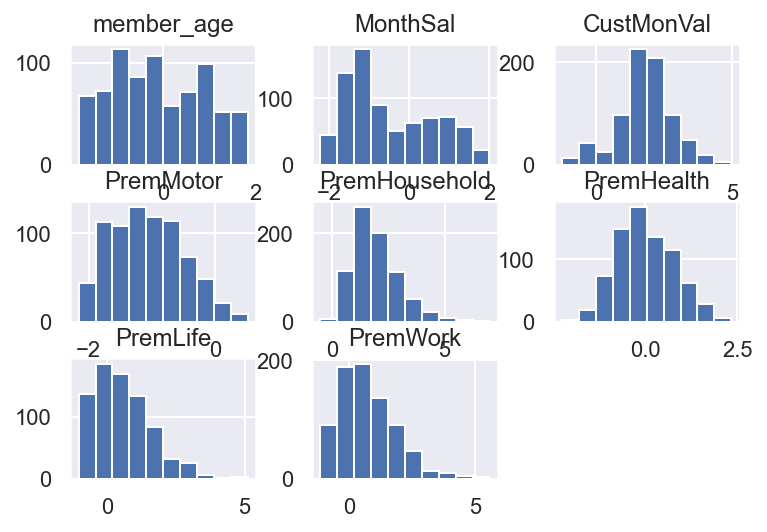

In [187]:
cluster_0.drop(["labels"], axis = 1).hist()

array([[<AxesSubplot:title={'center':'member_age'}>,
        <AxesSubplot:title={'center':'MonthSal'}>,
        <AxesSubplot:title={'center':'CustMonVal'}>],
       [<AxesSubplot:title={'center':'PremMotor'}>,
        <AxesSubplot:title={'center':'PremHousehold'}>,
        <AxesSubplot:title={'center':'PremHealth'}>],
       [<AxesSubplot:title={'center':'PremLife'}>,
        <AxesSubplot:title={'center':'PremWork'}>, <AxesSubplot:>]],
      dtype=object)

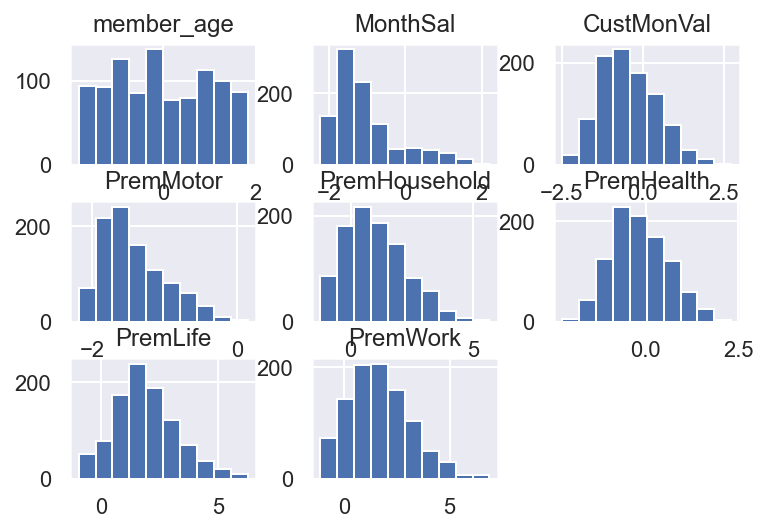

In [188]:
cluster_1.drop(["labels"], axis = 1).hist()

array([[<AxesSubplot:title={'center':'member_age'}>,
        <AxesSubplot:title={'center':'MonthSal'}>,
        <AxesSubplot:title={'center':'CustMonVal'}>],
       [<AxesSubplot:title={'center':'PremMotor'}>,
        <AxesSubplot:title={'center':'PremHousehold'}>,
        <AxesSubplot:title={'center':'PremHealth'}>],
       [<AxesSubplot:title={'center':'PremLife'}>,
        <AxesSubplot:title={'center':'PremWork'}>, <AxesSubplot:>]],
      dtype=object)

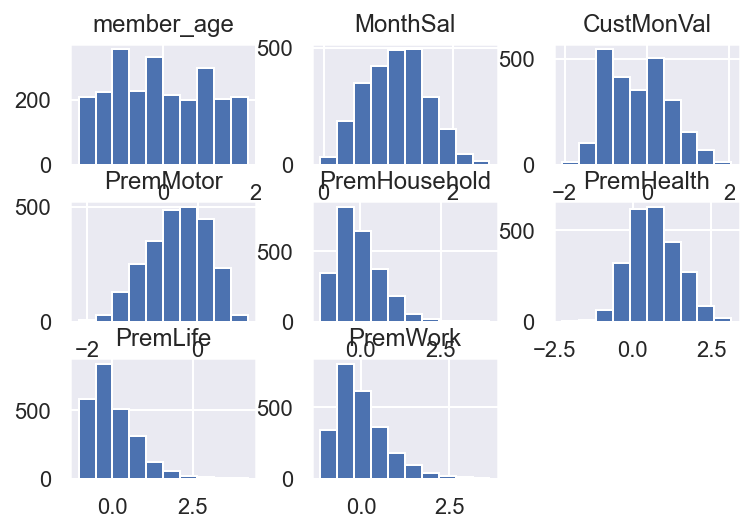

In [189]:
cluster_2.drop(["labels"], axis = 1).hist()

array([[<AxesSubplot:title={'center':'member_age'}>,
        <AxesSubplot:title={'center':'MonthSal'}>,
        <AxesSubplot:title={'center':'CustMonVal'}>],
       [<AxesSubplot:title={'center':'PremMotor'}>,
        <AxesSubplot:title={'center':'PremHousehold'}>,
        <AxesSubplot:title={'center':'PremHealth'}>],
       [<AxesSubplot:title={'center':'PremLife'}>,
        <AxesSubplot:title={'center':'PremWork'}>, <AxesSubplot:>]],
      dtype=object)

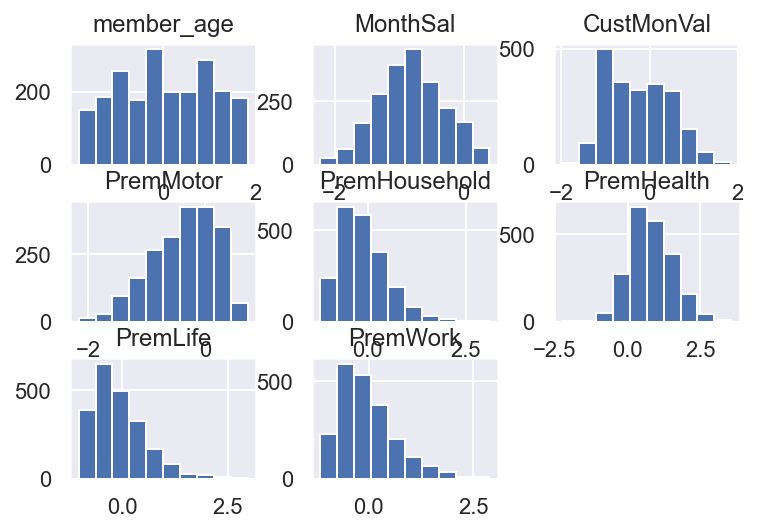

In [190]:
cluster_3.drop(["labels"], axis = 1).hist()

array([[<AxesSubplot:title={'center':'member_age'}>,
        <AxesSubplot:title={'center':'MonthSal'}>,
        <AxesSubplot:title={'center':'CustMonVal'}>],
       [<AxesSubplot:title={'center':'PremMotor'}>,
        <AxesSubplot:title={'center':'PremHousehold'}>,
        <AxesSubplot:title={'center':'PremHealth'}>],
       [<AxesSubplot:title={'center':'PremLife'}>,
        <AxesSubplot:title={'center':'PremWork'}>, <AxesSubplot:>]],
      dtype=object)

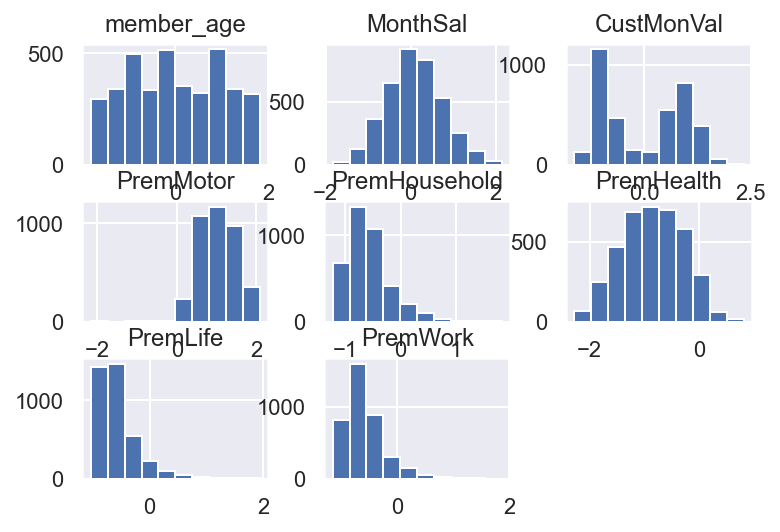

In [191]:
cluster_4.drop(["labels"], axis = 1).hist()

In [192]:
# Converting back categorical values into original form
df_kprototype['GeoLivArea']=df_kprototype['GeoLivArea'].replace(['a','b','c','d'],[1,2,3,4])
df_kprototype['Children']=df_kprototype['Children'].replace(['a','b'],[0,1])

Text(0.5, 1.0, 'EducDeg')

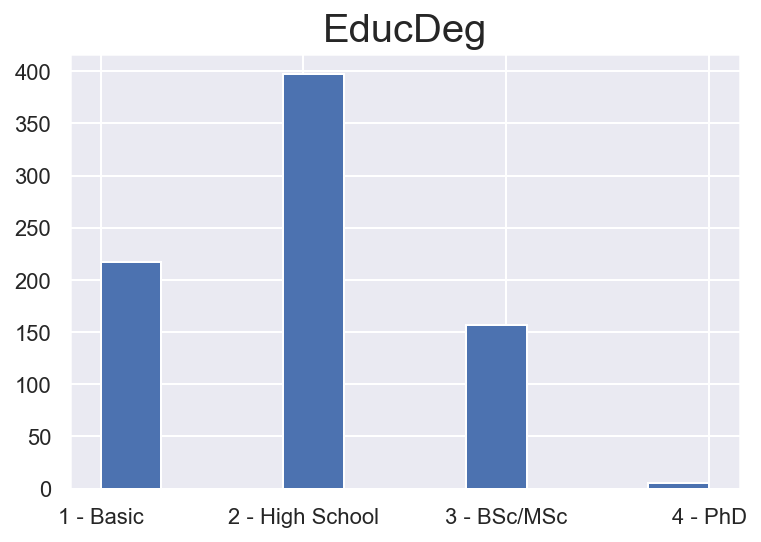

In [193]:
# Cluster 0 categorical plots
cluster_0 = df_kprototype[df_kprototype["labels"]==0]
g =cluster_0["EducDeg"].hist()
g.set_title("EducDeg", size = 20)

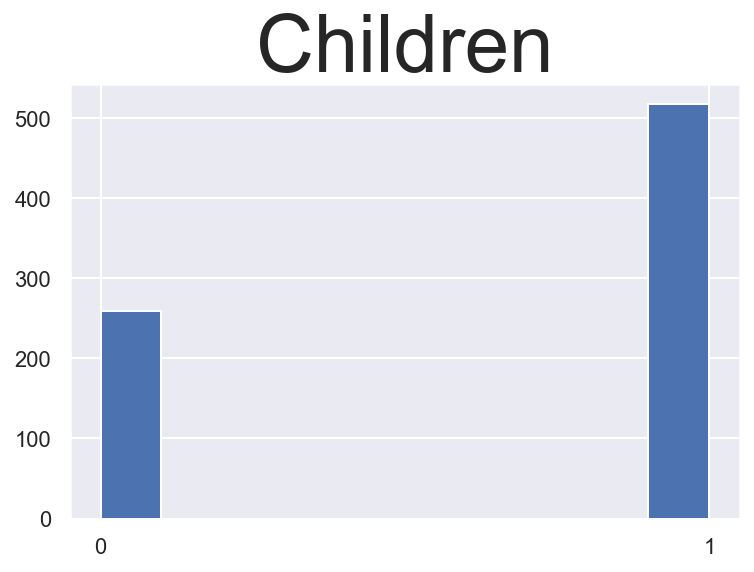

In [194]:
g= cluster_0["Children"].hist()
g.set_title("Children", size = 40)
g.set_xticks(range(0, 2))

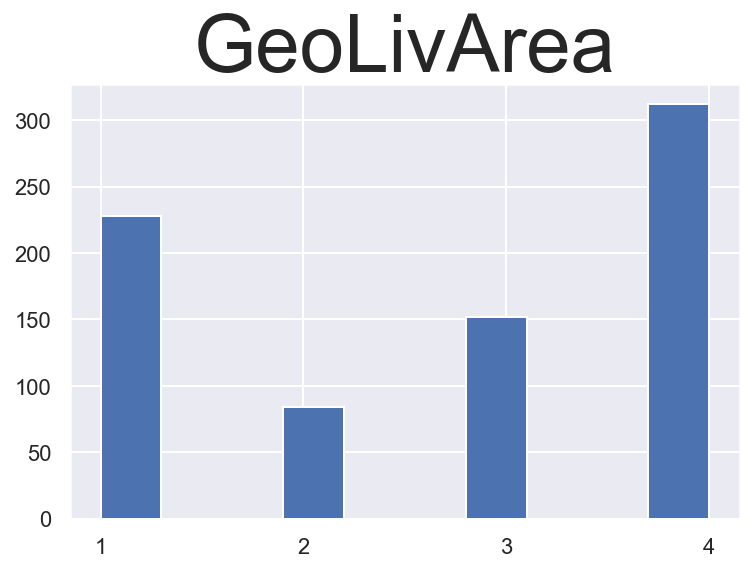

In [195]:
g= cluster_0['GeoLivArea'].hist()
g.set_title('GeoLivArea', size = 40)
g.set_xticks(range(1, 5))

Text(0.5, 1.0, 'EducDeg')

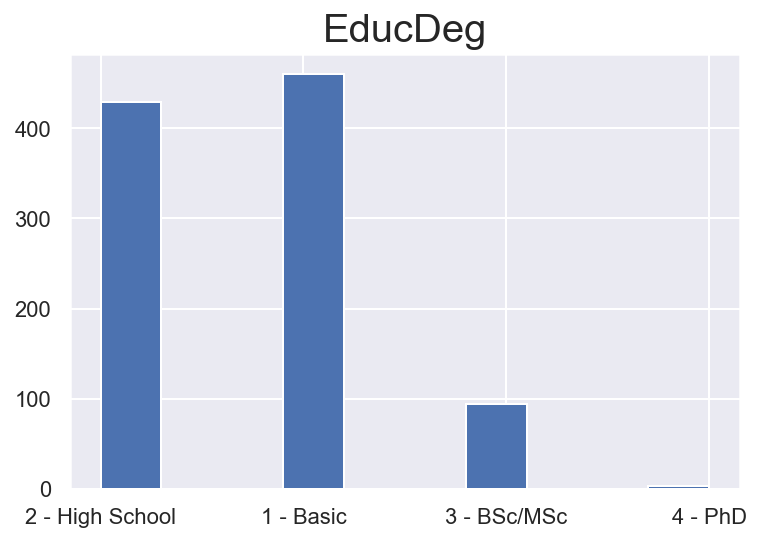

In [196]:
# Cluster 1 categorical plots
cluster_1 = df_kprototype[df_kprototype["labels"]==1]
g =cluster_1["EducDeg"].hist()
g.set_title("EducDeg", size = 20)

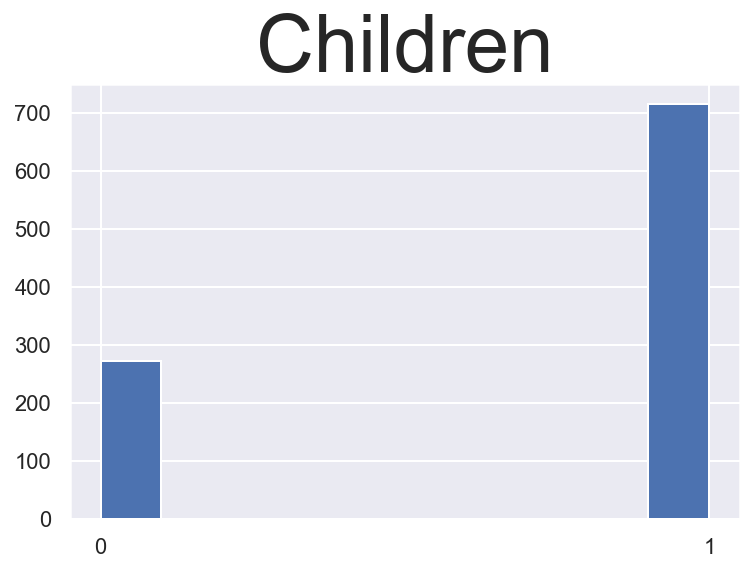

In [197]:
g= cluster_1["Children"].hist()
g.set_title("Children", size = 40)
g.set_xticks(range(0, 2))

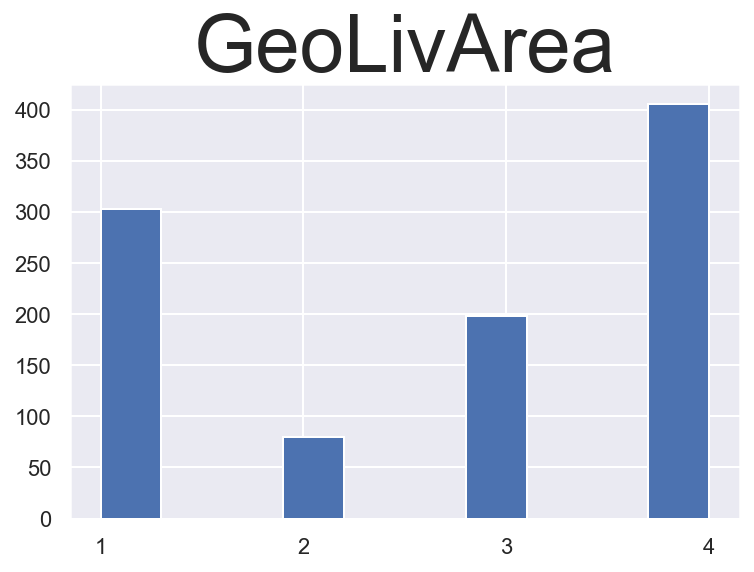

In [198]:
g= cluster_1['GeoLivArea'].hist()
g.set_title('GeoLivArea', size = 40)
g.set_xticks(range(1, 5))

Text(0.5, 1.0, 'EducDeg')

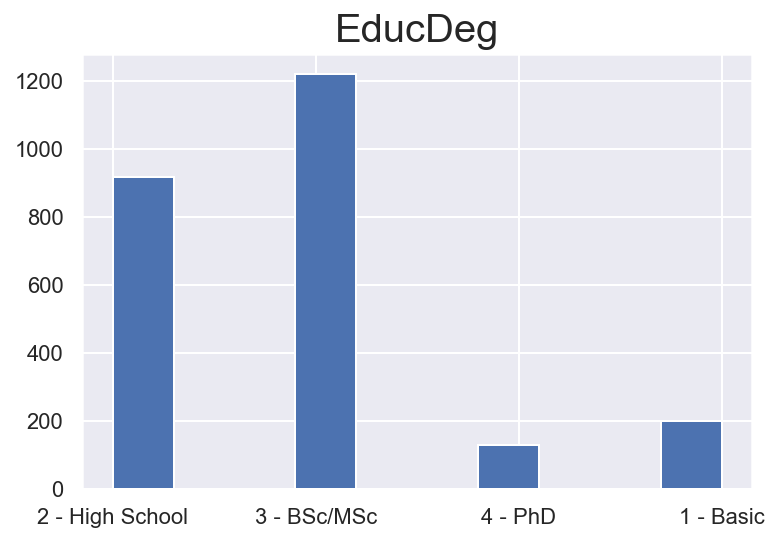

In [199]:
# Cluster 2 categorical plots
cluster_2 = df_kprototype[df_kprototype["labels"]==2]
g =cluster_2["EducDeg"].hist()
g.set_title("EducDeg", size = 20)

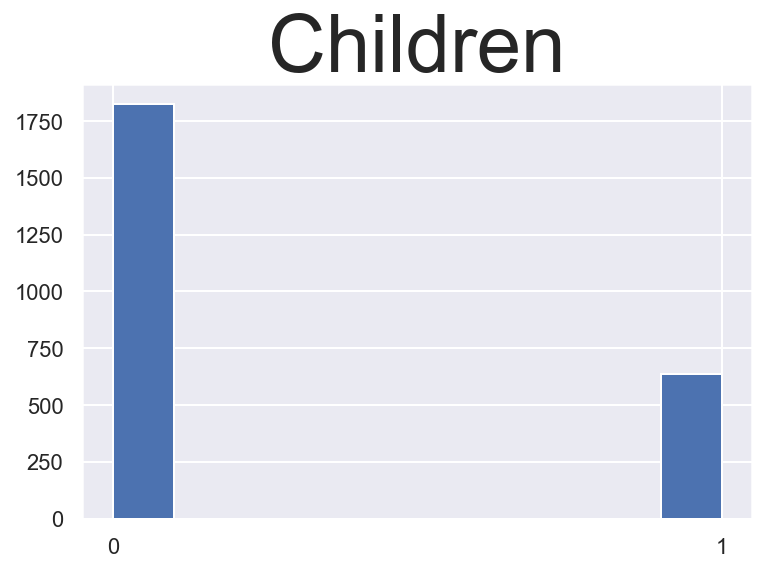

In [200]:
g = cluster_2["Children"].hist()
g.set_title("Children", size = 40)
g.set_xticks(range(0, 2))

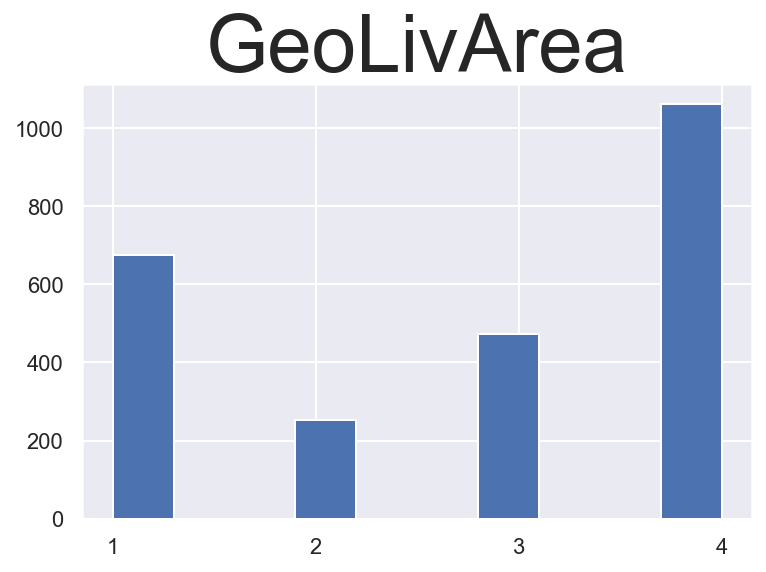

In [201]:
g= cluster_2['GeoLivArea'].hist()
g.set_title('GeoLivArea', size = 40)
g.set_xticks(range(1, 5))

Text(0.5, 1.0, 'EducDeg')

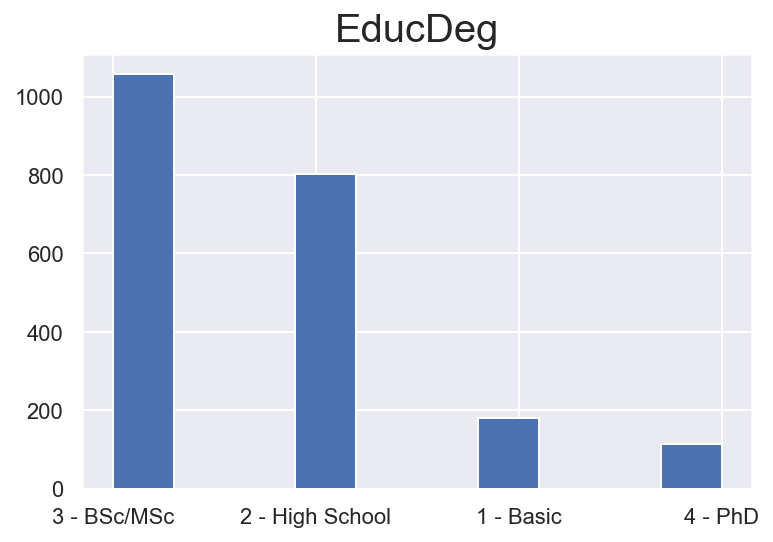

In [202]:
# Cluster 3 categorical plots
cluster_3 = df_kprototype[df_kprototype["labels"]==3]
g =cluster_3["EducDeg"].hist()
g.set_title("EducDeg", size = 20)

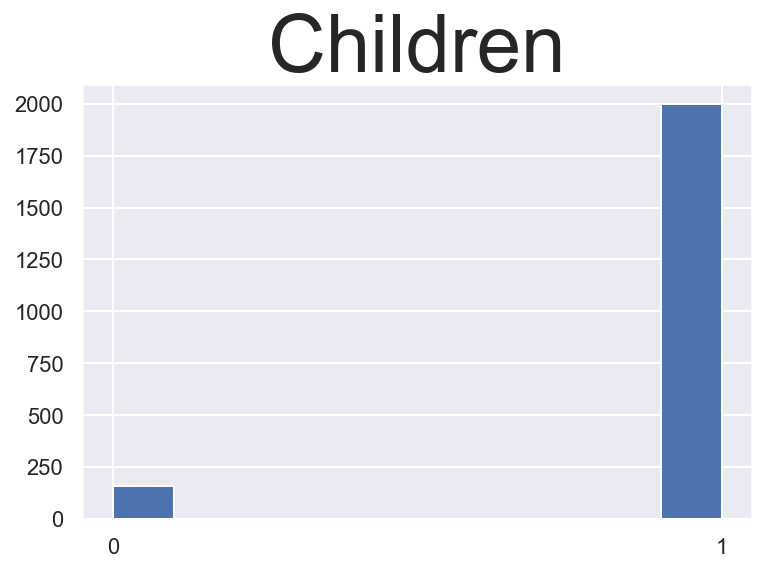

In [203]:
g= cluster_3["Children"].hist()
g.set_title("Children", size = 40)
g.set_xticks(range(0, 2))

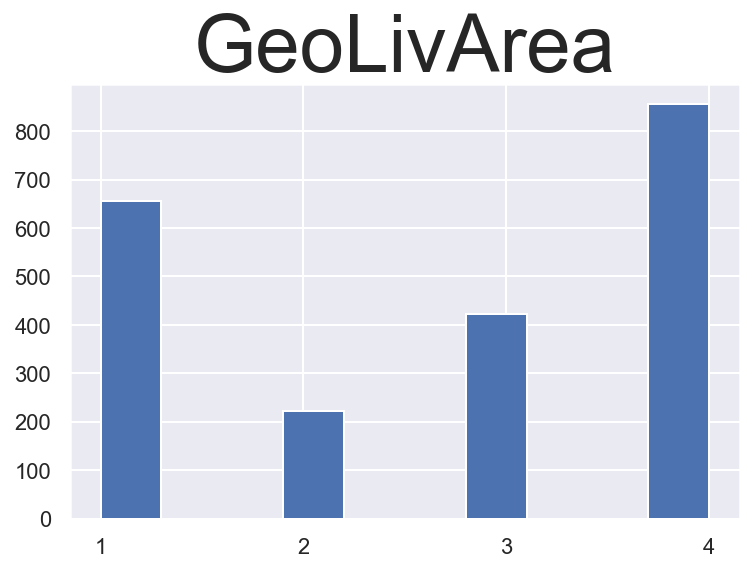

In [204]:
g= cluster_3['GeoLivArea'].hist()
g.set_title('GeoLivArea', size = 40)
g.set_xticks(range(1, 5))

Text(0.5, 1.0, 'EducDeg')

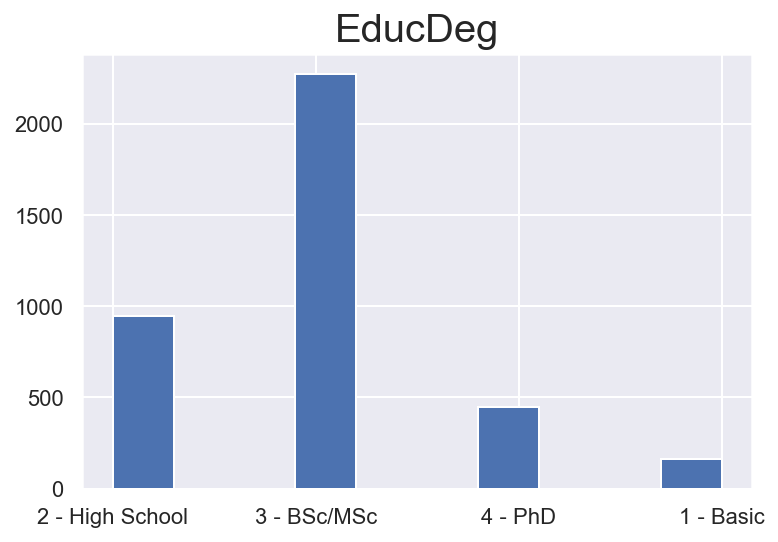

In [205]:
# Cluster 4 categorical plots
cluster_4 = df_kprototype[df_kprototype["labels"]==4]
g =cluster_4["EducDeg"].hist()
g.set_title("EducDeg", size = 20)

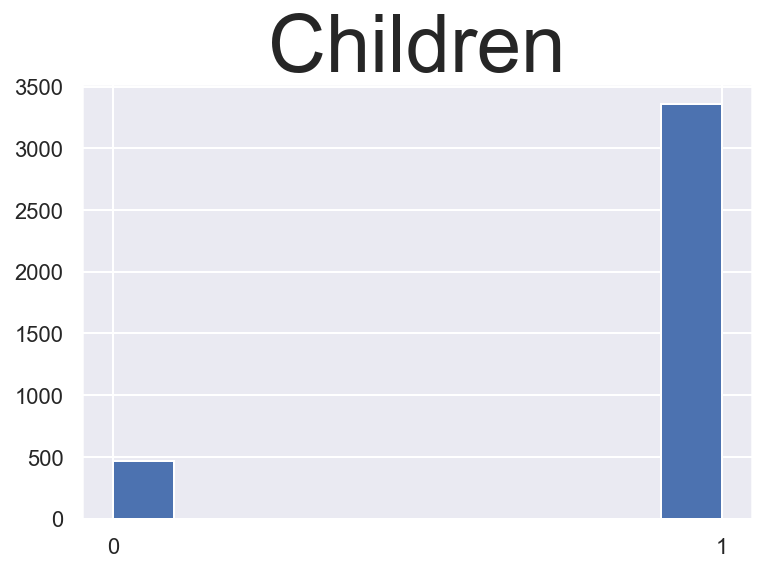

In [206]:
g= cluster_4["Children"].hist()
g.set_title("Children", size = 40)
g.set_xticks(range(0, 2))

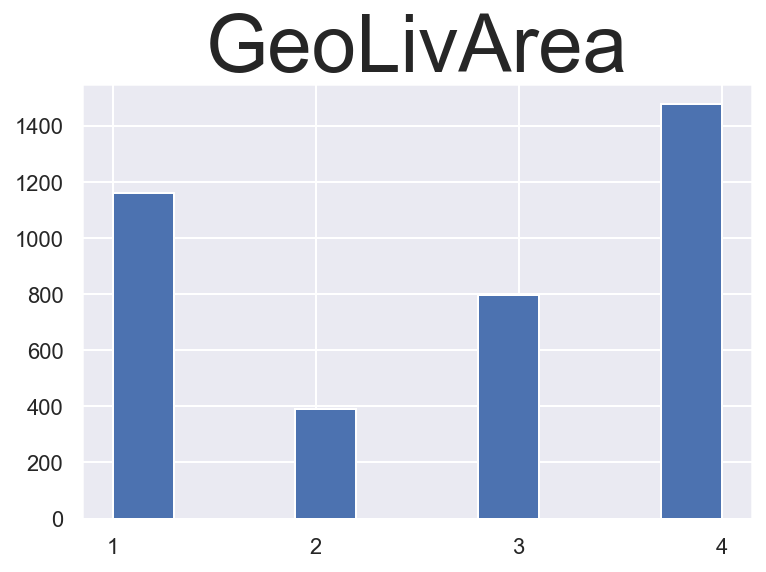

In [207]:
g= cluster_4['GeoLivArea'].hist()
g.set_title('GeoLivArea', size = 40)
g.set_xticks(range(1, 5))